# Face Generation
In this project, you'll use generative adversarial networks to generate new images of faces.
### Get the Data
You'll be using two datasets in this project:
- MNIST
- CelebA

Since the celebA dataset is complex and you're doing GANs in a project for the first time, we want you to test your neural network on MNIST before CelebA.  Running the GANs on MNIST will allow you to see how well your model trains sooner.

If you're using [FloydHub](https://www.floydhub.com/), set `data_dir` to "/input" and use the [FloydHub data ID](http://docs.floydhub.com/home/using_datasets/) "R5KrjnANiKVhLWAkpXhNBe".

In [1]:
data_dir = './data'

# FloydHub - Use with data ID "R5KrjnANiKVhLWAkpXhNBe"
#data_dir = '/input'


"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
import os
import helper

if not os.path.exists(os.path.join(data_dir, 'mnist')):
    helper.download_extract('mnist', data_dir)
if not os.path.exists(os.path.join(data_dir, 'celeba')):
    helper.download_extract('celeba', data_dir)

Found celeba Data


## Explore the Data
### MNIST
As you're aware, the [MNIST](http://yann.lecun.com/exdb/mnist/) dataset contains images of handwritten digits. You can view the first number of examples by changing `show_n_images`. 

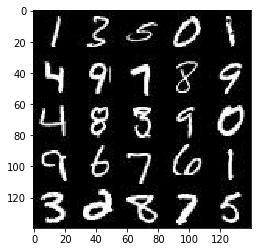

In [2]:
show_n_images = 25

"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
%matplotlib inline
import os
from glob import glob
from matplotlib import pyplot

mnist_images = helper.get_batch(glob(os.path.join(data_dir, 'mnist/*.jpg'))[:show_n_images], 28, 28, 'L')
pyplot.imshow(helper.images_square_grid(mnist_images, 'L'), cmap='gray')

### CelebA
The [CelebFaces Attributes Dataset (CelebA)](http://mmlab.ie.cuhk.edu.hk/projects/CelebA.html) dataset contains over 200,000 celebrity images with annotations.  Since you're going to be generating faces, you won't need the annotations.  You can view the first number of examples by changing `show_n_images`.

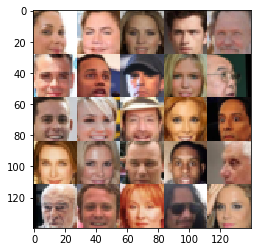

In [3]:
show_n_images = 25

"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
mnist_images = helper.get_batch(glob(os.path.join(data_dir, 'img_align_celeba/*.jpg'))[:show_n_images], 28, 28, 'RGB')
pyplot.imshow(helper.images_square_grid(mnist_images, 'RGB'))

## Preprocess the Data
Since the project's main focus is on building the GANs, we'll preprocess the data for you.  The values of the MNIST and CelebA dataset will be in the range of -0.5 to 0.5 of 28x28 dimensional images.  The CelebA images will be cropped to remove parts of the image that don't include a face, then resized down to 28x28.

The MNIST images are black and white images with a single [color channel](https://en.wikipedia.org/wiki/Channel_(digital_image%29) while the CelebA images have [3 color channels (RGB color channel)](https://en.wikipedia.org/wiki/Channel_(digital_image%29#RGB_Images).
## Build the Neural Network
You'll build the components necessary to build a GANs by implementing the following functions below:
- `model_inputs`
- `discriminator`
- `generator`
- `model_loss`
- `model_opt`
- `train`

### Check the Version of TensorFlow and Access to GPU
This will check to make sure you have the correct version of TensorFlow and access to a GPU

In [4]:
"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
from distutils.version import LooseVersion
import warnings
import tensorflow as tf

# Check TensorFlow Version
assert LooseVersion(tf.__version__) >= LooseVersion('1.0'), 'Please use TensorFlow version 1.0 or newer.  You are using {}'.format(tf.__version__)
print('TensorFlow Version: {}'.format(tf.__version__))

# Check for a GPU
if not tf.test.gpu_device_name():
    warnings.warn('No GPU found. Please use a GPU to train your neural network.')
else:
    print('Default GPU Device: {}'.format(tf.test.gpu_device_name()))

TensorFlow Version: 1.1.0
Default GPU Device: /gpu:0


### Input
Implement the `model_inputs` function to create TF Placeholders for the Neural Network. It should create the following placeholders:
- Real input images placeholder with rank 4 using `image_width`, `image_height`, and `image_channels`.
- Z input placeholder with rank 2 using `z_dim`.
- Learning rate placeholder with rank 0.

Return the placeholders in the following the tuple (tensor of real input images, tensor of z data)

In [5]:
import problem_unittests as tests

def model_inputs(image_width, image_height, image_channels, z_dim):
    """
    Create the model inputs
    :param image_width: The input image width
    :param image_height: The input image height
    :param image_channels: The number of image channels
    :param z_dim: The dimension of Z
    :return: Tuple of (tensor of real input images, tensor of z data, learning rate)
    """
    inputs_real = tf.placeholder(
        tf.float32,
        [ None, image_width, image_height, image_channels ],
        name='input_real'
    )
    inputs_z = tf.placeholder(tf.float32, [ None, z_dim ], name='input_z')
    lr = tf.placeholder(tf.float32, name='learning_rate')

    return inputs_real, inputs_z, lr


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_inputs(model_inputs)

Tests Passed


### Discriminator
Implement `discriminator` to create a discriminator neural network that discriminates on `images`.  This function should be able to reuse the variables in the neural network.  Use [`tf.variable_scope`](https://www.tensorflow.org/api_docs/python/tf/variable_scope) with a scope name of "discriminator" to allow the variables to be reused.  The function should return a tuple of (tensor output of the discriminator, tensor logits of the discriminator).

In [64]:
def discriminator(images, reuse=False):
    """
    Create the discriminator network
    :param images: Tensor of input image(s)
    :param reuse: Boolean if the weights should be reused
    :return: Tuple of (tensor output of the discriminator, tensor logits of the discriminator)
    """
    with tf.variable_scope('discriminator', reuse=reuse):
        alpha = 0.2
        # Hidden layer
        x1 = tf.layers.conv2d(images, 64, 5, strides=2, padding='same')
        relu1 = tf.maximum(alpha * x1, x1)
        # 28x28x64
        
        x2 = tf.layers.conv2d(relu1, 128, 5, strides=2, padding='same')
        bn2 = tf.layers.batch_normalization(x2, training=True)
        relu2 = tf.maximum(alpha * bn2, bn2)
        # 14x14x128
        
        x3 = tf.layers.conv2d(relu2, 256, 5, strides=2, padding='same')
        bn3 = tf.layers.batch_normalization(x3, training=True)
        relu3 = tf.maximum(alpha * bn3, bn3)
        # 7x7x256

        # Flatten it
        n_units=7 * 7 * 256
        flat = tf.reshape(relu3, [-1, n_units])
        logits = tf.layers.dense(flat, 1)
        out = tf.sigmoid(logits)

        return out, logits

"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_discriminator(discriminator, tf)

Tests Passed


### Generator
Implement `generator` to generate an image using `z`. This function should be able to reuse the variables in the neural network.  Use [`tf.variable_scope`](https://www.tensorflow.org/api_docs/python/tf/variable_scope) with a scope name of "generator" to allow the variables to be reused. The function should return the generated 28 x 28 x `out_channel_dim` images.

In [73]:
def generator(z, out_channel_dim, is_train=True):
    """
    Create the generator network
    :param z: Input z
    :param out_channel_dim: The number of channels in the output image
    :param is_train: Boolean if generator is being used for training
    :return: The tensor output of the generator
    """
    alpha = 0.2
    with tf.variable_scope('generator', reuse=not is_train):
        # First fully connected layer
        x1 = tf.layers.dense(z, 7 * 7 * 512)
        # Reshape it to start the convolutional stack
        x1 = tf.reshape(x1, (-1, 7, 7, 512))
        x1 = tf.layers.batch_normalization(x1, training=is_train)
        x1 = tf.maximum(alpha * x1, x1)
        # 7x7x512 now
        
        x2 = tf.layers.conv2d_transpose(x1, 256, 5, strides=2, padding='same')
        x2 = tf.layers.batch_normalization(x2, training=is_train)
        x2 = tf.maximum(alpha * x2, x2)
        # 14x14x256 now
        
        # Output layer
        logits = tf.layers.conv2d_transpose(x2, out_channel_dim, 5, strides=2, padding='same')
        # 28x28x3 now
        out = tf.tanh(logits)

        return out


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_generator(generator, tf)

Tests Passed


### Loss
Implement `model_loss` to build the GANs for training and calculate the loss.  The function should return a tuple of (discriminator loss, generator loss).  Use the following functions you implemented:
- `discriminator(images, reuse=False)`
- `generator(z, out_channel_dim, is_train=True)`

In [8]:
def model_loss(input_real, input_z, out_channel_dim):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, out_channel_dim, is_train=True)
    d_model_real, d_logits_real = discriminator(input_real, reuse=False)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True)
    
    smooth = 0.1
    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(
            logits=d_logits_real, labels=tf.ones_like(d_model_real) * (1.0 - smooth)
        )
    )
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake))
    )
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake))
    )

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_loss(model_loss)

Tests Passed


### Optimization
Implement `model_opt` to create the optimization operations for the GANs. Use [`tf.trainable_variables`](https://www.tensorflow.org/api_docs/python/tf/trainable_variables) to get all the trainable variables.  Filter the variables with names that are in the discriminator and generator scope names.  The function should return a tuple of (discriminator training operation, generator training operation).

In [32]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [ var for var in t_vars if var.name.startswith('discriminator') ]
    g_vars = [ var for var in t_vars if var.name.startswith('generator') ]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_opt(model_opt, tf)

Tests Passed


## Neural Network Training
### Show Output
Use this function to show the current output of the generator during training. It will help you determine how well the GANs is training.

In [10]:
"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
import numpy as np

def show_generator_output(sess, n_images, input_z, out_channel_dim, image_mode):
    """
    Show example output for the generator
    :param sess: TensorFlow session
    :param n_images: Number of Images to display
    :param input_z: Input Z Tensor
    :param out_channel_dim: The number of channels in the output image
    :param image_mode: The mode to use for images ("RGB" or "L")
    """
    cmap = None if image_mode == 'RGB' else 'gray'
    z_dim = input_z.get_shape().as_list()[-1]
    example_z = np.random.uniform(-1, 1, size=[n_images, z_dim])

    samples = sess.run(
        generator(input_z, out_channel_dim, False),
        feed_dict={input_z: example_z})

    images_grid = helper.images_square_grid(samples, image_mode)
    pyplot.imshow(images_grid, cmap=cmap)
    pyplot.show()

### Train
Implement `train` to build and train the GANs.  Use the following functions you implemented:
- `model_inputs(image_width, image_height, image_channels, z_dim)`
- `model_loss(input_real, input_z, out_channel_dim)`
- `model_opt(d_loss, g_loss, learning_rate, beta1)`

Use the `show_generator_output` to show `generator` output while you train. Running `show_generator_output` for every batch will drastically increase training time and increase the size of the notebook.  It's recommended to print the `generator` output every 100 batches.

In [76]:
def train(epoch_count, batch_size, z_dim, learning_rate, beta1, get_batches, data_shape, data_image_mode):
    """
    Train the GAN
    :param epoch_count: Number of epochs
    :param batch_size: Batch Size
    :param z_dim: Z dimension
    :param learning_rate: Learning Rate
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :param get_batches: Function to get batches
    :param data_shape: Shape of the data
    :param data_image_mode: The image mode to use for images ("RGB" or "L")
    """
    n_images = 25
    data_cnt, image_width, image_height, image_channels = data_shape

    tf.reset_default_graph()
    input_real, input_z, input_rate = \
        model_inputs(image_width, image_height, image_channels, z_dim)
    d_loss, g_loss = model_loss(input_real, input_z, image_channels)
    d_train_opt, g_train_opt = model_opt(d_loss, g_loss, input_rate, beta1)

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for epoch_i in range(epoch_count):
            steps = 0
            for batch_images in get_batches(batch_size):
                steps += 1
                
                # Normalize to be between -1 and 1
                batch_images *= 2.0

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_dim))

                # Run optimizers
                _ = sess.run(d_train_opt, feed_dict={ input_real: batch_images, input_z: batch_z, input_rate: learning_rate })
                _ = sess.run(g_train_opt, feed_dict={ input_real: batch_images, input_z: batch_z, input_rate: learning_rate })

                if steps % 10 == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = d_loss.eval({ input_z: batch_z, input_real: batch_images })
                    train_loss_g = g_loss.eval({ input_z: batch_z })

                    print(
                        'Epoch {}/{} {}...'.format(epoch_i + 1, epoch_count, steps),
                        'Discriminator Loss: {:.4f}...'.format(train_loss_d),
                        'Generator Loss: {:.4f}'.format(train_loss_g)
                    )
                    show_generator_output(sess, n_images, input_z, image_channels, data_image_mode)

            # At the end of each epoch, get the losses and print them out
            train_loss_d = sess.run(d_loss, { input_z: batch_z, input_real: batch_images })
            train_loss_g = g_loss.eval({ input_z: batch_z })

            print(
                'Epoch {}/{}...'.format(epoch_i + 1, epochs),
                'Discriminator Loss: {:.4f}...'.format(train_loss_d),
                'Generator Loss: {:.4f}'.format(train_loss_g)
            )
            show_generator_output(sess, n_images, input_z, image_channels, data_image_mode)
                
                

### MNIST
Test your GANs architecture on MNIST.  After 2 epochs, the GANs should be able to generate images that look like handwritten digits.  Make sure the loss of the generator is lower than the loss of the discriminator or close to 0.

Epoch 1/2 10... Discriminator Loss: 1.1056... Generator Loss: 0.6999


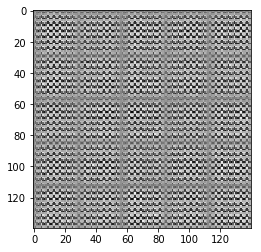

Epoch 1/2 20... Discriminator Loss: 0.8488... Generator Loss: 1.0378


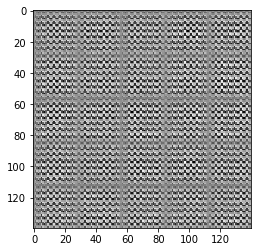

Epoch 1/2 30... Discriminator Loss: 0.9092... Generator Loss: 1.0363


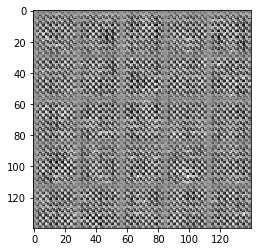

Epoch 1/2 40... Discriminator Loss: 2.5400... Generator Loss: 0.1447


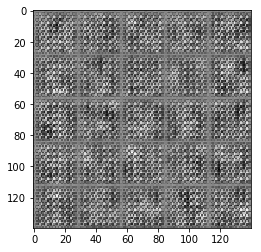

Epoch 1/2 50... Discriminator Loss: 1.1287... Generator Loss: 1.5502


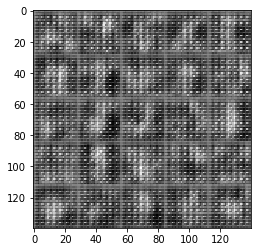

Epoch 1/2 60... Discriminator Loss: 1.5880... Generator Loss: 0.4094


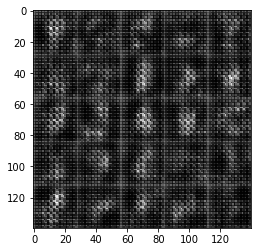

Epoch 1/2 70... Discriminator Loss: 0.4530... Generator Loss: 2.4014


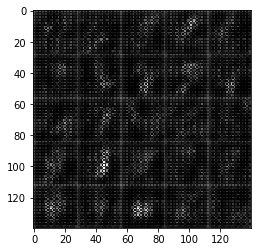

Epoch 1/2 80... Discriminator Loss: 1.9564... Generator Loss: 0.3207


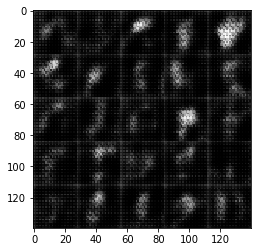

Epoch 1/2 90... Discriminator Loss: 1.7058... Generator Loss: 0.3397


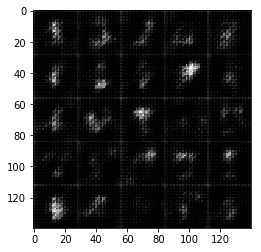

Epoch 1/2 100... Discriminator Loss: 1.4621... Generator Loss: 0.4983


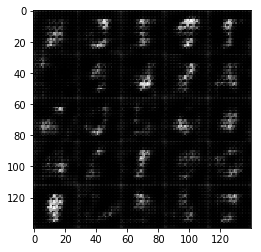

Epoch 1/2 110... Discriminator Loss: 2.4557... Generator Loss: 0.1481


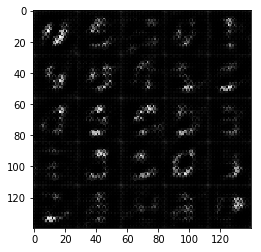

Epoch 1/2 120... Discriminator Loss: 1.2124... Generator Loss: 3.8767


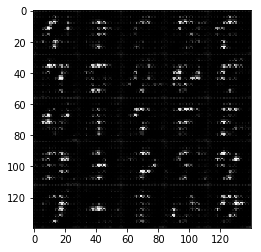

Epoch 1/2 130... Discriminator Loss: 1.2977... Generator Loss: 0.5885


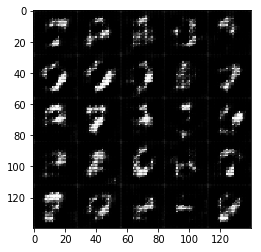

Epoch 1/2 140... Discriminator Loss: 1.6557... Generator Loss: 0.3339


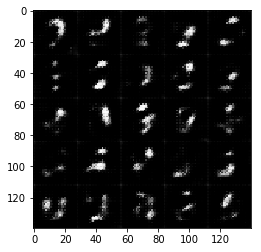

Epoch 1/2 150... Discriminator Loss: 1.1383... Generator Loss: 1.3759


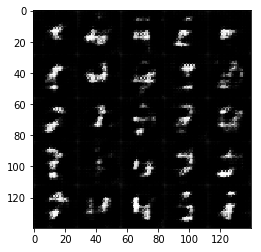

Epoch 1/2 160... Discriminator Loss: 1.4808... Generator Loss: 0.4459


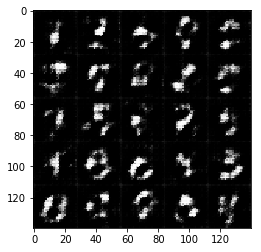

Epoch 1/2 170... Discriminator Loss: 1.1728... Generator Loss: 0.7800


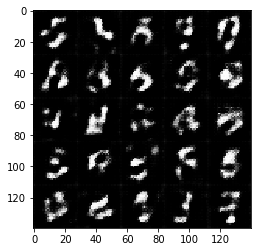

Epoch 1/2 180... Discriminator Loss: 1.0899... Generator Loss: 0.8510


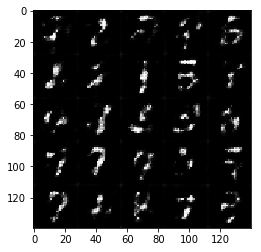

Epoch 1/2 190... Discriminator Loss: 1.1757... Generator Loss: 1.0201


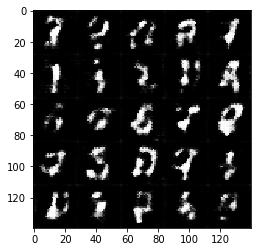

Epoch 1/2 200... Discriminator Loss: 1.3863... Generator Loss: 1.4115


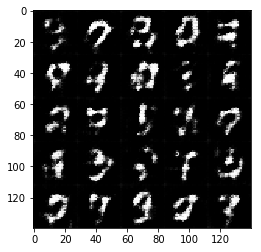

Epoch 1/2 210... Discriminator Loss: 1.4085... Generator Loss: 1.8232


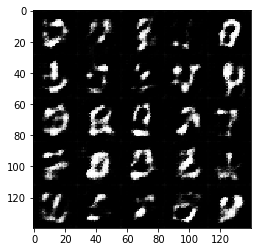

Epoch 1/2 220... Discriminator Loss: 1.1231... Generator Loss: 0.8885


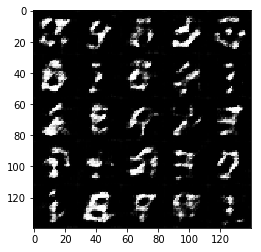

Epoch 1/2 230... Discriminator Loss: 1.3767... Generator Loss: 0.5917


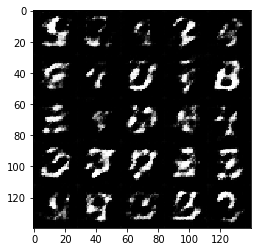

Epoch 1/2 240... Discriminator Loss: 1.3118... Generator Loss: 1.4349


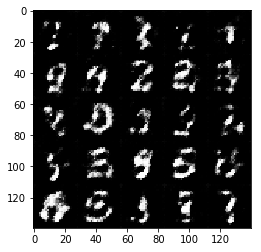

Epoch 1/2 250... Discriminator Loss: 1.7185... Generator Loss: 1.4715


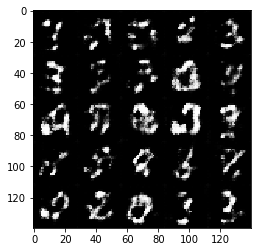

Epoch 1/2 260... Discriminator Loss: 1.2800... Generator Loss: 0.7093


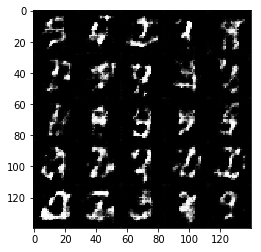

Epoch 1/2 270... Discriminator Loss: 1.4755... Generator Loss: 1.5874


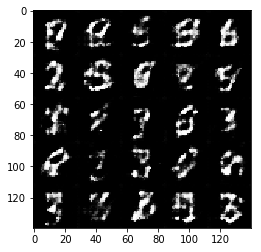

Epoch 1/2 280... Discriminator Loss: 1.2463... Generator Loss: 0.5825


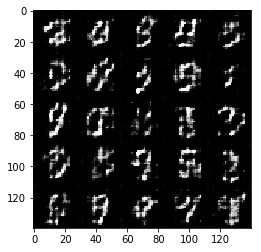

Epoch 1/2 290... Discriminator Loss: 1.2014... Generator Loss: 0.7098


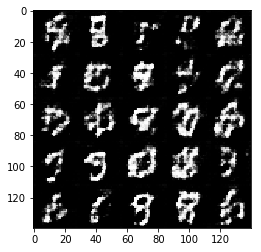

Epoch 1/2 300... Discriminator Loss: 1.2105... Generator Loss: 0.6218


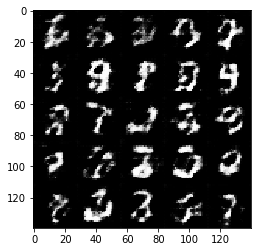

Epoch 1/2 310... Discriminator Loss: 0.9761... Generator Loss: 1.4991


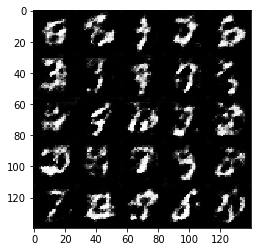

Epoch 1/2 320... Discriminator Loss: 1.0403... Generator Loss: 0.8616


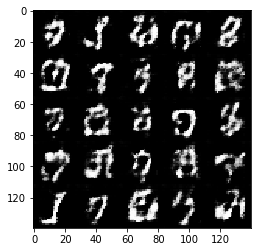

Epoch 1/2 330... Discriminator Loss: 1.1702... Generator Loss: 0.6562


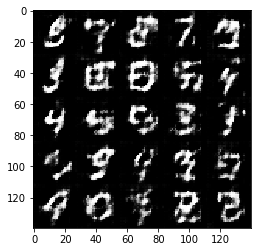

Epoch 1/2 340... Discriminator Loss: 1.1170... Generator Loss: 1.1532


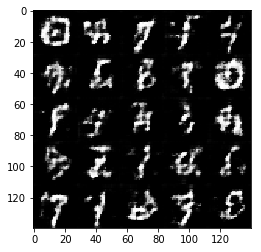

Epoch 1/2 350... Discriminator Loss: 1.0535... Generator Loss: 0.8787


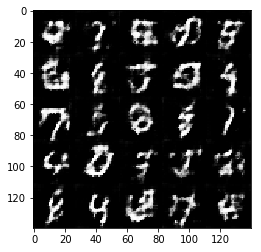

Epoch 1/2 360... Discriminator Loss: 1.0536... Generator Loss: 1.2203


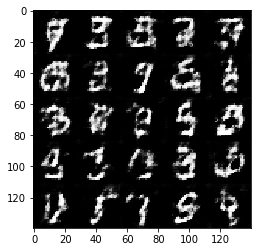

Epoch 1/2 370... Discriminator Loss: 1.2253... Generator Loss: 0.6644


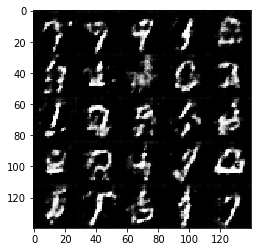

Epoch 1/2 380... Discriminator Loss: 1.2030... Generator Loss: 1.3126


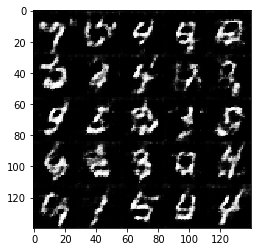

Epoch 1/2 390... Discriminator Loss: 1.2366... Generator Loss: 0.8825


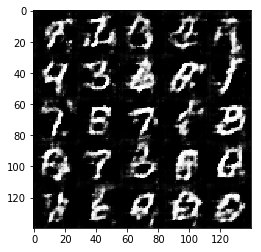

Epoch 1/2 400... Discriminator Loss: 1.2240... Generator Loss: 0.6225


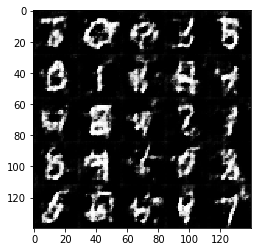

Epoch 1/2 410... Discriminator Loss: 1.2695... Generator Loss: 0.5885


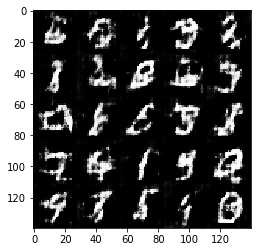

Epoch 1/2 420... Discriminator Loss: 1.1747... Generator Loss: 1.5951


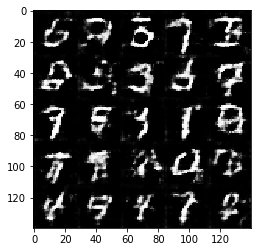

Epoch 1/2 430... Discriminator Loss: 1.5276... Generator Loss: 0.3945


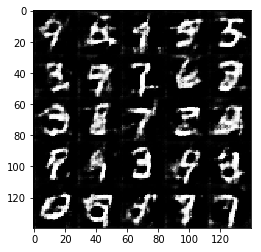

Epoch 1/2 440... Discriminator Loss: 1.5970... Generator Loss: 0.3857


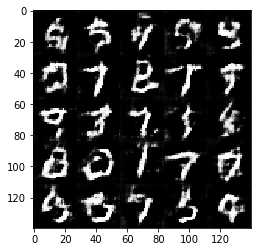

Epoch 1/2 450... Discriminator Loss: 1.3486... Generator Loss: 1.3965


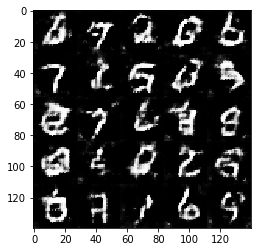

Epoch 1/2 460... Discriminator Loss: 1.0962... Generator Loss: 1.0120


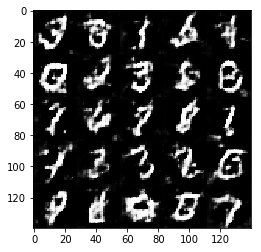

Epoch 1/2 470... Discriminator Loss: 1.1050... Generator Loss: 1.1752


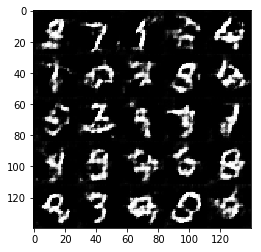

Epoch 1/2 480... Discriminator Loss: 1.1003... Generator Loss: 0.9479


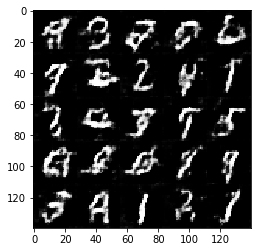

Epoch 1/2 490... Discriminator Loss: 1.3359... Generator Loss: 0.7323


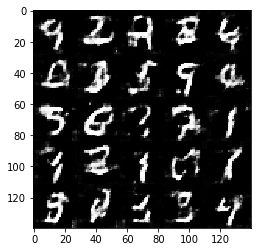

Epoch 1/2 500... Discriminator Loss: 1.2407... Generator Loss: 1.5251


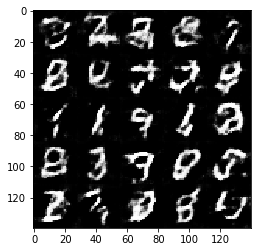

Epoch 1/2 510... Discriminator Loss: 1.3256... Generator Loss: 0.4883


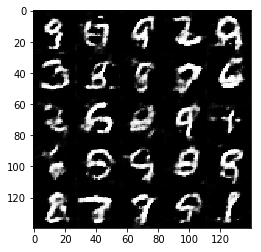

Epoch 1/2 520... Discriminator Loss: 1.3124... Generator Loss: 0.5647


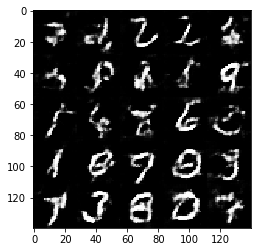

Epoch 1/2 530... Discriminator Loss: 1.0700... Generator Loss: 1.3323


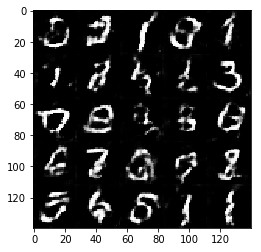

Epoch 1/2 540... Discriminator Loss: 1.0552... Generator Loss: 1.0705


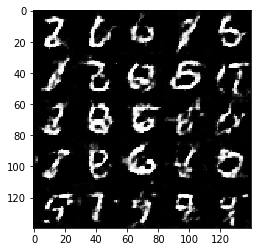

Epoch 1/2 550... Discriminator Loss: 1.3097... Generator Loss: 0.7415


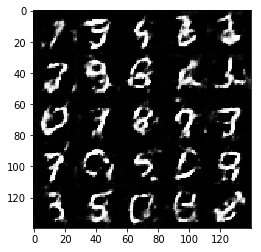

Epoch 1/2 560... Discriminator Loss: 1.0096... Generator Loss: 1.0290


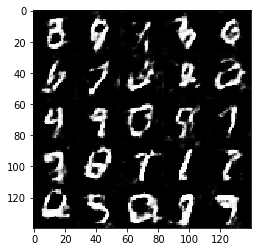

Epoch 1/2 570... Discriminator Loss: 1.0380... Generator Loss: 0.7973


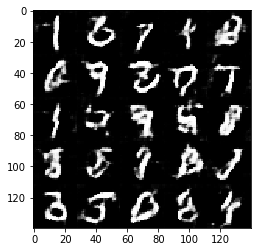

Epoch 1/2 580... Discriminator Loss: 1.8131... Generator Loss: 0.2742


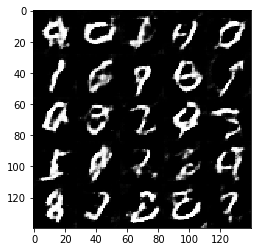

Epoch 1/2 590... Discriminator Loss: 0.9314... Generator Loss: 1.1082


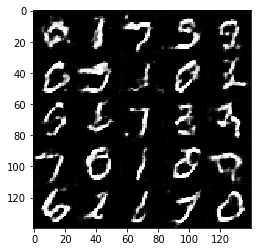

Epoch 1/2 600... Discriminator Loss: 1.1625... Generator Loss: 0.6595


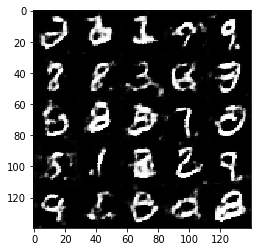

Epoch 1/2 610... Discriminator Loss: 1.4976... Generator Loss: 0.3974


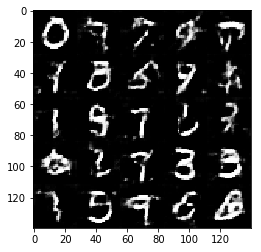

Epoch 1/2 620... Discriminator Loss: 1.1002... Generator Loss: 0.9109


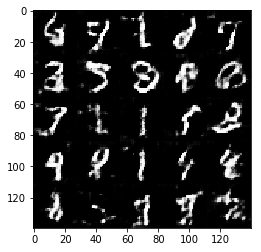

Epoch 1/2 630... Discriminator Loss: 1.1319... Generator Loss: 1.4028


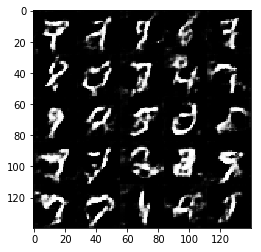

Epoch 1/2 640... Discriminator Loss: 1.3728... Generator Loss: 0.4530


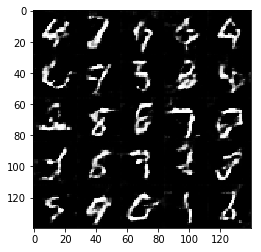

Epoch 1/2 650... Discriminator Loss: 1.3752... Generator Loss: 0.4552


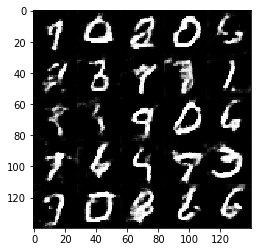

Epoch 1/2 660... Discriminator Loss: 1.0521... Generator Loss: 0.9030


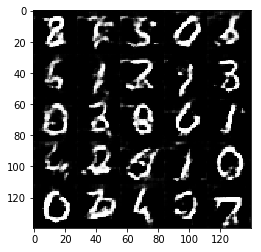

Epoch 1/2 670... Discriminator Loss: 0.9268... Generator Loss: 1.7537


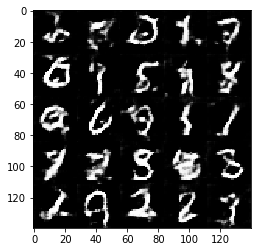

Epoch 1/2 680... Discriminator Loss: 1.2238... Generator Loss: 1.6618


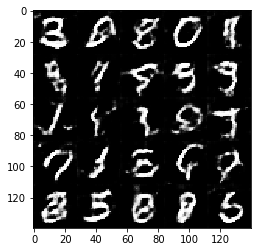

Epoch 1/2 690... Discriminator Loss: 1.1728... Generator Loss: 1.4187


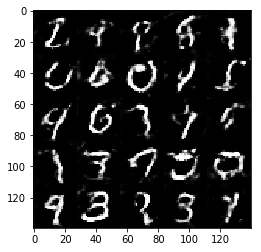

Epoch 1/2 700... Discriminator Loss: 1.2556... Generator Loss: 0.6678


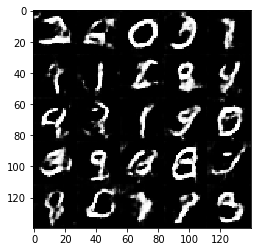

Epoch 1/2 710... Discriminator Loss: 2.0121... Generator Loss: 0.2342


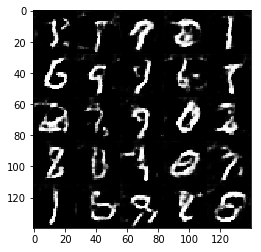

Epoch 1/2 720... Discriminator Loss: 1.0410... Generator Loss: 0.8757


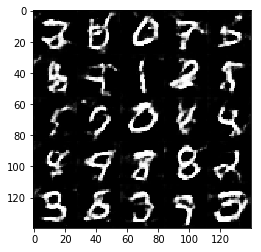

Epoch 1/2 730... Discriminator Loss: 1.3232... Generator Loss: 1.5756


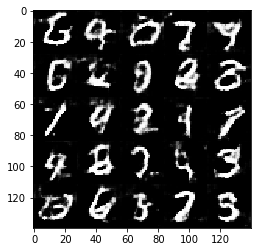

Epoch 1/2 740... Discriminator Loss: 0.9325... Generator Loss: 1.0592


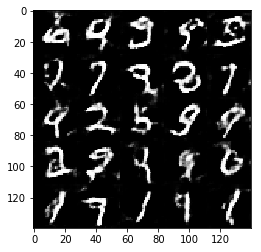

Epoch 1/2 750... Discriminator Loss: 1.0259... Generator Loss: 1.2558


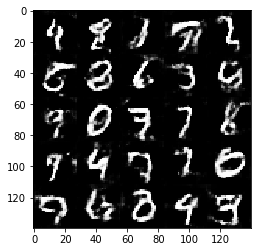

Epoch 1/2 760... Discriminator Loss: 0.8447... Generator Loss: 1.0878


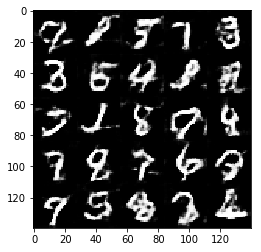

Epoch 1/2 770... Discriminator Loss: 1.3835... Generator Loss: 0.4809


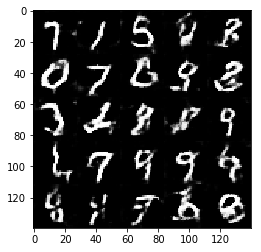

Epoch 1/2 780... Discriminator Loss: 0.9764... Generator Loss: 0.9295


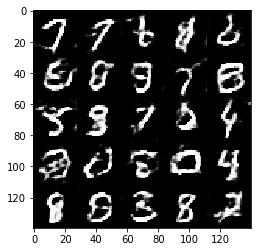

Epoch 1/2 790... Discriminator Loss: 1.0587... Generator Loss: 1.4190


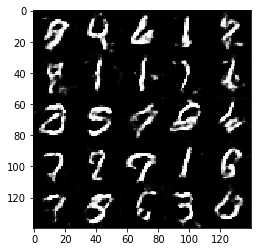

Epoch 1/2 800... Discriminator Loss: 0.9857... Generator Loss: 1.0097


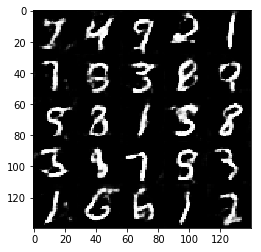

Epoch 1/2 810... Discriminator Loss: 0.9394... Generator Loss: 1.7001


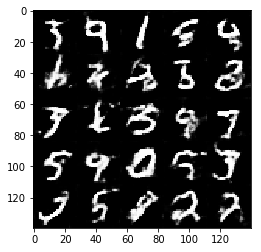

Epoch 1/2 820... Discriminator Loss: 0.9805... Generator Loss: 1.3083


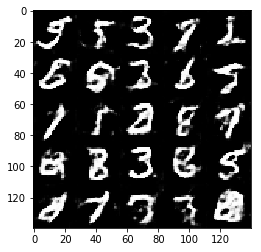

Epoch 1/2 830... Discriminator Loss: 0.9804... Generator Loss: 1.2263


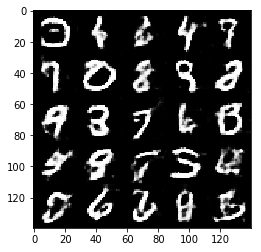

Epoch 1/2 840... Discriminator Loss: 1.0736... Generator Loss: 0.7573


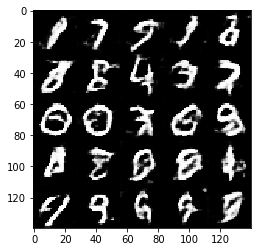

Epoch 1/2 850... Discriminator Loss: 0.9641... Generator Loss: 0.8832


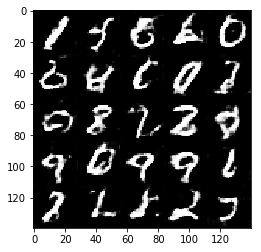

Epoch 1/2 860... Discriminator Loss: 1.1202... Generator Loss: 1.4072


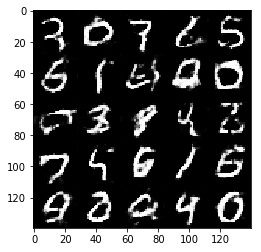

Epoch 1/2 870... Discriminator Loss: 0.8160... Generator Loss: 1.7590


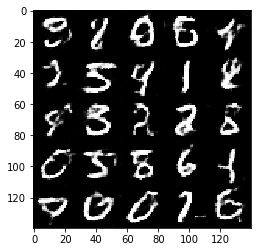

Epoch 1/2 880... Discriminator Loss: 1.2419... Generator Loss: 0.7572


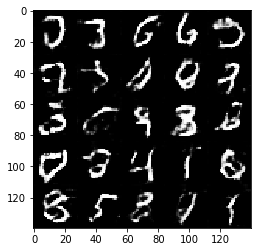

Epoch 1/2 890... Discriminator Loss: 1.8984... Generator Loss: 2.7753


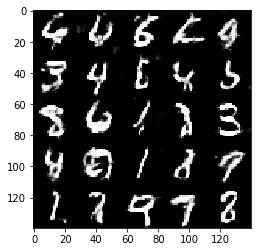

Epoch 1/2 900... Discriminator Loss: 0.9263... Generator Loss: 1.2917


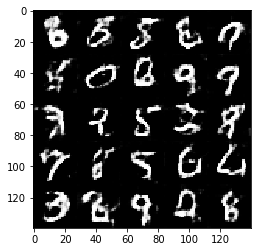

Epoch 1/2 910... Discriminator Loss: 1.0337... Generator Loss: 0.8923


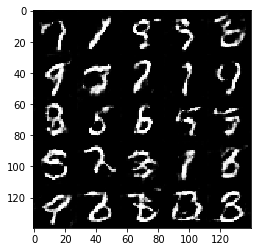

Epoch 1/2 920... Discriminator Loss: 1.1822... Generator Loss: 0.6569


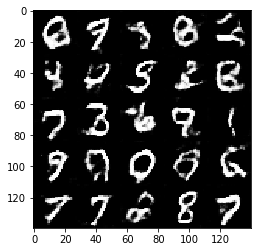

Epoch 1/2 930... Discriminator Loss: 0.9907... Generator Loss: 1.6062


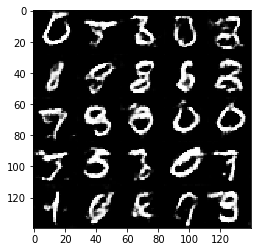

Epoch 1/2 940... Discriminator Loss: 1.5845... Generator Loss: 0.3914


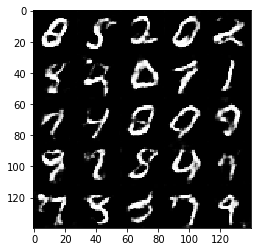

Epoch 1/2 950... Discriminator Loss: 0.8070... Generator Loss: 1.1743


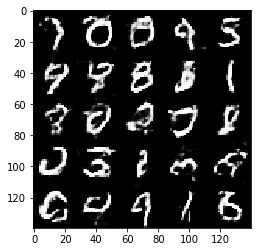

Epoch 1/2 960... Discriminator Loss: 1.6891... Generator Loss: 2.0162


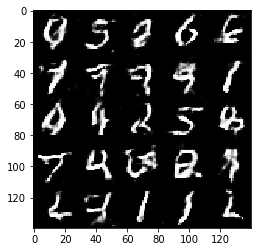

Epoch 1/2 970... Discriminator Loss: 1.2067... Generator Loss: 0.7046


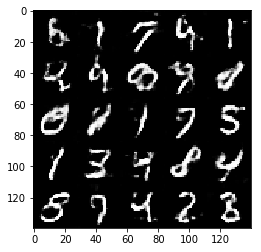

Epoch 1/2 980... Discriminator Loss: 0.8663... Generator Loss: 1.9123


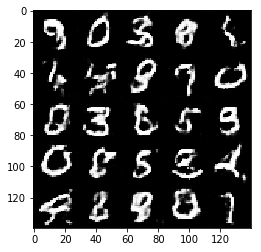

Epoch 1/2 990... Discriminator Loss: 1.2037... Generator Loss: 0.6225


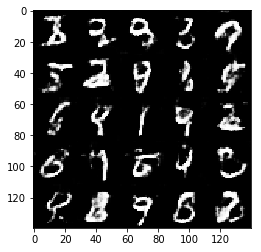

Epoch 1/2 1000... Discriminator Loss: 0.8733... Generator Loss: 1.0494


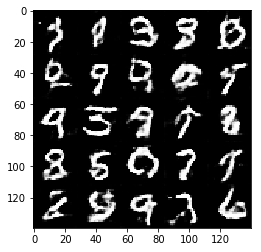

Epoch 1/2 1010... Discriminator Loss: 0.9433... Generator Loss: 0.8792


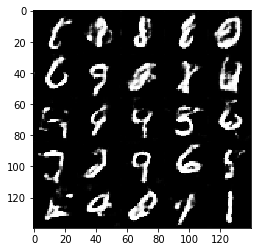

Epoch 1/2 1020... Discriminator Loss: 0.8696... Generator Loss: 1.4478


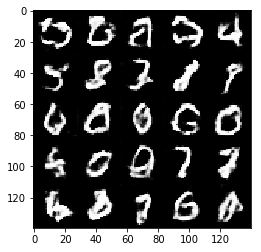

Epoch 1/2 1030... Discriminator Loss: 0.9526... Generator Loss: 0.9797


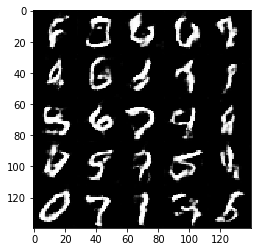

Epoch 1/2 1040... Discriminator Loss: 0.9220... Generator Loss: 1.1018


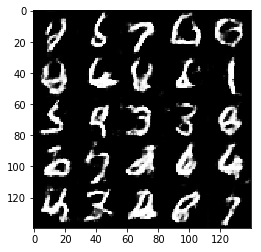

Epoch 1/2 1050... Discriminator Loss: 1.2291... Generator Loss: 0.6250


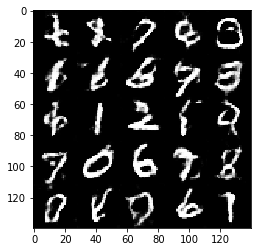

Epoch 1/2 1060... Discriminator Loss: 1.3462... Generator Loss: 0.7056


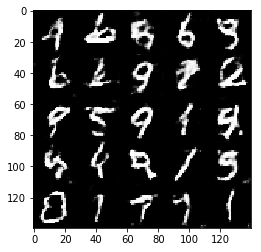

Epoch 1/2 1070... Discriminator Loss: 1.6228... Generator Loss: 0.4145


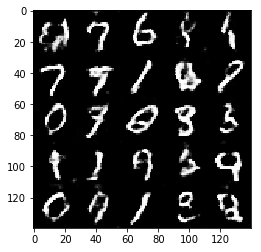

Epoch 1/2 1080... Discriminator Loss: 0.9043... Generator Loss: 1.0801


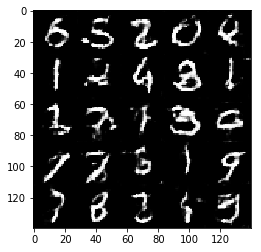

Epoch 1/2 1090... Discriminator Loss: 1.1656... Generator Loss: 0.7260


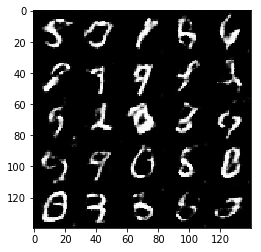

Epoch 1/2 1100... Discriminator Loss: 1.5524... Generator Loss: 0.4994


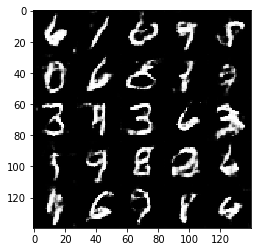

Epoch 1/2 1110... Discriminator Loss: 0.8585... Generator Loss: 1.0597


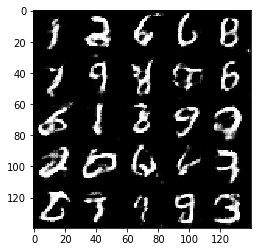

Epoch 1/2 1120... Discriminator Loss: 1.2045... Generator Loss: 0.6366


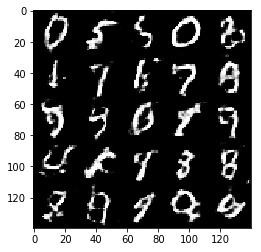

Epoch 1/2 1130... Discriminator Loss: 1.4495... Generator Loss: 0.5598


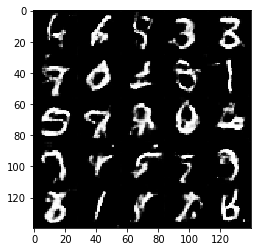

Epoch 1/2 1140... Discriminator Loss: 0.8821... Generator Loss: 1.0059


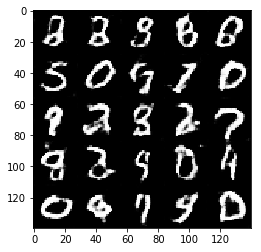

Epoch 1/2 1150... Discriminator Loss: 1.1904... Generator Loss: 0.6403


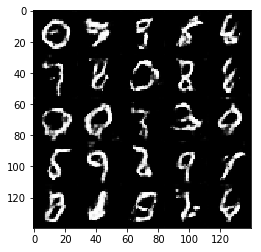

Epoch 1/2 1160... Discriminator Loss: 0.9527... Generator Loss: 1.1095


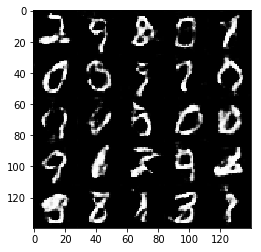

Epoch 1/2 1170... Discriminator Loss: 1.0489... Generator Loss: 0.8809


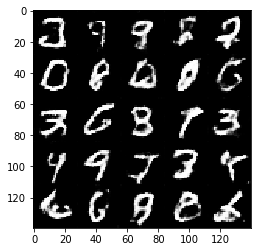

Epoch 1/2 1180... Discriminator Loss: 1.4942... Generator Loss: 0.4390


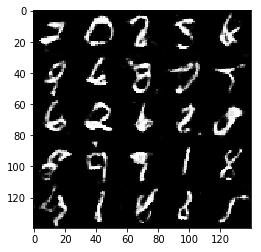

Epoch 1/2 1190... Discriminator Loss: 1.2938... Generator Loss: 0.6660


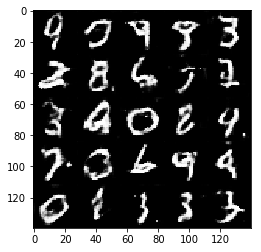

Epoch 1/2 1200... Discriminator Loss: 1.0162... Generator Loss: 1.0764


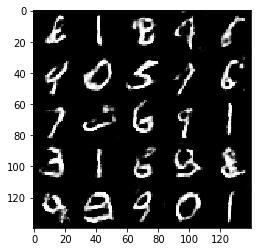

Epoch 1/2 1210... Discriminator Loss: 1.5501... Generator Loss: 0.4152


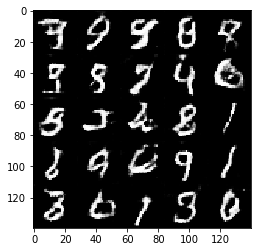

Epoch 1/2 1220... Discriminator Loss: 1.1078... Generator Loss: 0.7586


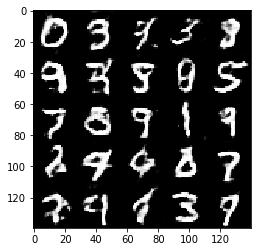

Epoch 1/2... Discriminator Loss: 1.0354... Generator Loss: 0.8908


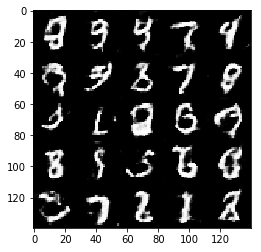

Epoch 2/2 10... Discriminator Loss: 1.1190... Generator Loss: 0.8871


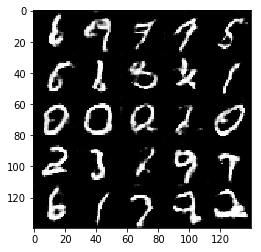

Epoch 2/2 20... Discriminator Loss: 0.8851... Generator Loss: 1.0730


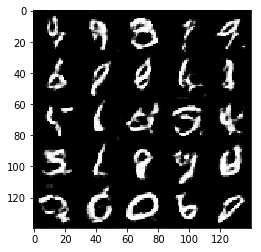

Epoch 2/2 30... Discriminator Loss: 1.6777... Generator Loss: 0.3962


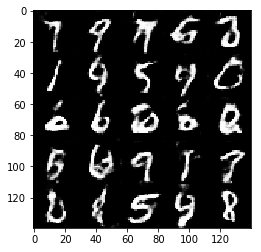

Epoch 2/2 40... Discriminator Loss: 1.2339... Generator Loss: 0.5793


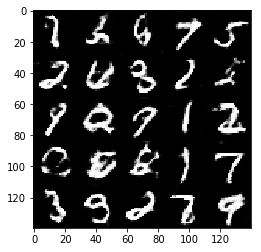

Epoch 2/2 50... Discriminator Loss: 0.9194... Generator Loss: 1.0144


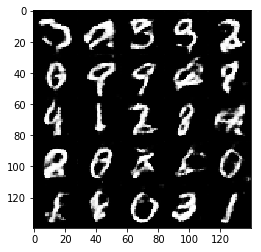

Epoch 2/2 60... Discriminator Loss: 0.9397... Generator Loss: 1.0312


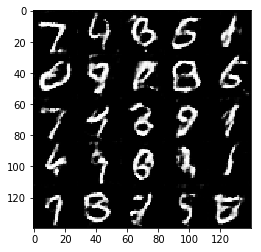

Epoch 2/2 70... Discriminator Loss: 0.9513... Generator Loss: 1.1853


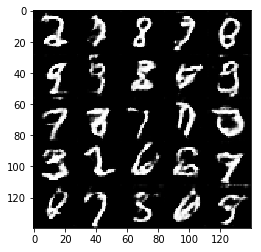

Epoch 2/2 80... Discriminator Loss: 0.9970... Generator Loss: 0.9477


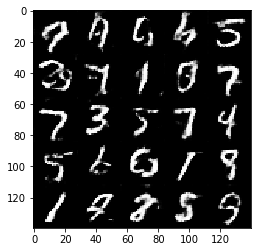

Epoch 2/2 90... Discriminator Loss: 1.1328... Generator Loss: 0.6416


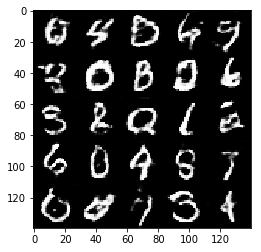

Epoch 2/2 100... Discriminator Loss: 1.1754... Generator Loss: 0.6947


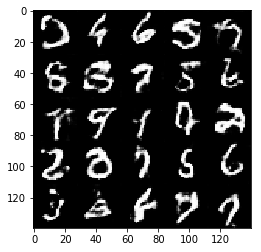

Epoch 2/2 110... Discriminator Loss: 0.7628... Generator Loss: 1.4163


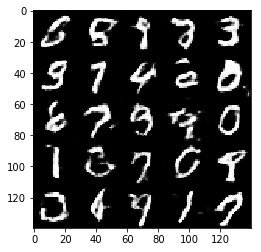

Epoch 2/2 120... Discriminator Loss: 1.4791... Generator Loss: 1.7286


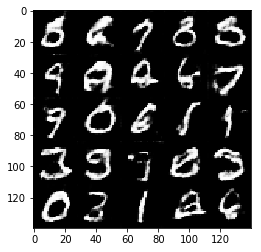

Epoch 2/2 130... Discriminator Loss: 0.7026... Generator Loss: 2.0249


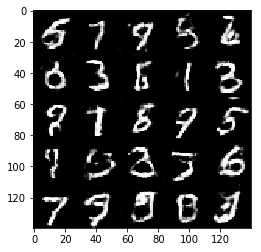

Epoch 2/2 140... Discriminator Loss: 0.9378... Generator Loss: 0.9693


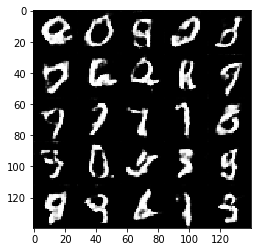

Epoch 2/2 150... Discriminator Loss: 0.8434... Generator Loss: 1.7409


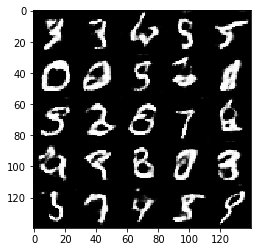

Epoch 2/2 160... Discriminator Loss: 1.3751... Generator Loss: 2.6578


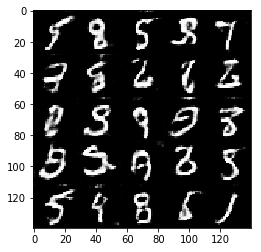

Epoch 2/2 170... Discriminator Loss: 0.7300... Generator Loss: 1.4828


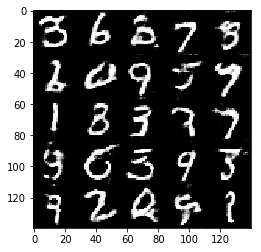

Epoch 2/2 180... Discriminator Loss: 0.9691... Generator Loss: 1.1158


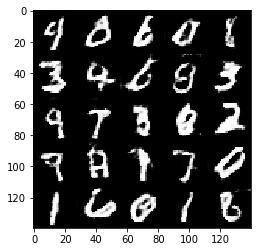

Epoch 2/2 190... Discriminator Loss: 1.7267... Generator Loss: 0.3717


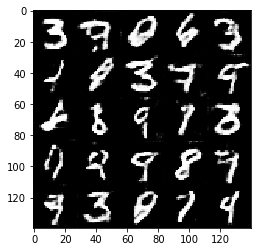

Epoch 2/2 200... Discriminator Loss: 1.2338... Generator Loss: 0.7561


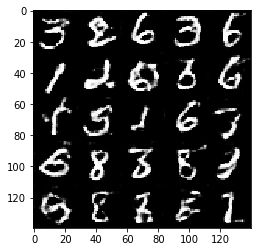

Epoch 2/2 210... Discriminator Loss: 0.7917... Generator Loss: 1.3121


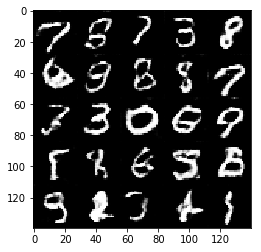

Epoch 2/2 220... Discriminator Loss: 1.7370... Generator Loss: 0.3667


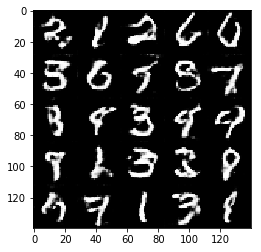

Epoch 2/2 230... Discriminator Loss: 0.9183... Generator Loss: 1.2099


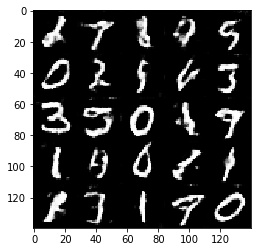

Epoch 2/2 240... Discriminator Loss: 0.6603... Generator Loss: 1.4637


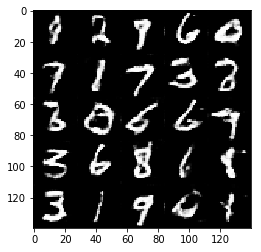

Epoch 2/2 250... Discriminator Loss: 1.1965... Generator Loss: 0.7193


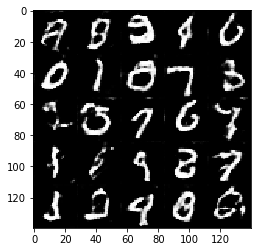

Epoch 2/2 260... Discriminator Loss: 1.0473... Generator Loss: 0.8678


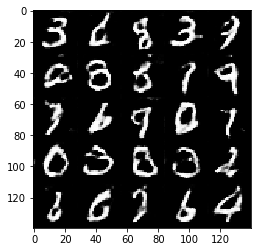

Epoch 2/2 270... Discriminator Loss: 0.8575... Generator Loss: 1.3541


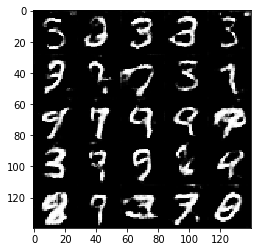

Epoch 2/2 280... Discriminator Loss: 0.7261... Generator Loss: 1.3140


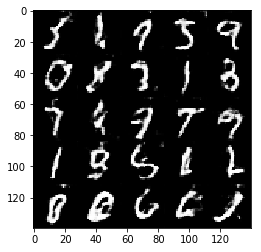

Epoch 2/2 290... Discriminator Loss: 0.9181... Generator Loss: 0.9905


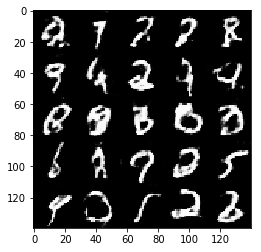

Epoch 2/2 300... Discriminator Loss: 1.2960... Generator Loss: 0.5858


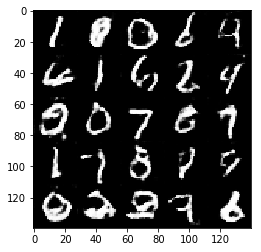

Epoch 2/2 310... Discriminator Loss: 0.7296... Generator Loss: 1.4693


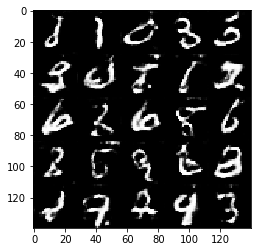

Epoch 2/2 320... Discriminator Loss: 1.9203... Generator Loss: 0.3249


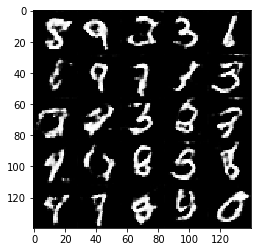

Epoch 2/2 330... Discriminator Loss: 1.1742... Generator Loss: 1.3635


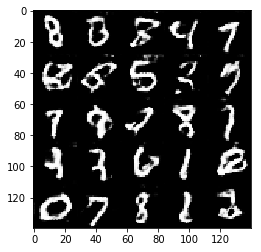

Epoch 2/2 340... Discriminator Loss: 0.8058... Generator Loss: 1.1252


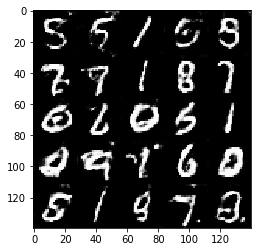

Epoch 2/2 350... Discriminator Loss: 0.9315... Generator Loss: 1.4434


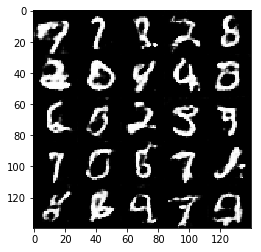

Epoch 2/2 360... Discriminator Loss: 0.9797... Generator Loss: 0.8889


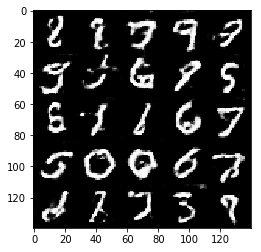

Epoch 2/2 370... Discriminator Loss: 1.1111... Generator Loss: 0.7862


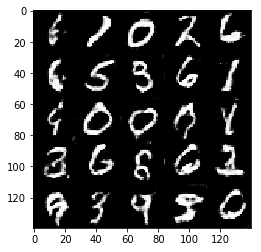

Epoch 2/2 380... Discriminator Loss: 0.9166... Generator Loss: 0.9214


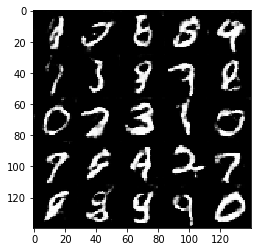

Epoch 2/2 390... Discriminator Loss: 0.5763... Generator Loss: 2.2844


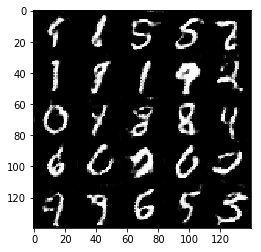

Epoch 2/2 400... Discriminator Loss: 0.8096... Generator Loss: 2.5262


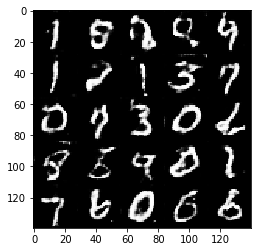

Epoch 2/2 410... Discriminator Loss: 0.9488... Generator Loss: 1.3313


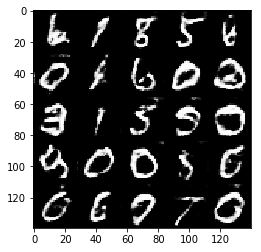

Epoch 2/2 420... Discriminator Loss: 0.8015... Generator Loss: 1.3924


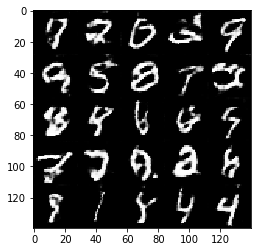

Epoch 2/2 430... Discriminator Loss: 0.6263... Generator Loss: 1.6748


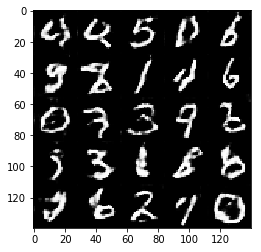

Epoch 2/2 440... Discriminator Loss: 0.7481... Generator Loss: 1.8820


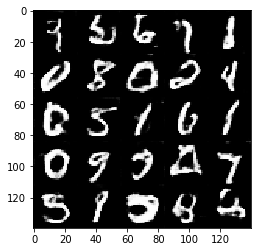

Epoch 2/2 450... Discriminator Loss: 1.4241... Generator Loss: 0.5354


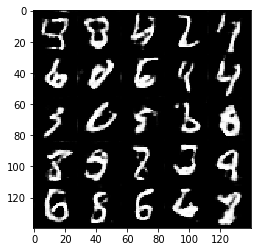

Epoch 2/2 460... Discriminator Loss: 2.4713... Generator Loss: 0.1959


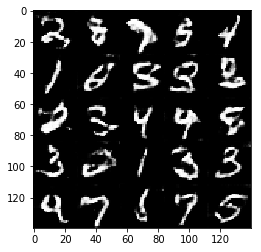

Epoch 2/2 470... Discriminator Loss: 1.1475... Generator Loss: 0.9966


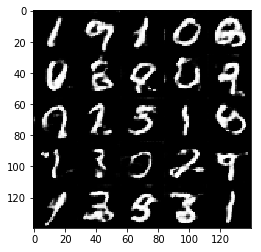

Epoch 2/2 480... Discriminator Loss: 1.0044... Generator Loss: 2.3914


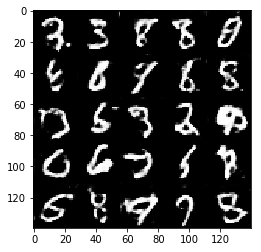

Epoch 2/2 490... Discriminator Loss: 0.9268... Generator Loss: 1.1228


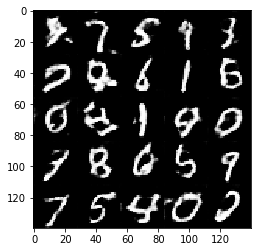

Epoch 2/2 500... Discriminator Loss: 0.7029... Generator Loss: 1.4812


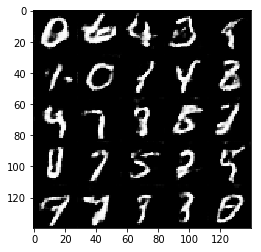

Epoch 2/2 510... Discriminator Loss: 1.1710... Generator Loss: 0.7188


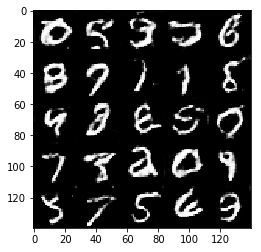

Epoch 2/2 520... Discriminator Loss: 0.6298... Generator Loss: 1.7562


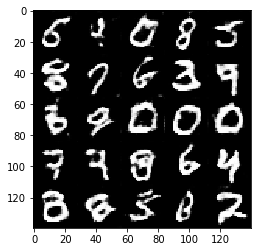

Epoch 2/2 530... Discriminator Loss: 0.6720... Generator Loss: 2.1133


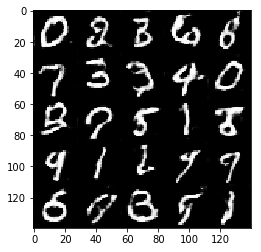

Epoch 2/2 540... Discriminator Loss: 1.5295... Generator Loss: 0.5255


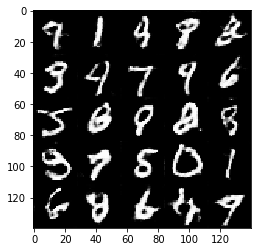

Epoch 2/2 550... Discriminator Loss: 0.9266... Generator Loss: 1.0145


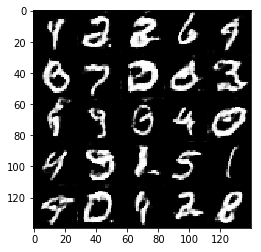

Epoch 2/2 560... Discriminator Loss: 0.7427... Generator Loss: 1.3560


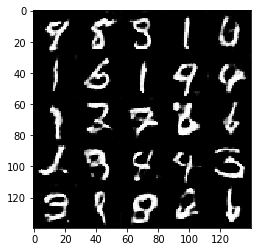

Epoch 2/2 570... Discriminator Loss: 0.9813... Generator Loss: 1.0663


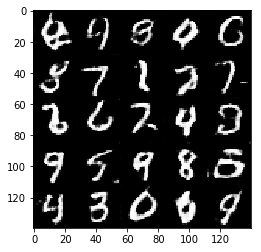

Epoch 2/2 580... Discriminator Loss: 1.2860... Generator Loss: 0.6756


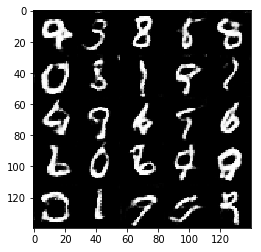

Epoch 2/2 590... Discriminator Loss: 0.9746... Generator Loss: 0.9645


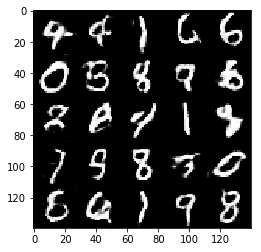

Epoch 2/2 600... Discriminator Loss: 1.3298... Generator Loss: 0.5456


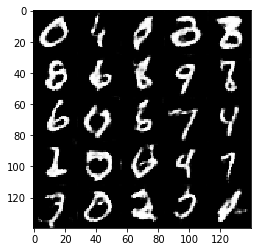

Epoch 2/2 610... Discriminator Loss: 0.8911... Generator Loss: 2.6065


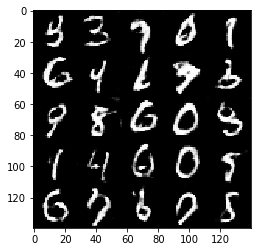

Epoch 2/2 620... Discriminator Loss: 0.9948... Generator Loss: 0.9712


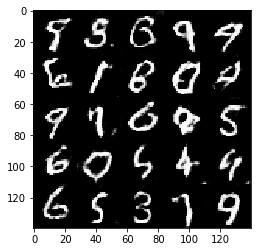

Epoch 2/2 630... Discriminator Loss: 0.7435... Generator Loss: 2.4793


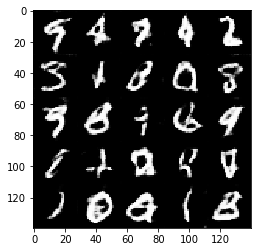

Epoch 2/2 640... Discriminator Loss: 0.7847... Generator Loss: 1.1242


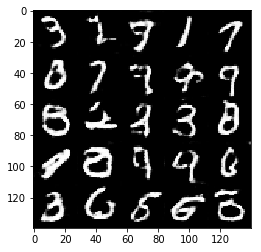

Epoch 2/2 650... Discriminator Loss: 0.8209... Generator Loss: 1.3479


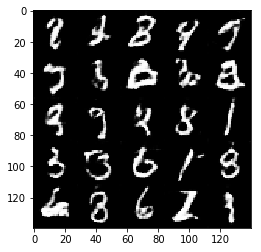

Epoch 2/2 660... Discriminator Loss: 0.6718... Generator Loss: 1.4671


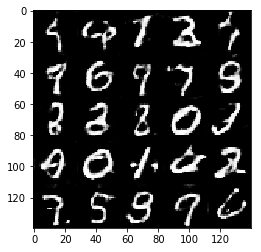

Epoch 2/2 670... Discriminator Loss: 1.3090... Generator Loss: 0.6772


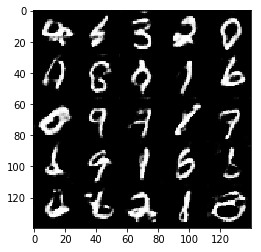

Epoch 2/2 680... Discriminator Loss: 0.9682... Generator Loss: 0.9809


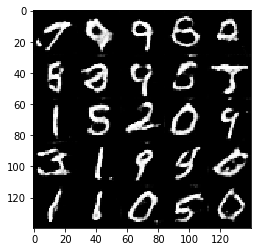

Epoch 2/2 690... Discriminator Loss: 1.4820... Generator Loss: 0.5677


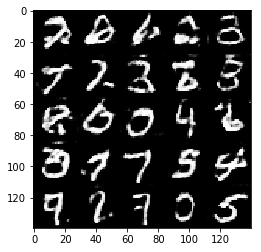

Epoch 2/2 700... Discriminator Loss: 1.2377... Generator Loss: 0.6740


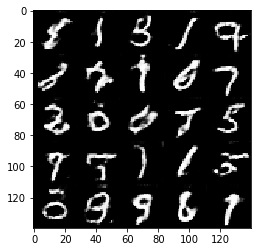

Epoch 2/2 710... Discriminator Loss: 1.1521... Generator Loss: 0.7985


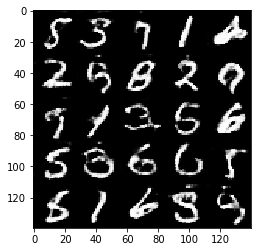

Epoch 2/2 720... Discriminator Loss: 0.7586... Generator Loss: 1.9188


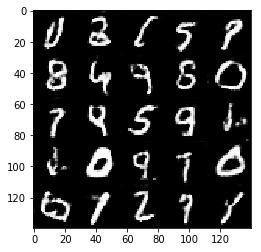

Epoch 2/2 730... Discriminator Loss: 0.8845... Generator Loss: 1.1344


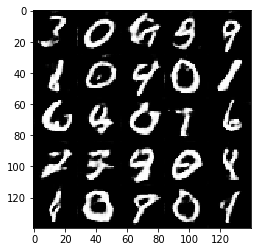

Epoch 2/2 740... Discriminator Loss: 0.6908... Generator Loss: 1.9615


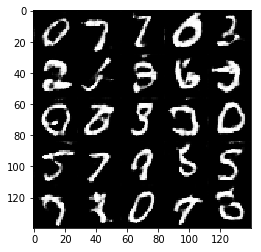

Epoch 2/2 750... Discriminator Loss: 0.7047... Generator Loss: 1.6577


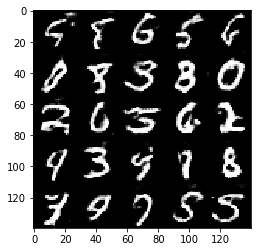

Epoch 2/2 760... Discriminator Loss: 1.0266... Generator Loss: 0.8477


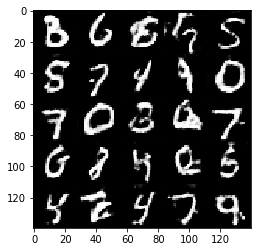

Epoch 2/2 770... Discriminator Loss: 0.9753... Generator Loss: 1.3932


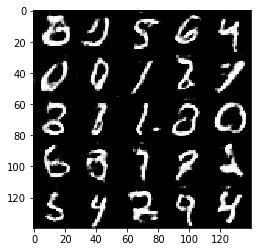

Epoch 2/2 780... Discriminator Loss: 0.5695... Generator Loss: 2.0383


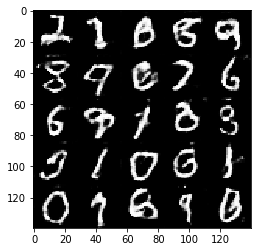

Epoch 2/2 790... Discriminator Loss: 0.9597... Generator Loss: 1.9765


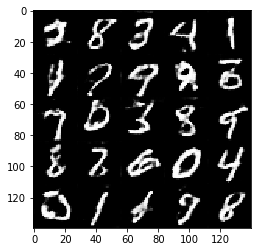

Epoch 2/2 800... Discriminator Loss: 0.8231... Generator Loss: 1.2236


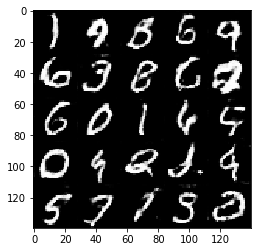

Epoch 2/2 810... Discriminator Loss: 0.6509... Generator Loss: 1.5202


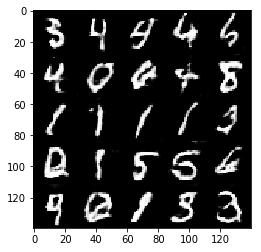

Epoch 2/2 820... Discriminator Loss: 0.7896... Generator Loss: 1.3401


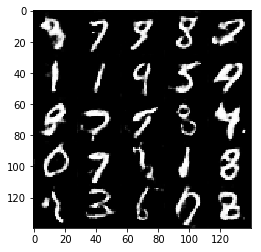

Epoch 2/2 830... Discriminator Loss: 0.8693... Generator Loss: 1.2952


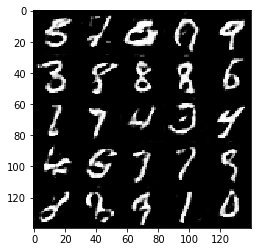

Epoch 2/2 840... Discriminator Loss: 1.6254... Generator Loss: 0.5121


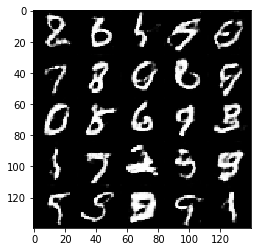

Epoch 2/2 850... Discriminator Loss: 1.6335... Generator Loss: 1.3456


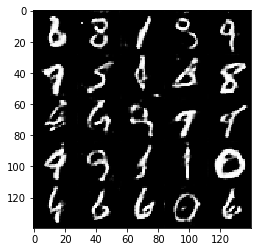

Epoch 2/2 860... Discriminator Loss: 0.9098... Generator Loss: 1.1635


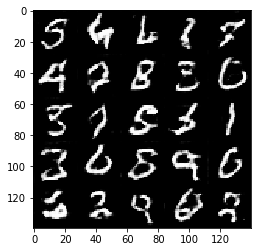

Epoch 2/2 870... Discriminator Loss: 1.8995... Generator Loss: 0.3088


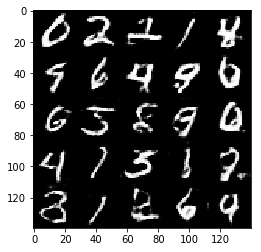

Epoch 2/2 880... Discriminator Loss: 1.6285... Generator Loss: 0.4519


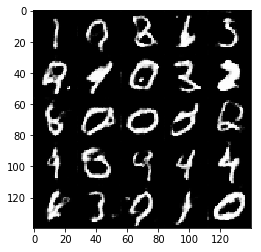

Epoch 2/2 890... Discriminator Loss: 0.7995... Generator Loss: 1.8681


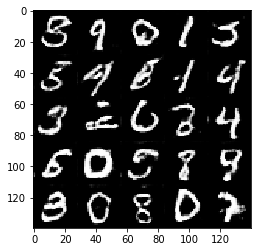

Epoch 2/2 900... Discriminator Loss: 1.2523... Generator Loss: 0.6430


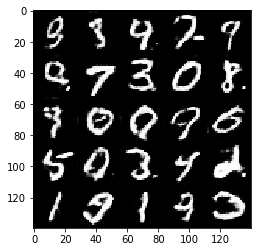

Epoch 2/2 910... Discriminator Loss: 0.9255... Generator Loss: 0.9966


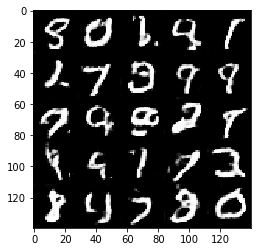

Epoch 2/2 920... Discriminator Loss: 0.9500... Generator Loss: 1.1816


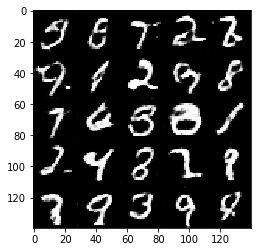

Epoch 2/2 930... Discriminator Loss: 0.6401... Generator Loss: 1.7544


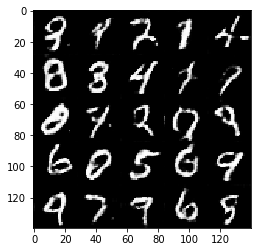

Epoch 2/2 940... Discriminator Loss: 0.6714... Generator Loss: 1.8890


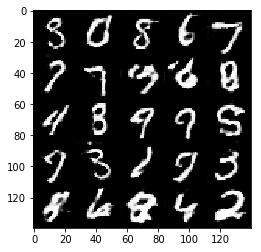

Epoch 2/2 950... Discriminator Loss: 0.5205... Generator Loss: 1.9796


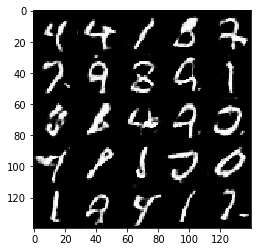

Epoch 2/2 960... Discriminator Loss: 3.0261... Generator Loss: 4.7344


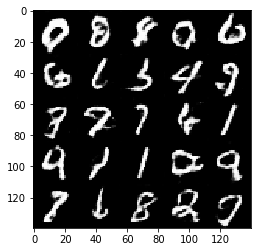

Epoch 2/2 970... Discriminator Loss: 0.8373... Generator Loss: 1.5355


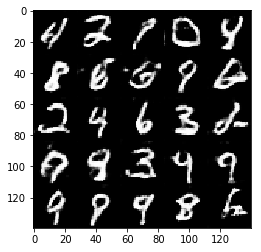

Epoch 2/2 980... Discriminator Loss: 0.9351... Generator Loss: 1.2201


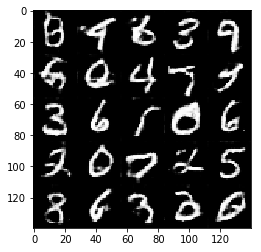

Epoch 2/2 990... Discriminator Loss: 1.8939... Generator Loss: 0.3921


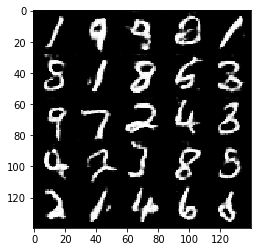

Epoch 2/2 1000... Discriminator Loss: 0.9402... Generator Loss: 2.2260


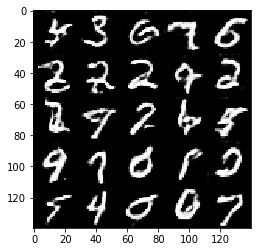

Epoch 2/2 1010... Discriminator Loss: 1.2070... Generator Loss: 0.7788


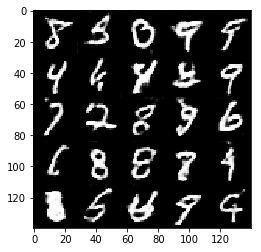

Epoch 2/2 1020... Discriminator Loss: 0.8188... Generator Loss: 1.2384


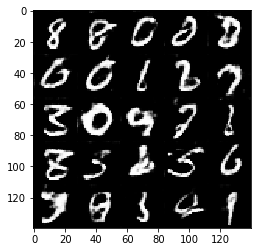

Epoch 2/2 1030... Discriminator Loss: 0.8925... Generator Loss: 1.1291


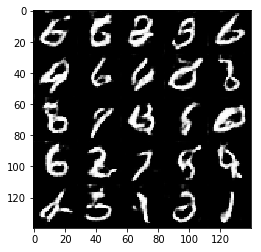

Epoch 2/2 1040... Discriminator Loss: 1.1298... Generator Loss: 0.6869


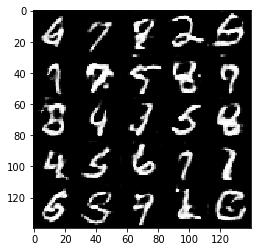

Epoch 2/2 1050... Discriminator Loss: 0.9726... Generator Loss: 0.9779


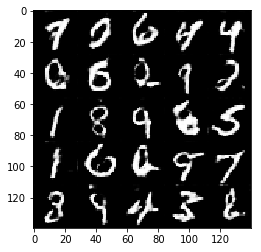

Epoch 2/2 1060... Discriminator Loss: 0.8610... Generator Loss: 1.2095


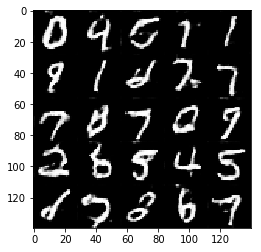

Epoch 2/2 1070... Discriminator Loss: 1.0724... Generator Loss: 0.7892


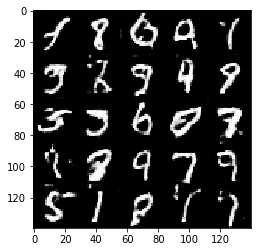

Epoch 2/2 1080... Discriminator Loss: 0.8448... Generator Loss: 1.3827


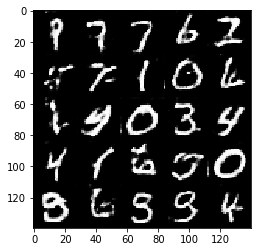

Epoch 2/2 1090... Discriminator Loss: 1.0433... Generator Loss: 0.8464


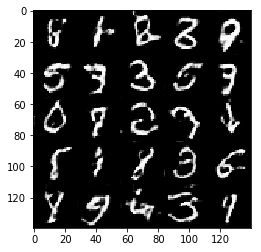

Epoch 2/2 1100... Discriminator Loss: 0.7664... Generator Loss: 1.2198


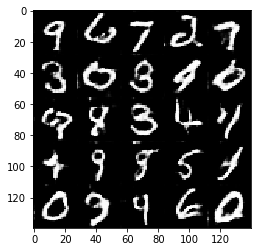

Epoch 2/2 1110... Discriminator Loss: 0.9479... Generator Loss: 2.8124


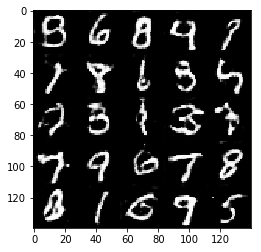

Epoch 2/2 1120... Discriminator Loss: 1.1821... Generator Loss: 0.8910


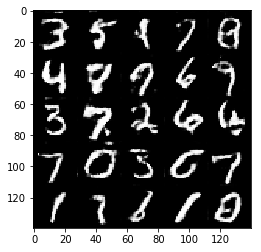

Epoch 2/2 1130... Discriminator Loss: 0.8662... Generator Loss: 1.0796


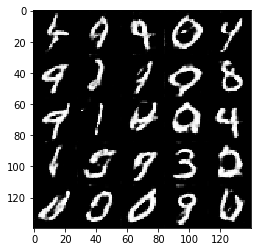

Epoch 2/2 1140... Discriminator Loss: 0.7578... Generator Loss: 1.6610


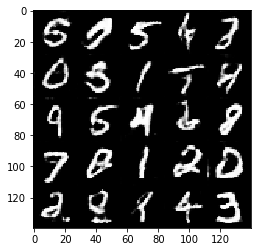

Epoch 2/2 1150... Discriminator Loss: 1.8745... Generator Loss: 0.3353


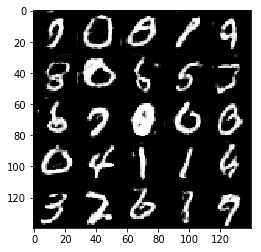

Epoch 2/2 1160... Discriminator Loss: 0.7973... Generator Loss: 1.9403


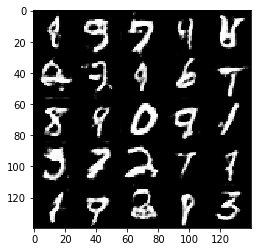

Epoch 2/2 1170... Discriminator Loss: 0.5907... Generator Loss: 1.8729


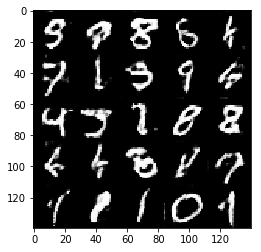

Epoch 2/2 1180... Discriminator Loss: 1.9837... Generator Loss: 0.3903


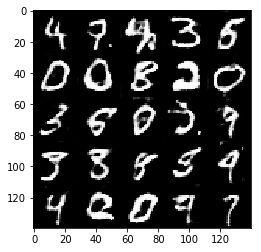

Epoch 2/2 1190... Discriminator Loss: 0.8218... Generator Loss: 1.1836


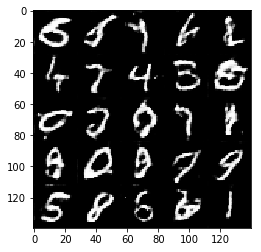

Epoch 2/2 1200... Discriminator Loss: 0.8586... Generator Loss: 1.0467


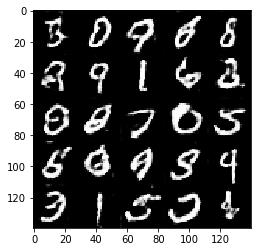

Epoch 2/2 1210... Discriminator Loss: 1.1220... Generator Loss: 1.3115


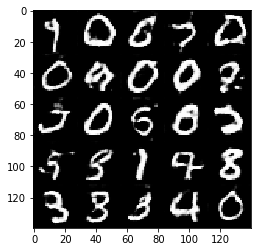

Epoch 2/2 1220... Discriminator Loss: 1.7466... Generator Loss: 0.4337


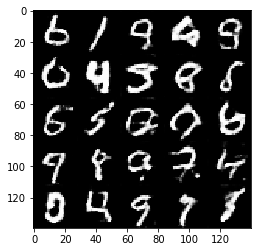

Epoch 2/2... Discriminator Loss: 1.1955... Generator Loss: 0.7630


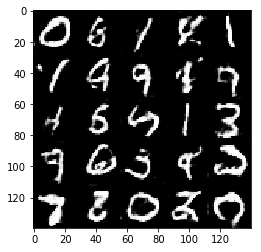

In [77]:
batch_size = 49 # 100
z_dim = 100
learning_rate = 0.001
beta1 = 0.5


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 2

mnist_dataset = helper.Dataset('mnist', glob(os.path.join(data_dir, 'mnist/*.jpg')))
# with tf.Graph().as_default():
train(
    epochs, 
    batch_size, 
    z_dim, 
    learning_rate, 
    beta1, 
    mnist_dataset.get_batches,
    mnist_dataset.shape, 
    mnist_dataset.image_mode
)

### CelebA
Run your GANs on CelebA.  It will take around 20 minutes on the average GPU to run one epoch.  You can run the whole epoch or stop when it starts to generate realistic faces.

Epoch 1/1 10... Discriminator Loss: 0.9627... Generator Loss: 0.9363


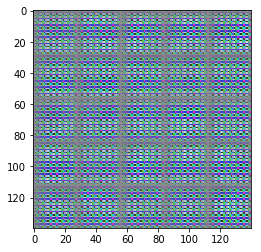

Epoch 1/1 20... Discriminator Loss: 0.7809... Generator Loss: 1.2700


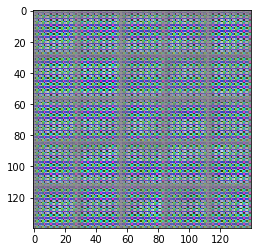

Epoch 1/1 30... Discriminator Loss: 0.7255... Generator Loss: 1.8411


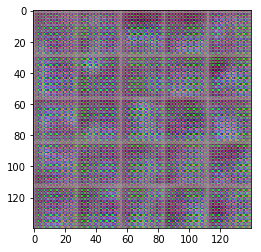

Epoch 1/1 40... Discriminator Loss: 1.7684... Generator Loss: 0.8132


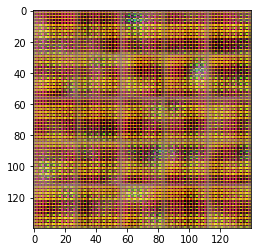

Epoch 1/1 50... Discriminator Loss: 1.9343... Generator Loss: 2.4994


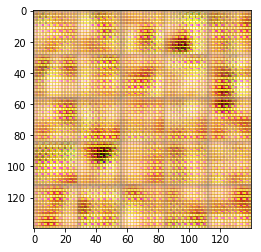

Epoch 1/1 60... Discriminator Loss: 0.6292... Generator Loss: 2.0949


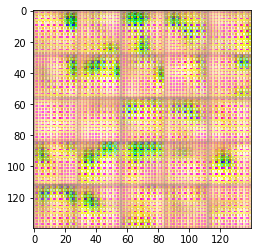

Epoch 1/1 70... Discriminator Loss: 0.7001... Generator Loss: 2.8725


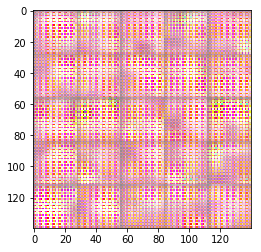

Epoch 1/1 80... Discriminator Loss: 0.9797... Generator Loss: 1.8114


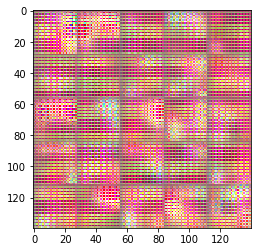

Epoch 1/1 90... Discriminator Loss: 0.9074... Generator Loss: 1.2168


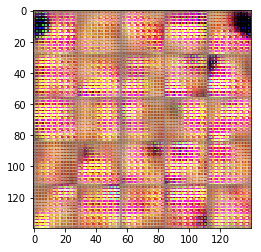

Epoch 1/1 100... Discriminator Loss: 0.9263... Generator Loss: 2.1627


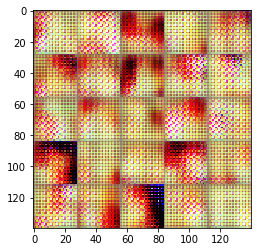

Epoch 1/1 110... Discriminator Loss: 1.4816... Generator Loss: 2.6132


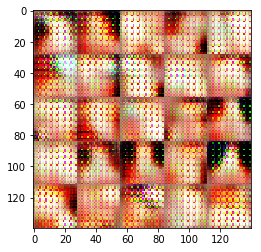

Epoch 1/1 120... Discriminator Loss: 1.0591... Generator Loss: 1.7267


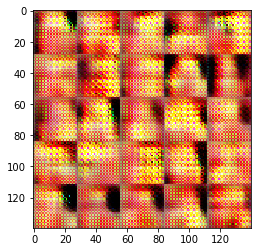

Epoch 1/1 130... Discriminator Loss: 1.7559... Generator Loss: 1.8740


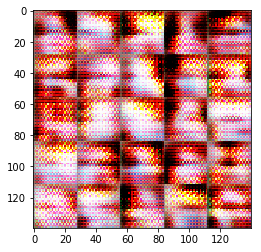

Epoch 1/1 140... Discriminator Loss: 1.8137... Generator Loss: 3.9837


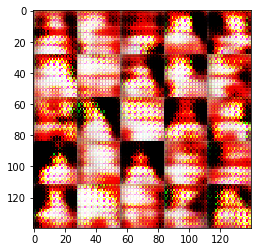

Epoch 1/1 150... Discriminator Loss: 0.4679... Generator Loss: 3.1175


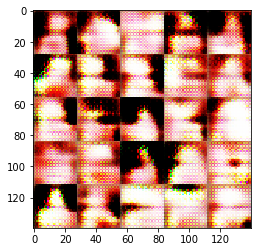

Epoch 1/1 160... Discriminator Loss: 1.2676... Generator Loss: 0.6982


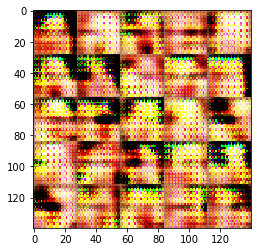

Epoch 1/1 170... Discriminator Loss: 0.7548... Generator Loss: 2.1580


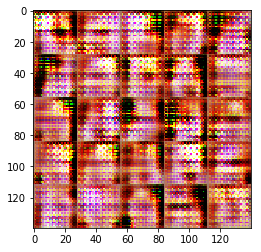

Epoch 1/1 180... Discriminator Loss: 0.5396... Generator Loss: 2.3405


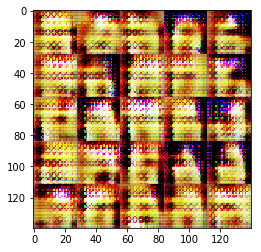

Epoch 1/1 190... Discriminator Loss: 2.0543... Generator Loss: 4.1234


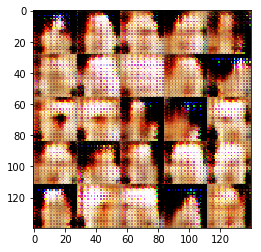

Epoch 1/1 200... Discriminator Loss: 1.5586... Generator Loss: 5.1626


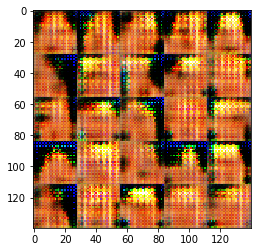

Epoch 1/1 210... Discriminator Loss: 1.1657... Generator Loss: 2.6632


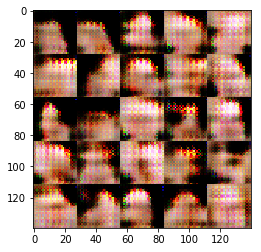

Epoch 1/1 220... Discriminator Loss: 0.8038... Generator Loss: 1.3786


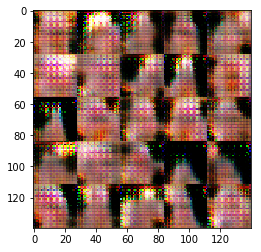

Epoch 1/1 230... Discriminator Loss: 1.6708... Generator Loss: 5.4221


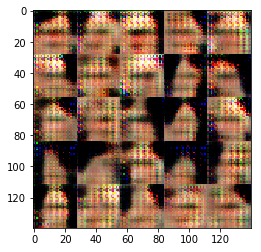

Epoch 1/1 240... Discriminator Loss: 0.4080... Generator Loss: 3.5810


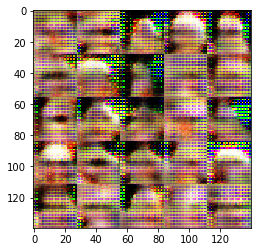

Epoch 1/1 250... Discriminator Loss: 2.7539... Generator Loss: 0.1483


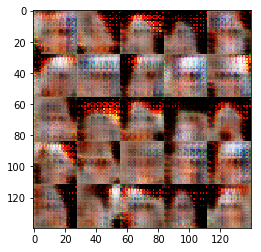

Epoch 1/1 260... Discriminator Loss: 0.7248... Generator Loss: 2.3564


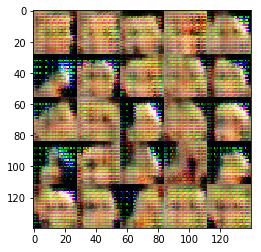

Epoch 1/1 270... Discriminator Loss: 0.4726... Generator Loss: 3.3928


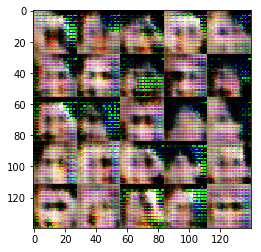

Epoch 1/1 280... Discriminator Loss: 2.3278... Generator Loss: 0.2679


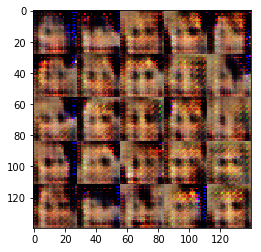

Epoch 1/1 290... Discriminator Loss: 1.7635... Generator Loss: 0.3351


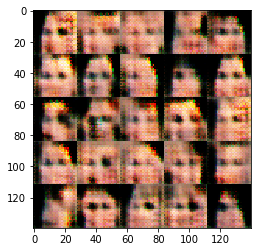

Epoch 1/1 300... Discriminator Loss: 2.0961... Generator Loss: 0.2073


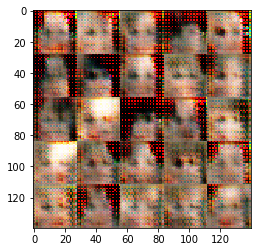

Epoch 1/1 310... Discriminator Loss: 1.1730... Generator Loss: 1.5591


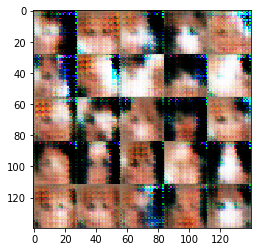

Epoch 1/1 320... Discriminator Loss: 1.5381... Generator Loss: 0.8442


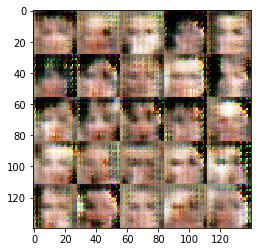

Epoch 1/1 330... Discriminator Loss: 1.8064... Generator Loss: 0.8372


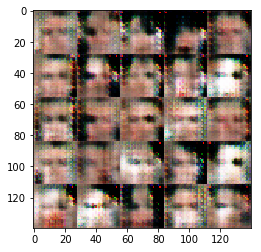

Epoch 1/1 340... Discriminator Loss: 0.9921... Generator Loss: 0.9619


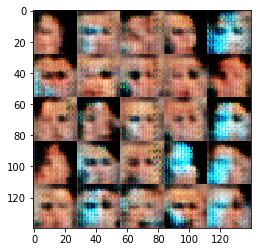

Epoch 1/1 350... Discriminator Loss: 1.0134... Generator Loss: 1.0698


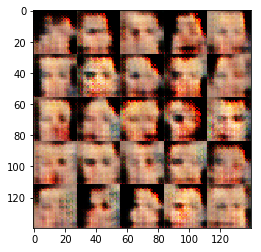

Epoch 1/1 360... Discriminator Loss: 2.4591... Generator Loss: 0.1959


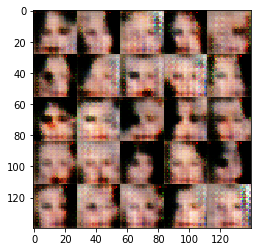

Epoch 1/1 370... Discriminator Loss: 0.9742... Generator Loss: 1.7127


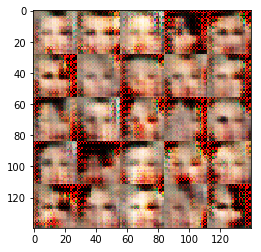

Epoch 1/1 380... Discriminator Loss: 1.7437... Generator Loss: 0.4572


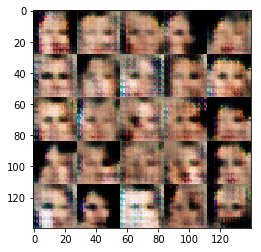

Epoch 1/1 390... Discriminator Loss: 1.4903... Generator Loss: 0.6395


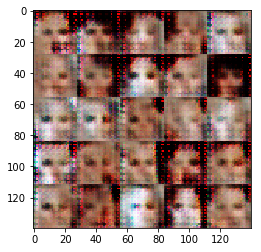

Epoch 1/1 400... Discriminator Loss: 1.1567... Generator Loss: 0.8850


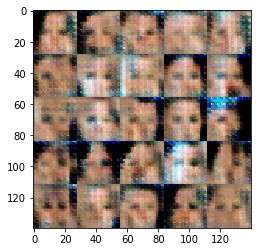

Epoch 1/1 410... Discriminator Loss: 1.8386... Generator Loss: 0.4633


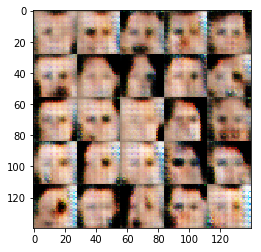

Epoch 1/1 420... Discriminator Loss: 0.6093... Generator Loss: 1.6155


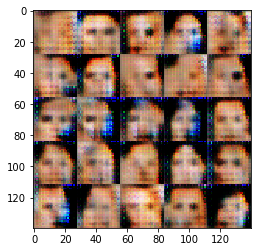

Epoch 1/1 430... Discriminator Loss: 1.6214... Generator Loss: 0.4922


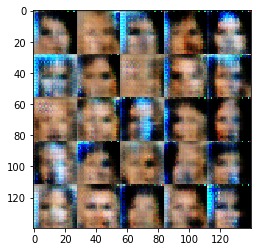

Epoch 1/1 440... Discriminator Loss: 1.9284... Generator Loss: 0.3313


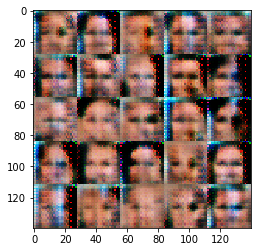

Epoch 1/1 450... Discriminator Loss: 0.9448... Generator Loss: 1.7820


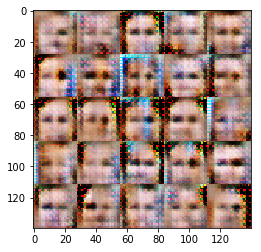

Epoch 1/1 460... Discriminator Loss: 2.2392... Generator Loss: 0.2128


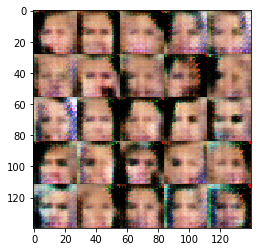

Epoch 1/1 470... Discriminator Loss: 1.3303... Generator Loss: 1.1700


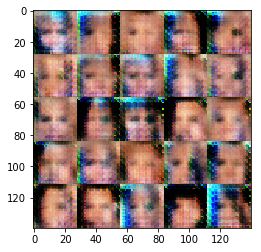

Epoch 1/1 480... Discriminator Loss: 1.0697... Generator Loss: 1.5316


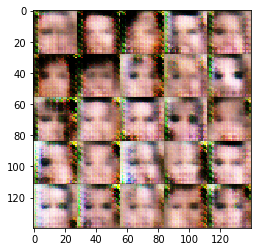

Epoch 1/1 490... Discriminator Loss: 1.2312... Generator Loss: 0.8369


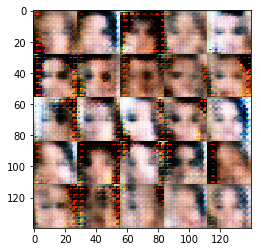

Epoch 1/1 500... Discriminator Loss: 2.2376... Generator Loss: 0.2695


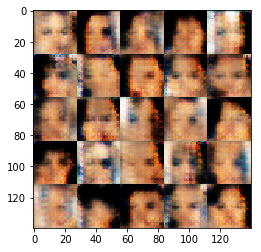

Epoch 1/1 510... Discriminator Loss: 1.3308... Generator Loss: 0.6409


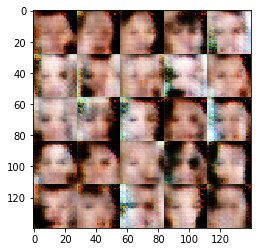

Epoch 1/1 520... Discriminator Loss: 1.6682... Generator Loss: 0.5527


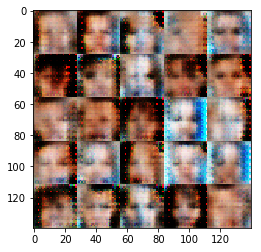

Epoch 1/1 530... Discriminator Loss: 1.7051... Generator Loss: 0.4788


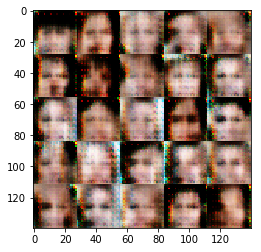

Epoch 1/1 540... Discriminator Loss: 0.8699... Generator Loss: 0.9978


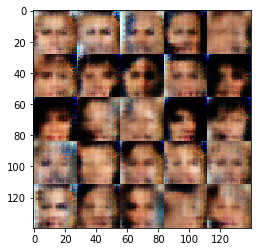

Epoch 1/1 550... Discriminator Loss: 1.2308... Generator Loss: 1.1526


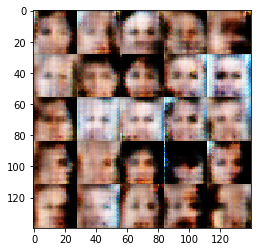

Epoch 1/1 560... Discriminator Loss: 1.7339... Generator Loss: 0.3974


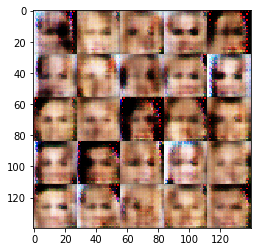

Epoch 1/1 570... Discriminator Loss: 1.3006... Generator Loss: 1.8408


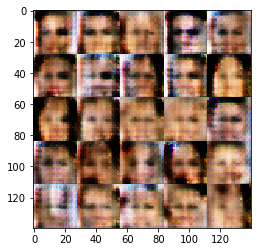

Epoch 1/1 580... Discriminator Loss: 1.5141... Generator Loss: 0.6603


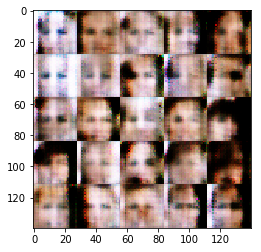

Epoch 1/1 590... Discriminator Loss: 0.7334... Generator Loss: 1.6333


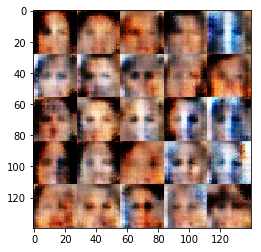

Epoch 1/1 600... Discriminator Loss: 0.9685... Generator Loss: 1.0278


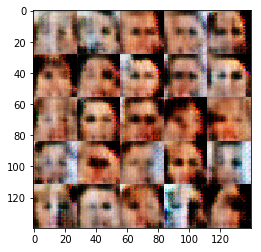

Epoch 1/1 610... Discriminator Loss: 1.1209... Generator Loss: 0.8103


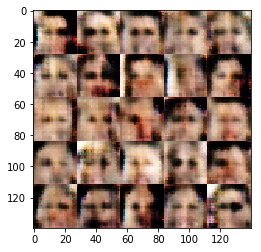

Epoch 1/1 620... Discriminator Loss: 1.2350... Generator Loss: 0.6567


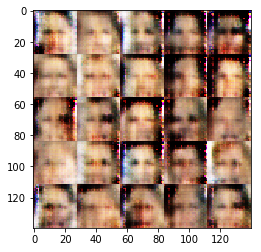

Epoch 1/1 630... Discriminator Loss: 0.7443... Generator Loss: 1.6287


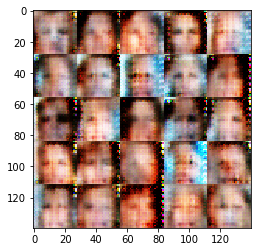

Epoch 1/1 640... Discriminator Loss: 2.0994... Generator Loss: 0.4457


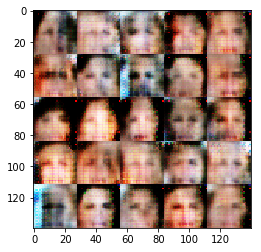

Epoch 1/1 650... Discriminator Loss: 1.4166... Generator Loss: 0.6758


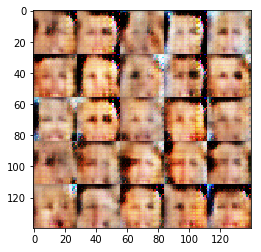

Epoch 1/1 660... Discriminator Loss: 2.0071... Generator Loss: 0.6819


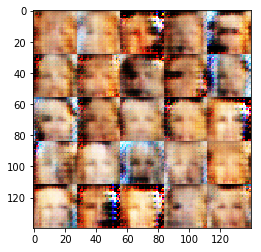

Epoch 1/1 670... Discriminator Loss: 0.8104... Generator Loss: 1.7407


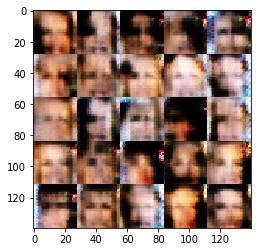

Epoch 1/1 680... Discriminator Loss: 1.0667... Generator Loss: 0.7592


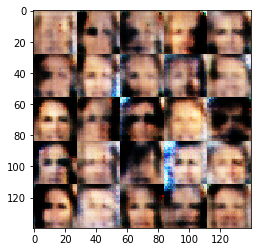

Epoch 1/1 690... Discriminator Loss: 1.2609... Generator Loss: 0.9398


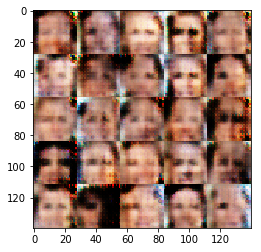

Epoch 1/1 700... Discriminator Loss: 1.3778... Generator Loss: 0.8093


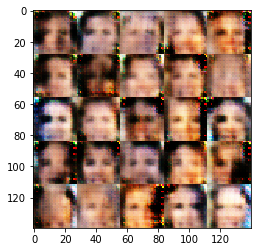

Epoch 1/1 710... Discriminator Loss: 1.1301... Generator Loss: 2.0657


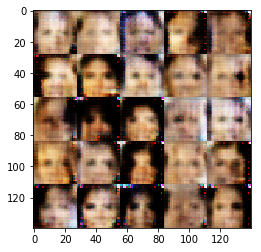

Epoch 1/1 720... Discriminator Loss: 0.7265... Generator Loss: 1.9554


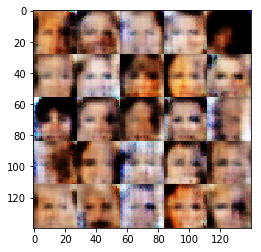

Epoch 1/1 730... Discriminator Loss: 0.6926... Generator Loss: 1.6002


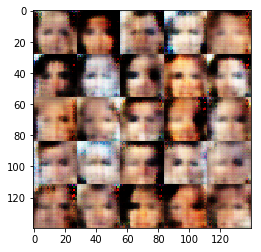

Epoch 1/1 740... Discriminator Loss: 2.0265... Generator Loss: 0.4229


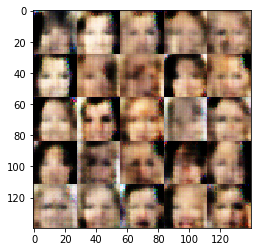

Epoch 1/1 750... Discriminator Loss: 1.0777... Generator Loss: 0.9334


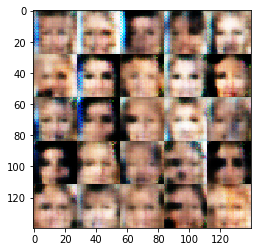

Epoch 1/1 760... Discriminator Loss: 1.1116... Generator Loss: 0.7483


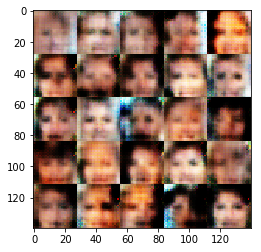

Epoch 1/1 770... Discriminator Loss: 1.0767... Generator Loss: 0.7097


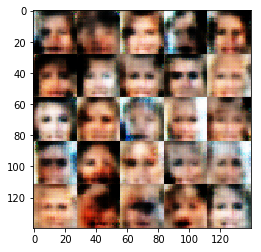

Epoch 1/1 780... Discriminator Loss: 0.7803... Generator Loss: 1.6135


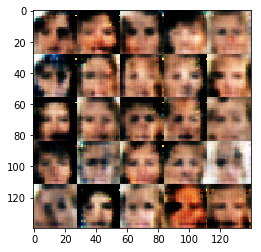

Epoch 1/1 790... Discriminator Loss: 1.8300... Generator Loss: 0.4110


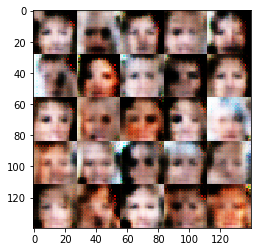

Epoch 1/1 800... Discriminator Loss: 0.9231... Generator Loss: 1.3145


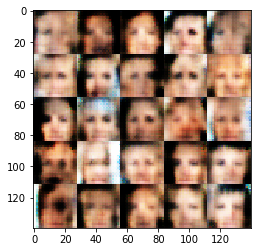

Epoch 1/1 810... Discriminator Loss: 1.0592... Generator Loss: 0.7826


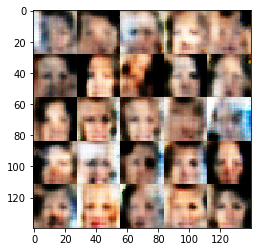

Epoch 1/1 820... Discriminator Loss: 1.0491... Generator Loss: 1.0176


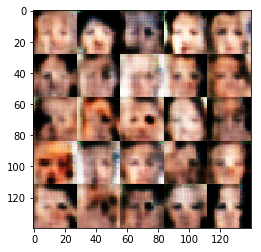

Epoch 1/1 830... Discriminator Loss: 0.5622... Generator Loss: 2.1354


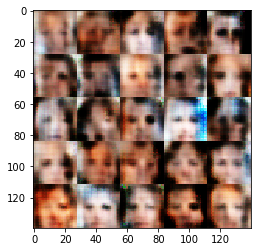

Epoch 1/1 840... Discriminator Loss: 0.5692... Generator Loss: 1.6654


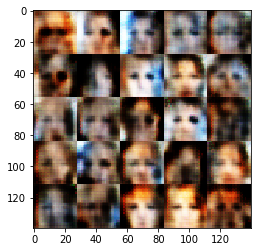

Epoch 1/1 850... Discriminator Loss: 0.8683... Generator Loss: 2.0414


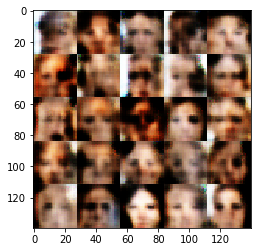

Epoch 1/1 860... Discriminator Loss: 0.7628... Generator Loss: 1.2735


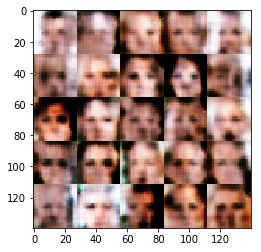

Epoch 1/1 870... Discriminator Loss: 1.6085... Generator Loss: 0.4428


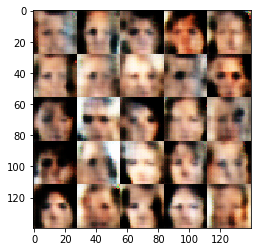

Epoch 1/1 880... Discriminator Loss: 1.5387... Generator Loss: 2.3194


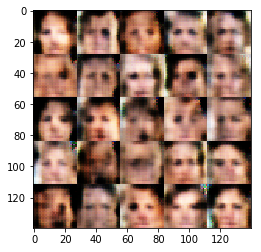

Epoch 1/1 890... Discriminator Loss: 1.4418... Generator Loss: 0.5101


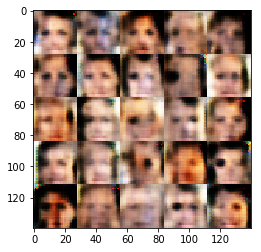

Epoch 1/1 900... Discriminator Loss: 0.8959... Generator Loss: 1.0199


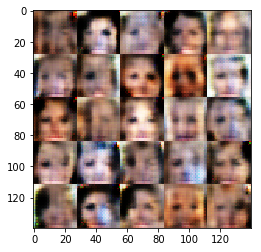

Epoch 1/1 910... Discriminator Loss: 1.2224... Generator Loss: 0.7767


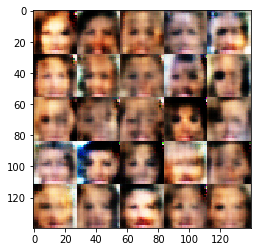

Epoch 1/1 920... Discriminator Loss: 2.4812... Generator Loss: 0.2006


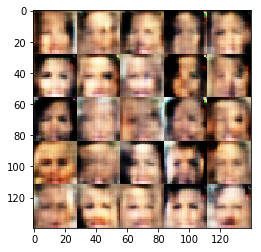

Epoch 1/1 930... Discriminator Loss: 1.1000... Generator Loss: 1.4781


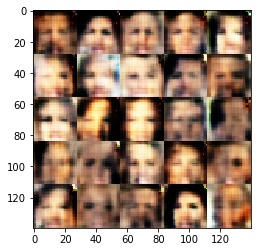

Epoch 1/1 940... Discriminator Loss: 1.3863... Generator Loss: 0.5758


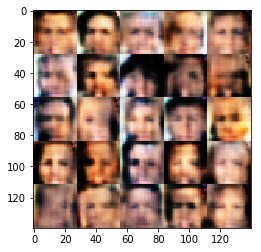

Epoch 1/1 950... Discriminator Loss: 1.2349... Generator Loss: 0.7064


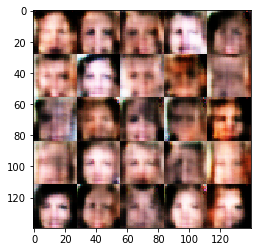

Epoch 1/1 960... Discriminator Loss: 0.8433... Generator Loss: 1.1744


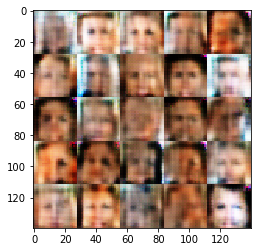

Epoch 1/1 970... Discriminator Loss: 1.7455... Generator Loss: 2.8387


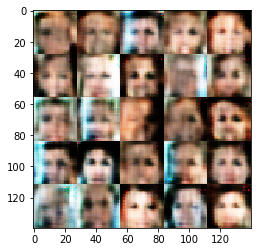

Epoch 1/1 980... Discriminator Loss: 0.6958... Generator Loss: 1.7375


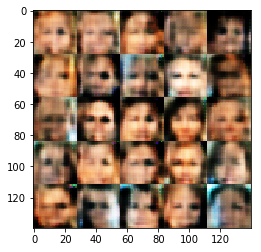

Epoch 1/1 990... Discriminator Loss: 0.9040... Generator Loss: 1.0587


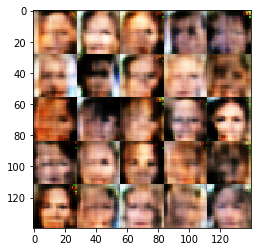

Epoch 1/1 1000... Discriminator Loss: 1.6786... Generator Loss: 0.4530


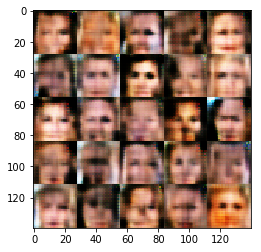

Epoch 1/1 1010... Discriminator Loss: 0.8111... Generator Loss: 2.1592


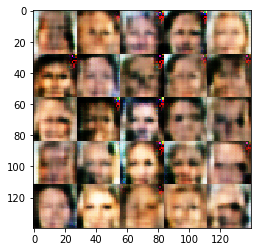

Epoch 1/1 1020... Discriminator Loss: 1.5336... Generator Loss: 2.2079


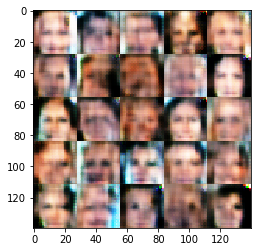

Epoch 1/1 1030... Discriminator Loss: 1.2126... Generator Loss: 2.6361


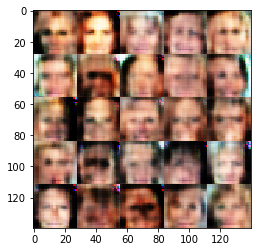

Epoch 1/1 1040... Discriminator Loss: 1.7407... Generator Loss: 2.4077


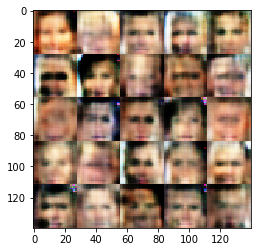

Epoch 1/1 1050... Discriminator Loss: 0.8016... Generator Loss: 1.5869


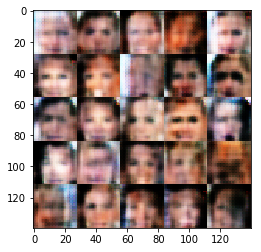

Epoch 1/1 1060... Discriminator Loss: 1.5608... Generator Loss: 0.4663


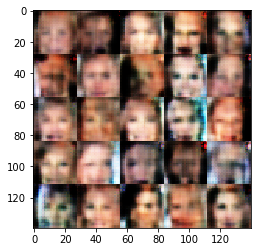

Epoch 1/1 1070... Discriminator Loss: 0.8717... Generator Loss: 1.5165


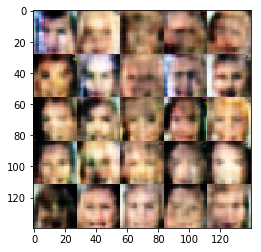

Epoch 1/1 1080... Discriminator Loss: 0.8354... Generator Loss: 1.4717


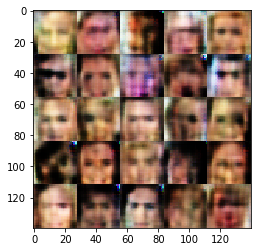

Epoch 1/1 1090... Discriminator Loss: 1.0472... Generator Loss: 0.8088


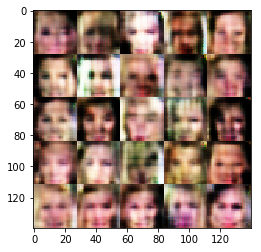

Epoch 1/1 1100... Discriminator Loss: 0.9328... Generator Loss: 2.2946


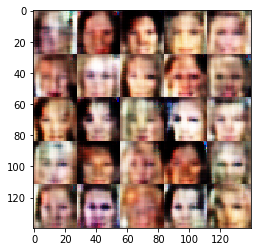

Epoch 1/1 1110... Discriminator Loss: 1.2209... Generator Loss: 0.7522


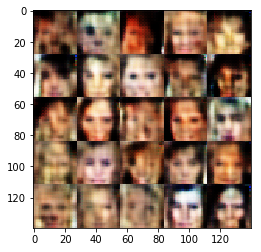

Epoch 1/1 1120... Discriminator Loss: 0.8863... Generator Loss: 1.0571


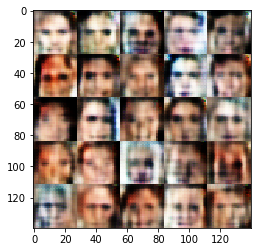

Epoch 1/1 1130... Discriminator Loss: 1.3600... Generator Loss: 1.9793


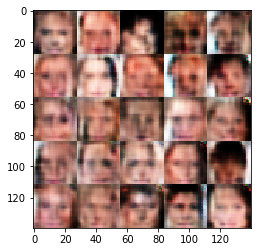

Epoch 1/1 1140... Discriminator Loss: 1.1203... Generator Loss: 0.9159


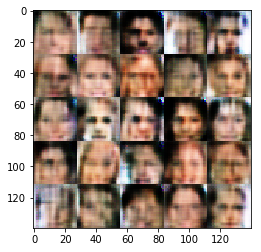

Epoch 1/1 1150... Discriminator Loss: 1.1243... Generator Loss: 1.1193


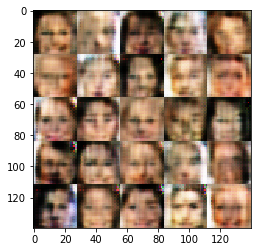

Epoch 1/1 1160... Discriminator Loss: 1.0300... Generator Loss: 1.1195


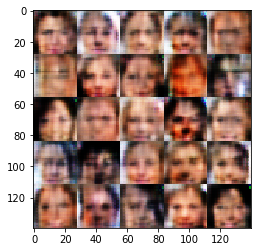

Epoch 1/1 1170... Discriminator Loss: 1.2843... Generator Loss: 0.6744


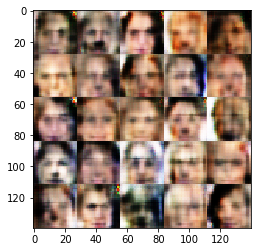

Epoch 1/1 1180... Discriminator Loss: 1.1544... Generator Loss: 0.7738


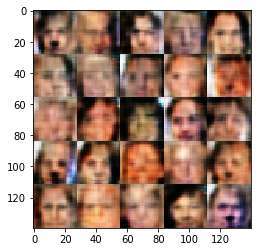

Epoch 1/1 1190... Discriminator Loss: 1.2813... Generator Loss: 2.3786


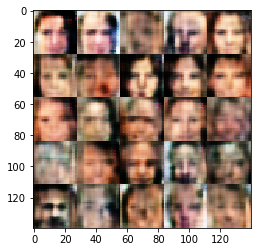

Epoch 1/1 1200... Discriminator Loss: 1.4492... Generator Loss: 0.5331


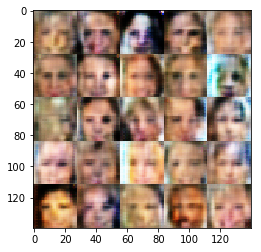

Epoch 1/1 1210... Discriminator Loss: 0.9044... Generator Loss: 1.2350


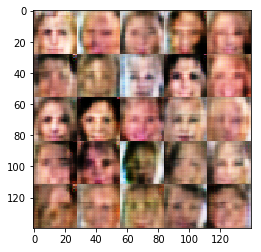

Epoch 1/1 1220... Discriminator Loss: 1.2359... Generator Loss: 0.8784


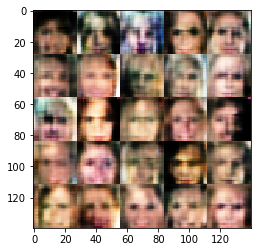

Epoch 1/1 1230... Discriminator Loss: 1.3632... Generator Loss: 1.1432


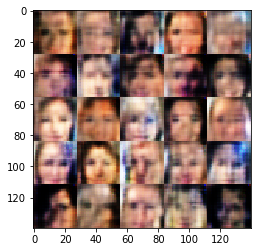

Epoch 1/1 1240... Discriminator Loss: 1.4446... Generator Loss: 1.4959


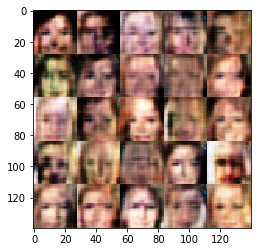

Epoch 1/1 1250... Discriminator Loss: 0.8157... Generator Loss: 1.6561


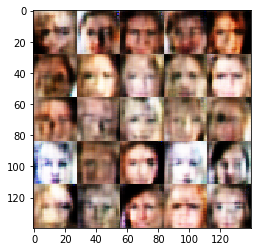

Epoch 1/1 1260... Discriminator Loss: 1.2567... Generator Loss: 1.0764


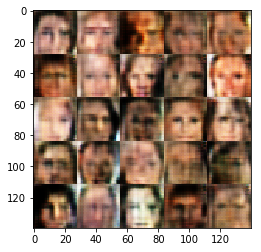

Epoch 1/1 1270... Discriminator Loss: 1.2821... Generator Loss: 0.6264


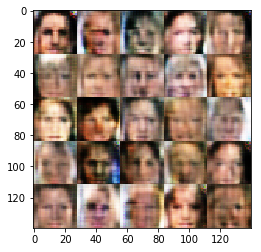

Epoch 1/1 1280... Discriminator Loss: 1.0772... Generator Loss: 0.8812


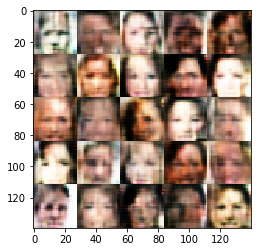

Epoch 1/1 1290... Discriminator Loss: 1.3290... Generator Loss: 0.5811


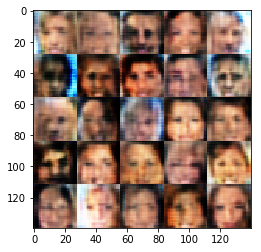

Epoch 1/1 1300... Discriminator Loss: 0.9021... Generator Loss: 1.3475


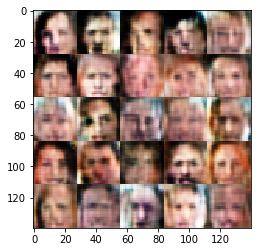

Epoch 1/1 1310... Discriminator Loss: 1.2275... Generator Loss: 0.6577


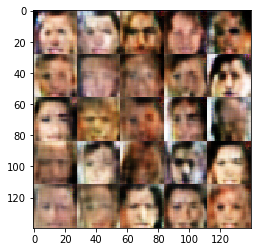

Epoch 1/1 1320... Discriminator Loss: 1.0736... Generator Loss: 0.8713


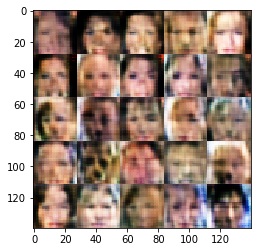

Epoch 1/1 1330... Discriminator Loss: 0.9259... Generator Loss: 1.1513


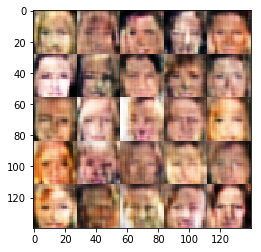

Epoch 1/1 1340... Discriminator Loss: 0.9000... Generator Loss: 1.0548


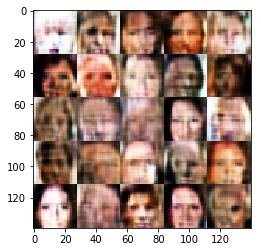

Epoch 1/1 1350... Discriminator Loss: 1.0481... Generator Loss: 2.0788


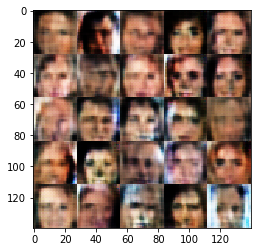

Epoch 1/1 1360... Discriminator Loss: 1.2194... Generator Loss: 0.7312


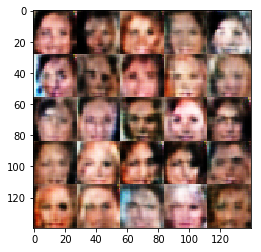

Epoch 1/1 1370... Discriminator Loss: 0.9600... Generator Loss: 1.4536


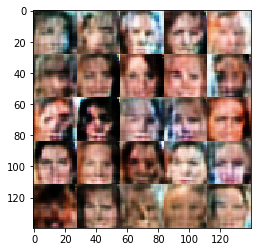

Epoch 1/1 1380... Discriminator Loss: 0.9265... Generator Loss: 1.3775


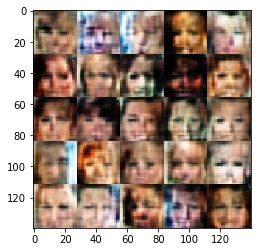

Epoch 1/1 1390... Discriminator Loss: 0.8794... Generator Loss: 1.7396


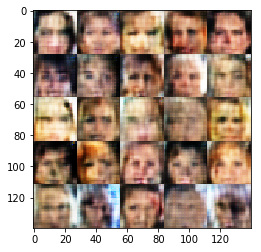

Epoch 1/1 1400... Discriminator Loss: 1.0233... Generator Loss: 1.4709


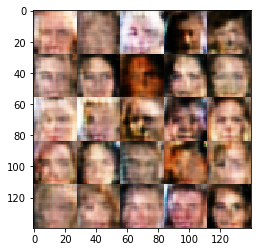

Epoch 1/1 1410... Discriminator Loss: 1.3088... Generator Loss: 0.5528


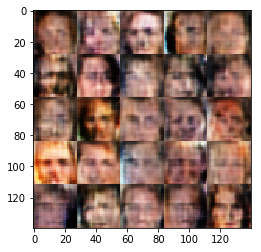

Epoch 1/1 1420... Discriminator Loss: 1.6056... Generator Loss: 1.9774


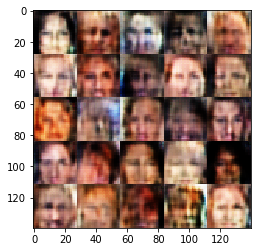

Epoch 1/1 1430... Discriminator Loss: 0.9106... Generator Loss: 1.3606


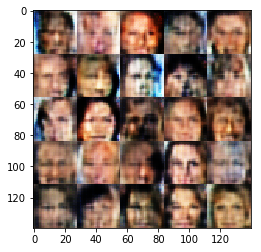

Epoch 1/1 1440... Discriminator Loss: 1.0650... Generator Loss: 2.0017


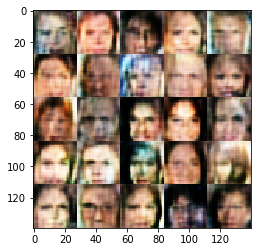

Epoch 1/1 1450... Discriminator Loss: 1.1320... Generator Loss: 0.9095


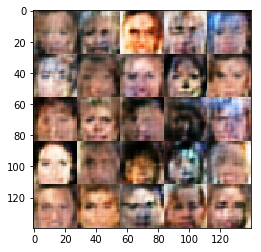

Epoch 1/1 1460... Discriminator Loss: 1.2671... Generator Loss: 0.6910


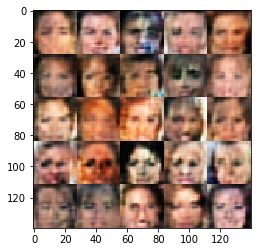

Epoch 1/1 1470... Discriminator Loss: 1.0890... Generator Loss: 1.0459


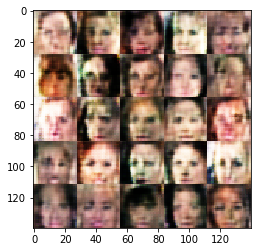

Epoch 1/1 1480... Discriminator Loss: 1.3209... Generator Loss: 0.8116


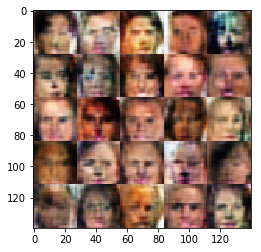

Epoch 1/1 1490... Discriminator Loss: 1.1812... Generator Loss: 1.2747


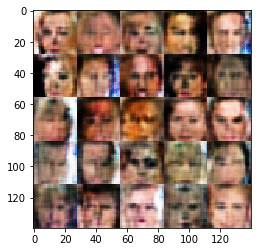

Epoch 1/1 1500... Discriminator Loss: 1.1084... Generator Loss: 0.7795


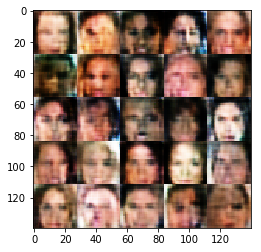

Epoch 1/1 1510... Discriminator Loss: 1.2357... Generator Loss: 1.0824


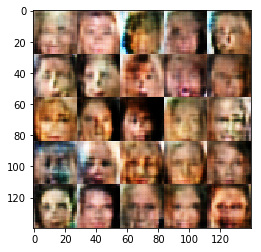

Epoch 1/1 1520... Discriminator Loss: 1.0413... Generator Loss: 1.0316


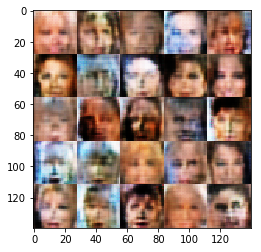

Epoch 1/1 1530... Discriminator Loss: 1.3183... Generator Loss: 1.2918


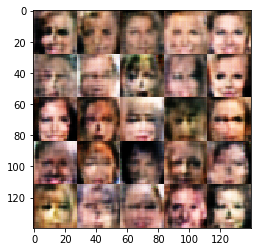

Epoch 1/1 1540... Discriminator Loss: 1.2306... Generator Loss: 0.9491


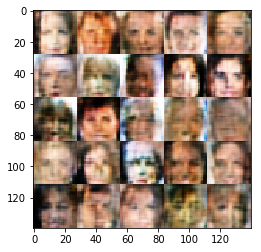

Epoch 1/1 1550... Discriminator Loss: 1.0319... Generator Loss: 1.5595


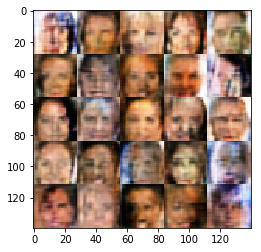

Epoch 1/1 1560... Discriminator Loss: 1.2261... Generator Loss: 0.6597


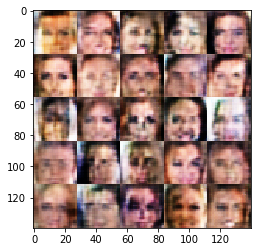

Epoch 1/1 1570... Discriminator Loss: 1.2964... Generator Loss: 0.7948


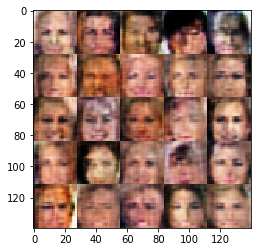

Epoch 1/1 1580... Discriminator Loss: 1.4302... Generator Loss: 0.5060


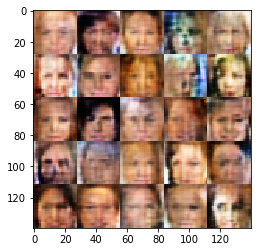

Epoch 1/1 1590... Discriminator Loss: 0.9551... Generator Loss: 1.1198


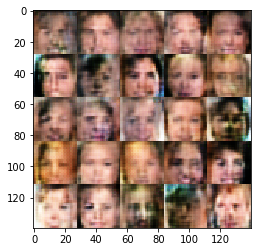

Epoch 1/1 1600... Discriminator Loss: 1.1268... Generator Loss: 0.9043


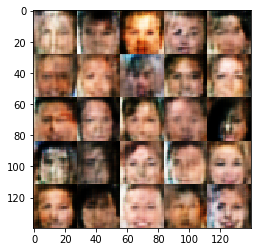

Epoch 1/1 1610... Discriminator Loss: 1.2483... Generator Loss: 1.1213


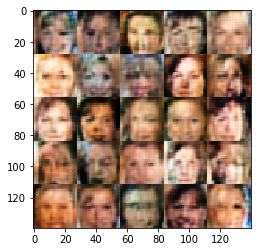

Epoch 1/1 1620... Discriminator Loss: 1.2156... Generator Loss: 1.8068


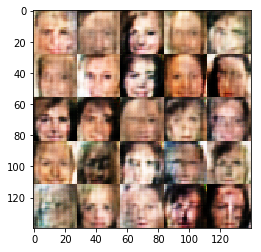

Epoch 1/1 1630... Discriminator Loss: 1.0319... Generator Loss: 0.9955


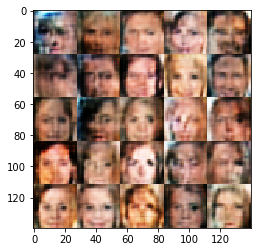

Epoch 1/1 1640... Discriminator Loss: 0.9964... Generator Loss: 0.9586


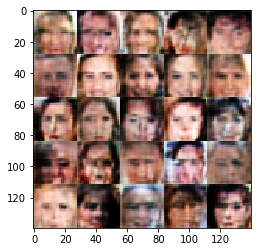

Epoch 1/1 1650... Discriminator Loss: 1.0229... Generator Loss: 1.0736


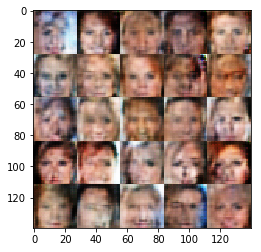

Epoch 1/1 1660... Discriminator Loss: 1.2968... Generator Loss: 0.5544


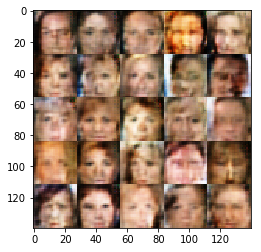

Epoch 1/1 1670... Discriminator Loss: 1.1258... Generator Loss: 0.9579


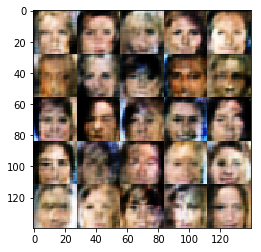

Epoch 1/1 1680... Discriminator Loss: 1.1761... Generator Loss: 1.0731


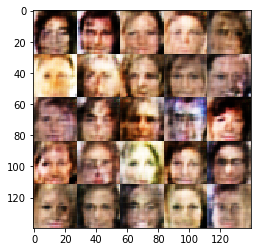

Epoch 1/1 1690... Discriminator Loss: 1.2813... Generator Loss: 0.8203


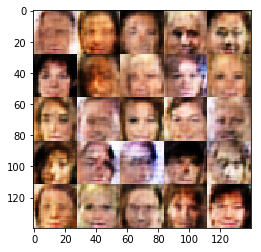

Epoch 1/1 1700... Discriminator Loss: 1.0184... Generator Loss: 0.8936


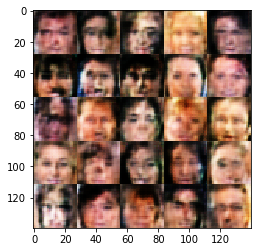

Epoch 1/1 1710... Discriminator Loss: 1.0185... Generator Loss: 1.2037


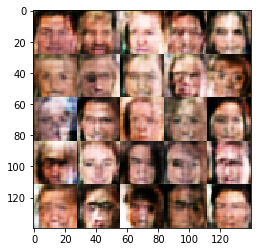

Epoch 1/1 1720... Discriminator Loss: 1.1029... Generator Loss: 0.9988


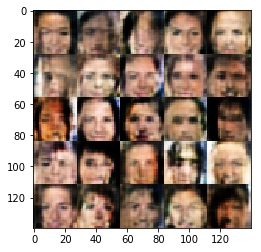

Epoch 1/1 1730... Discriminator Loss: 0.9883... Generator Loss: 0.9699


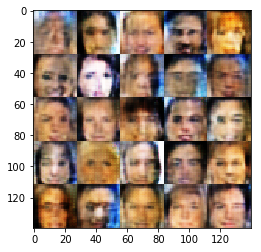

Epoch 1/1 1740... Discriminator Loss: 1.3727... Generator Loss: 0.5830


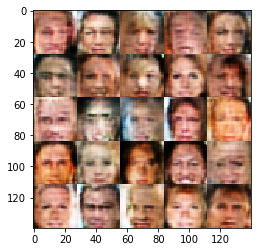

Epoch 1/1 1750... Discriminator Loss: 1.2609... Generator Loss: 0.7592


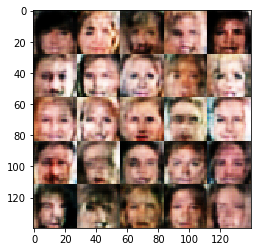

Epoch 1/1 1760... Discriminator Loss: 1.4074... Generator Loss: 0.5322


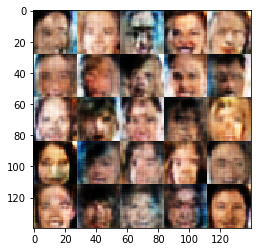

Epoch 1/1 1770... Discriminator Loss: 1.0571... Generator Loss: 1.1208


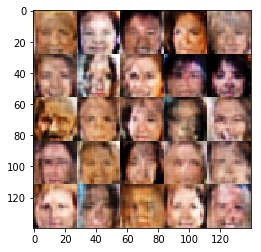

Epoch 1/1 1780... Discriminator Loss: 1.0595... Generator Loss: 1.0573


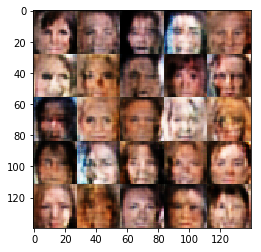

Epoch 1/1 1790... Discriminator Loss: 1.1037... Generator Loss: 0.9013


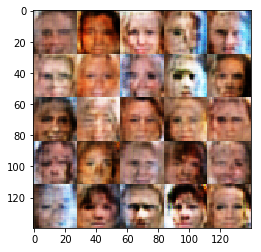

Epoch 1/1 1800... Discriminator Loss: 1.0124... Generator Loss: 1.0781


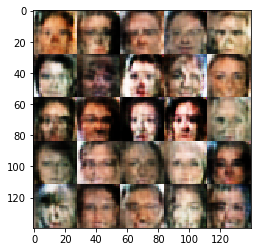

Epoch 1/1 1810... Discriminator Loss: 1.0404... Generator Loss: 1.1957


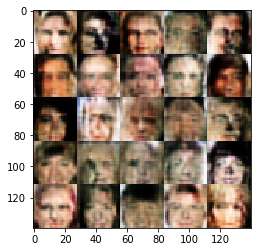

Epoch 1/1 1820... Discriminator Loss: 0.9072... Generator Loss: 1.3233


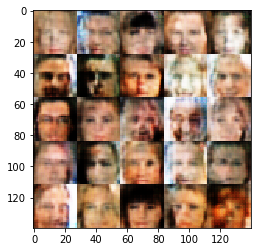

Epoch 1/1 1830... Discriminator Loss: 1.3987... Generator Loss: 0.5956


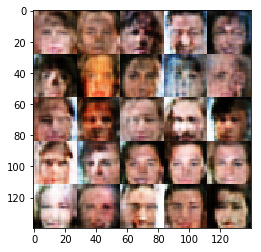

Epoch 1/1 1840... Discriminator Loss: 1.0551... Generator Loss: 0.8540


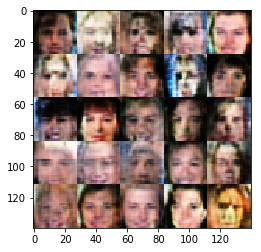

Epoch 1/1 1850... Discriminator Loss: 1.0507... Generator Loss: 1.1905


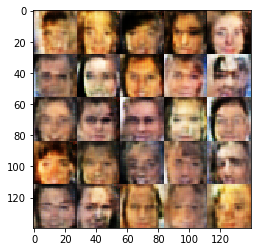

Epoch 1/1 1860... Discriminator Loss: 0.7978... Generator Loss: 1.1782


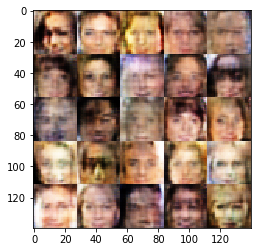

Epoch 1/1 1870... Discriminator Loss: 1.0596... Generator Loss: 1.2033


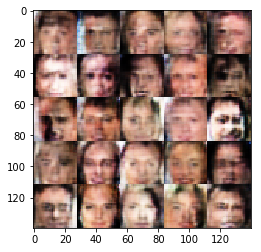

Epoch 1/1 1880... Discriminator Loss: 1.0330... Generator Loss: 0.9033


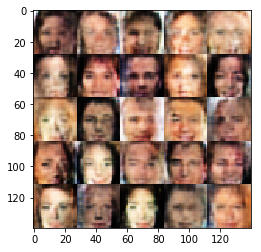

Epoch 1/1 1890... Discriminator Loss: 1.2217... Generator Loss: 0.8961


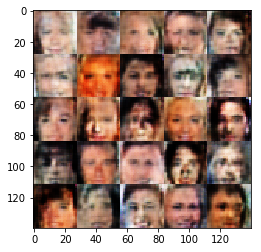

Epoch 1/1 1900... Discriminator Loss: 1.1113... Generator Loss: 0.8139


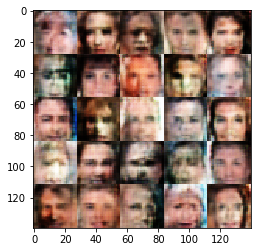

Epoch 1/1 1910... Discriminator Loss: 1.1446... Generator Loss: 1.6165


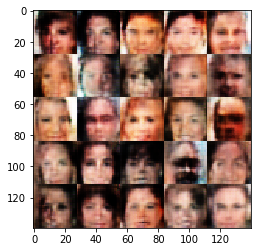

Epoch 1/1 1920... Discriminator Loss: 1.0921... Generator Loss: 1.1604


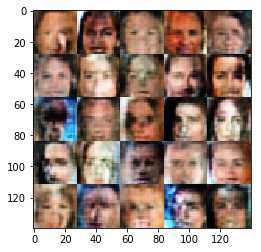

Epoch 1/1 1930... Discriminator Loss: 1.2727... Generator Loss: 0.8232


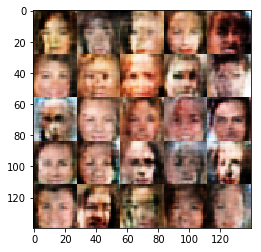

Epoch 1/1 1940... Discriminator Loss: 0.9849... Generator Loss: 1.3283


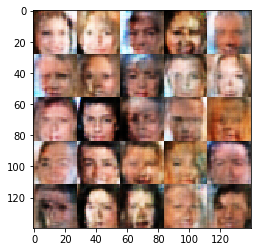

Epoch 1/1 1950... Discriminator Loss: 1.1097... Generator Loss: 0.9721


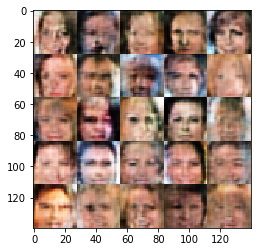

Epoch 1/1 1960... Discriminator Loss: 1.2295... Generator Loss: 0.9212


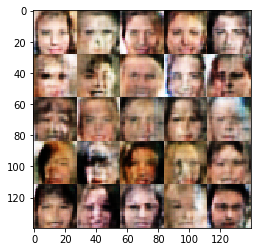

Epoch 1/1 1970... Discriminator Loss: 1.3312... Generator Loss: 0.7284


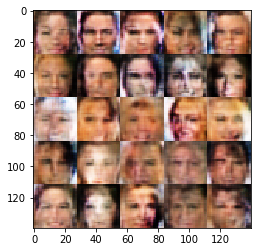

Epoch 1/1 1980... Discriminator Loss: 1.1012... Generator Loss: 0.8893


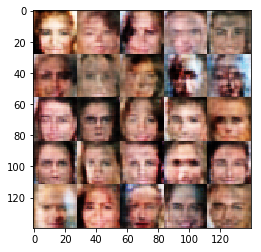

Epoch 1/1 1990... Discriminator Loss: 1.4719... Generator Loss: 0.5158


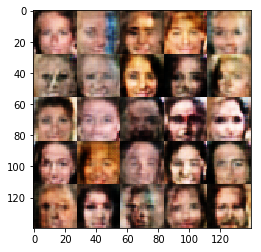

Epoch 1/1 2000... Discriminator Loss: 0.8020... Generator Loss: 1.5235


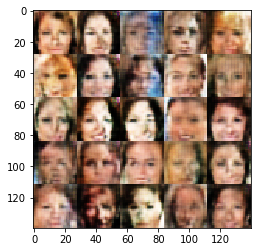

Epoch 1/1 2010... Discriminator Loss: 1.1954... Generator Loss: 0.9270


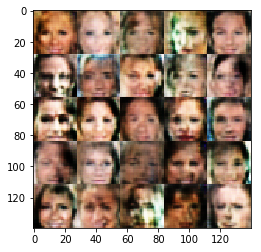

Epoch 1/1 2020... Discriminator Loss: 1.2011... Generator Loss: 0.8179


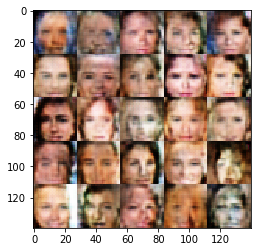

Epoch 1/1 2030... Discriminator Loss: 1.5732... Generator Loss: 0.6750


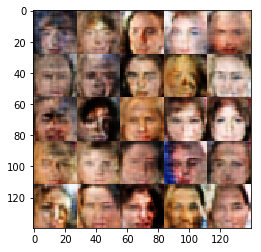

Epoch 1/1 2040... Discriminator Loss: 1.1171... Generator Loss: 1.0405


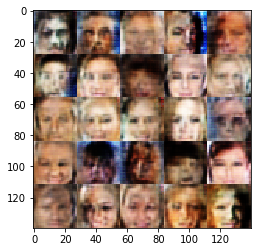

Epoch 1/1 2050... Discriminator Loss: 1.2755... Generator Loss: 0.7504


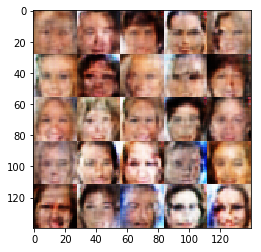

Epoch 1/1 2060... Discriminator Loss: 1.2552... Generator Loss: 0.8459


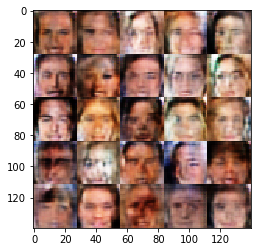

Epoch 1/1 2070... Discriminator Loss: 1.3339... Generator Loss: 0.7175


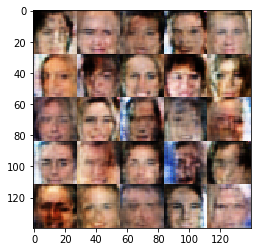

Epoch 1/1 2080... Discriminator Loss: 1.0260... Generator Loss: 1.0243


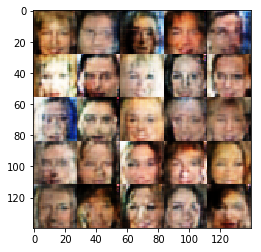

Epoch 1/1 2090... Discriminator Loss: 1.0456... Generator Loss: 1.1711


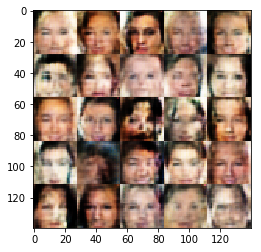

Epoch 1/1 2100... Discriminator Loss: 1.1604... Generator Loss: 0.8226


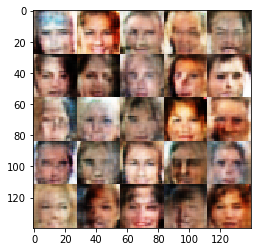

Epoch 1/1 2110... Discriminator Loss: 1.1245... Generator Loss: 0.9043


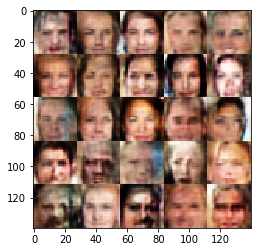

Epoch 1/1 2120... Discriminator Loss: 0.7162... Generator Loss: 1.5368


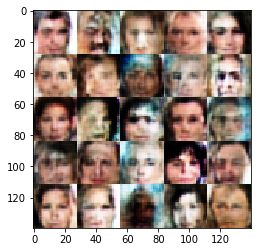

Epoch 1/1 2130... Discriminator Loss: 1.2255... Generator Loss: 1.1913


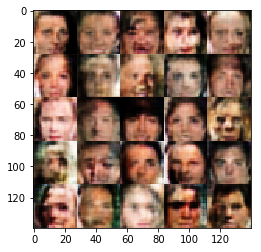

Epoch 1/1 2140... Discriminator Loss: 1.2054... Generator Loss: 0.8668


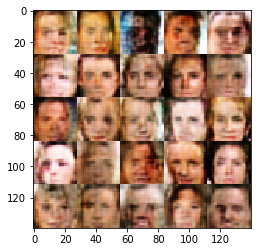

Epoch 1/1 2150... Discriminator Loss: 1.1099... Generator Loss: 1.0665


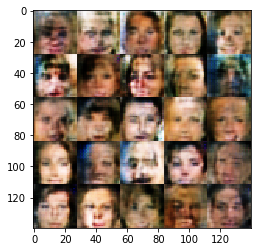

Epoch 1/1 2160... Discriminator Loss: 1.0353... Generator Loss: 0.9332


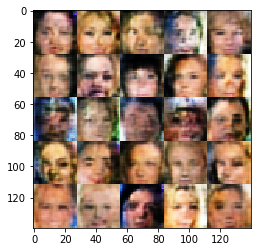

Epoch 1/1 2170... Discriminator Loss: 1.3401... Generator Loss: 0.7556


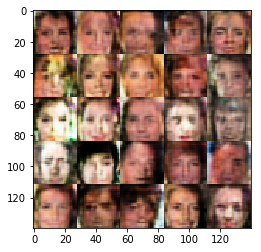

Epoch 1/1 2180... Discriminator Loss: 1.0202... Generator Loss: 1.0470


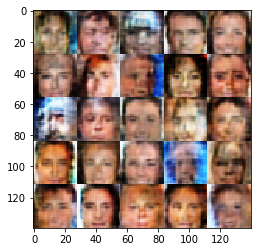

Epoch 1/1 2190... Discriminator Loss: 0.8031... Generator Loss: 1.3280


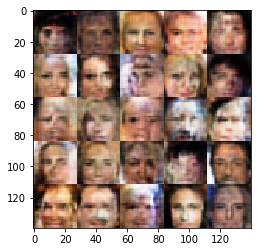

Epoch 1/1 2200... Discriminator Loss: 1.1587... Generator Loss: 0.8255


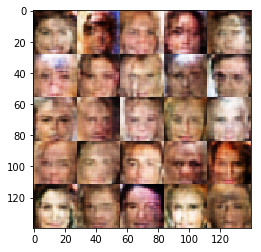

Epoch 1/1 2210... Discriminator Loss: 1.2540... Generator Loss: 0.7074


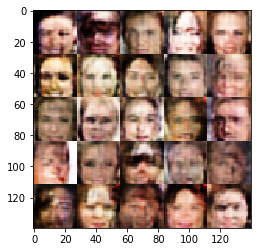

Epoch 1/1 2220... Discriminator Loss: 1.1895... Generator Loss: 1.0878


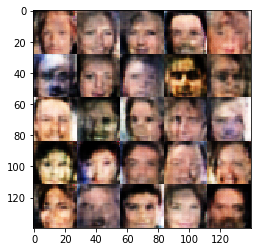

Epoch 1/1 2230... Discriminator Loss: 1.0281... Generator Loss: 1.1305


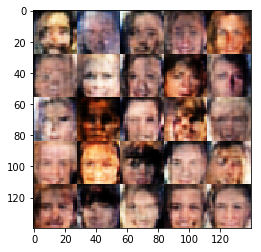

Epoch 1/1 2240... Discriminator Loss: 1.0829... Generator Loss: 0.9868


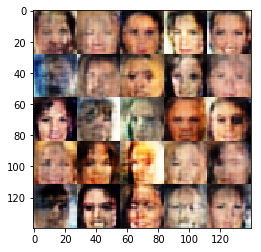

Epoch 1/1 2250... Discriminator Loss: 1.0246... Generator Loss: 0.9176


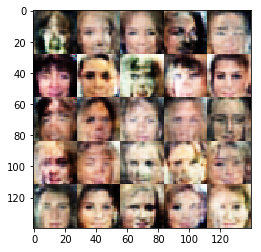

Epoch 1/1 2260... Discriminator Loss: 1.0705... Generator Loss: 0.9702


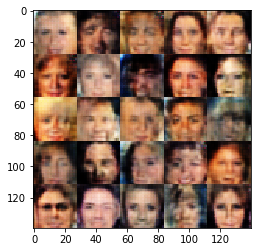

Epoch 1/1 2270... Discriminator Loss: 1.3245... Generator Loss: 0.8481


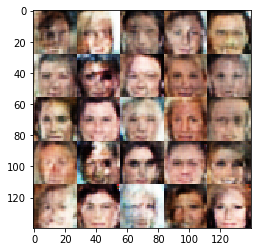

Epoch 1/1 2280... Discriminator Loss: 0.9542... Generator Loss: 1.2211


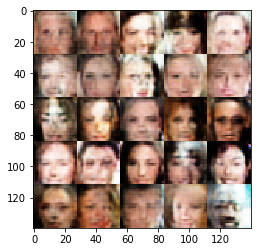

Epoch 1/1 2290... Discriminator Loss: 1.1479... Generator Loss: 0.8880


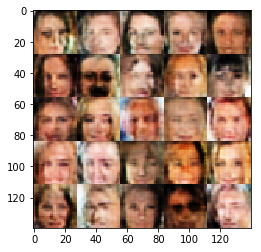

Epoch 1/1 2300... Discriminator Loss: 1.0079... Generator Loss: 1.0235


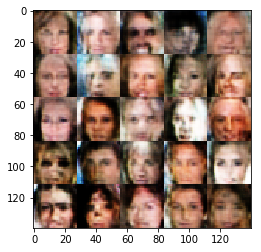

Epoch 1/1 2310... Discriminator Loss: 1.0900... Generator Loss: 1.0359


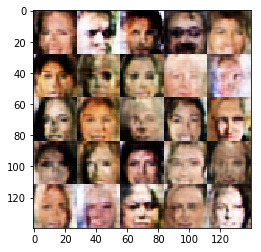

Epoch 1/1 2320... Discriminator Loss: 1.4476... Generator Loss: 0.7779


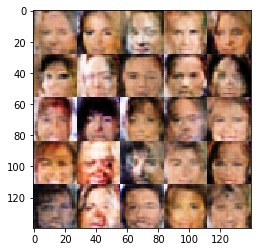

Epoch 1/1 2330... Discriminator Loss: 0.9591... Generator Loss: 1.0955


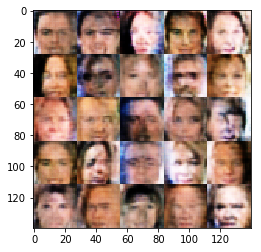

Epoch 1/1 2340... Discriminator Loss: 1.2216... Generator Loss: 0.8018


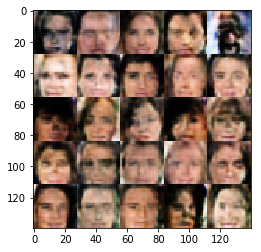

Epoch 1/1 2350... Discriminator Loss: 1.1136... Generator Loss: 0.8827


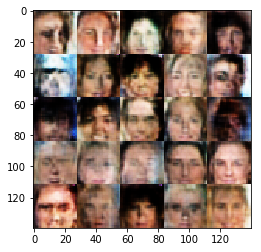

Epoch 1/1 2360... Discriminator Loss: 1.2416... Generator Loss: 0.7466


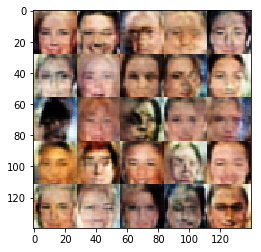

Epoch 1/1 2370... Discriminator Loss: 1.0880... Generator Loss: 0.7904


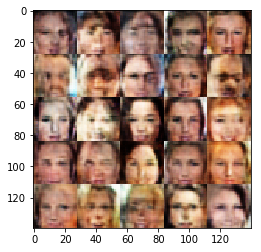

Epoch 1/1 2380... Discriminator Loss: 0.9117... Generator Loss: 1.1563


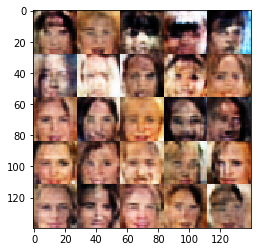

Epoch 1/1 2390... Discriminator Loss: 0.9671... Generator Loss: 0.8712


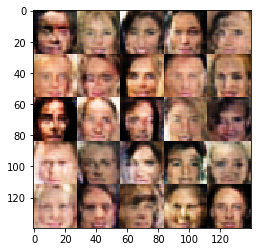

Epoch 1/1 2400... Discriminator Loss: 1.0001... Generator Loss: 0.8863


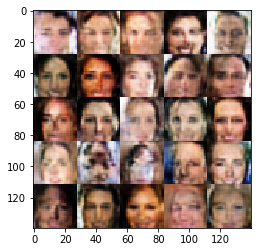

Epoch 1/1 2410... Discriminator Loss: 0.9382... Generator Loss: 1.1408


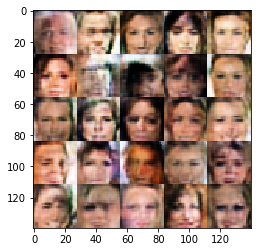

Epoch 1/1 2420... Discriminator Loss: 1.2725... Generator Loss: 1.3620


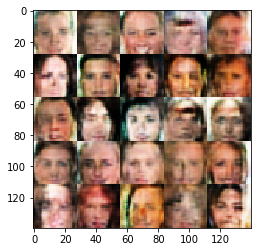

Epoch 1/1 2430... Discriminator Loss: 1.1085... Generator Loss: 1.3113


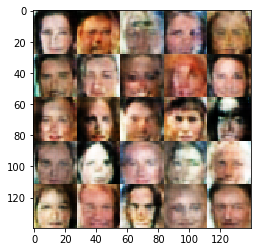

Epoch 1/1 2440... Discriminator Loss: 0.9331... Generator Loss: 0.9487


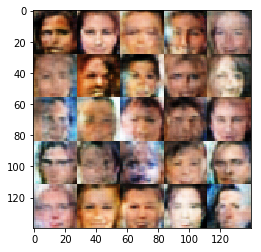

Epoch 1/1 2450... Discriminator Loss: 1.1232... Generator Loss: 1.0708


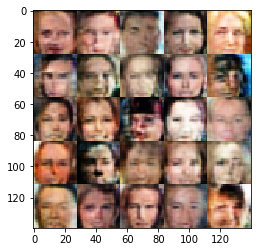

Epoch 1/1 2460... Discriminator Loss: 1.4902... Generator Loss: 0.4610


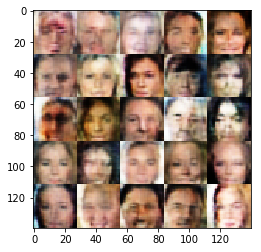

Epoch 1/1 2470... Discriminator Loss: 0.8396... Generator Loss: 1.6691


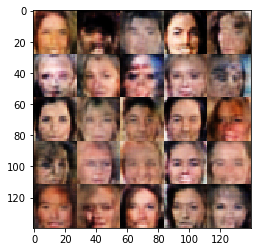

Epoch 1/1 2480... Discriminator Loss: 1.0743... Generator Loss: 0.8932


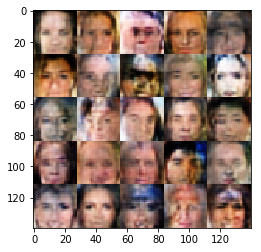

Epoch 1/1 2490... Discriminator Loss: 0.9600... Generator Loss: 0.9474


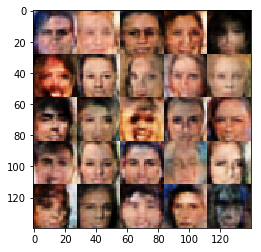

Epoch 1/1 2500... Discriminator Loss: 1.2517... Generator Loss: 0.8785


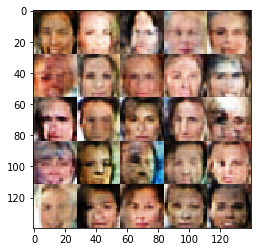

Epoch 1/1 2510... Discriminator Loss: 1.2214... Generator Loss: 0.5773


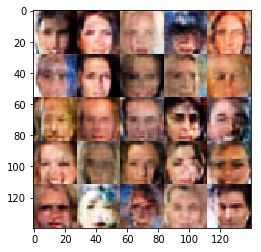

Epoch 1/1 2520... Discriminator Loss: 0.9155... Generator Loss: 0.9548


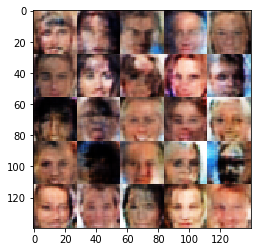

Epoch 1/1 2530... Discriminator Loss: 1.0554... Generator Loss: 0.8819


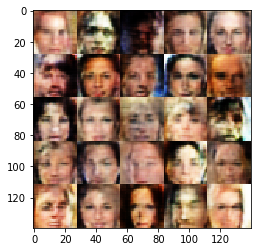

Epoch 1/1 2540... Discriminator Loss: 1.0147... Generator Loss: 1.0525


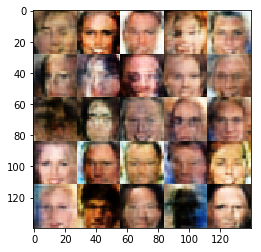

Epoch 1/1 2550... Discriminator Loss: 1.1681... Generator Loss: 0.8230


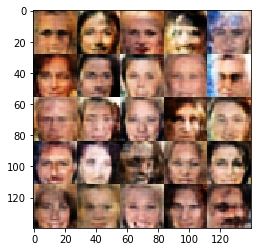

Epoch 1/1 2560... Discriminator Loss: 1.1986... Generator Loss: 0.8542


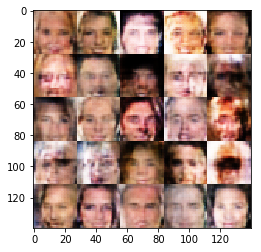

Epoch 1/1 2570... Discriminator Loss: 1.0213... Generator Loss: 1.0398


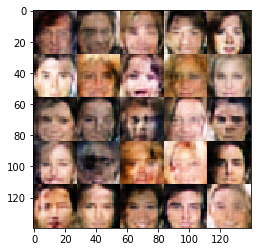

Epoch 1/1 2580... Discriminator Loss: 1.1210... Generator Loss: 1.0082


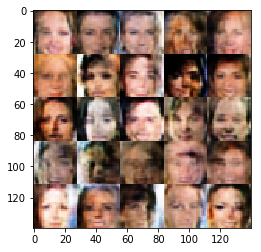

Epoch 1/1 2590... Discriminator Loss: 1.0738... Generator Loss: 0.8429


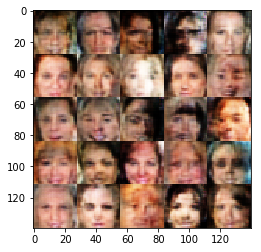

Epoch 1/1 2600... Discriminator Loss: 2.1166... Generator Loss: 1.6147


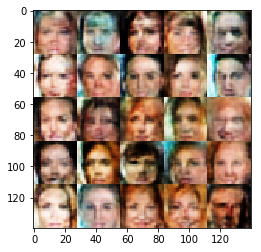

Epoch 1/1 2610... Discriminator Loss: 1.1058... Generator Loss: 0.9866


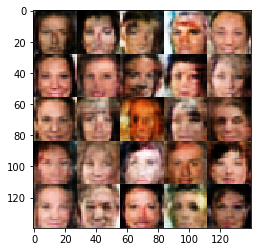

Epoch 1/1 2620... Discriminator Loss: 1.4888... Generator Loss: 0.5594


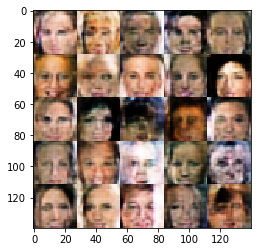

Epoch 1/1 2630... Discriminator Loss: 1.0012... Generator Loss: 1.0634


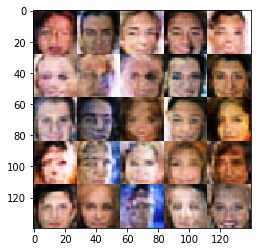

Epoch 1/1 2640... Discriminator Loss: 1.1532... Generator Loss: 0.8237


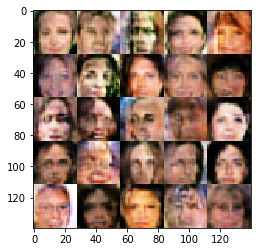

Epoch 1/1 2650... Discriminator Loss: 1.2550... Generator Loss: 0.6361


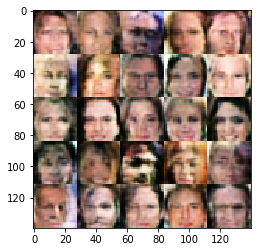

Epoch 1/1 2660... Discriminator Loss: 1.1126... Generator Loss: 1.0425


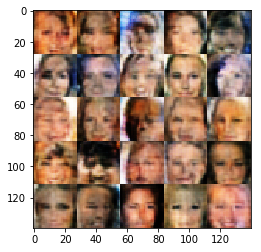

Epoch 1/1 2670... Discriminator Loss: 1.0442... Generator Loss: 0.9728


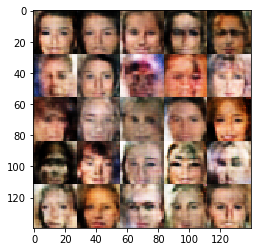

Epoch 1/1 2680... Discriminator Loss: 1.2091... Generator Loss: 0.9300


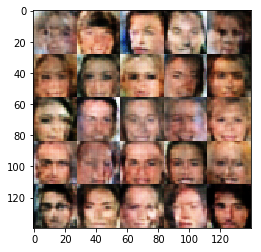

Epoch 1/1 2690... Discriminator Loss: 0.9688... Generator Loss: 1.2047


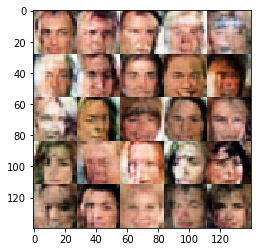

Epoch 1/1 2700... Discriminator Loss: 0.9814... Generator Loss: 1.2524


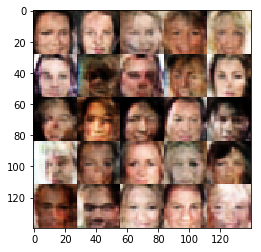

Epoch 1/1 2710... Discriminator Loss: 0.9687... Generator Loss: 1.1516


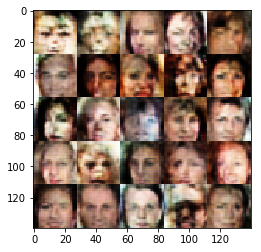

Epoch 1/1 2720... Discriminator Loss: 1.3276... Generator Loss: 0.7137


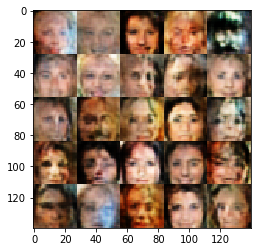

Epoch 1/1 2730... Discriminator Loss: 1.0956... Generator Loss: 0.8412


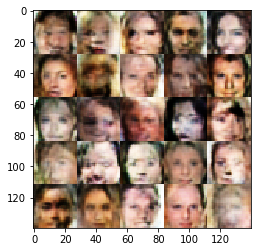

Epoch 1/1 2740... Discriminator Loss: 1.4306... Generator Loss: 0.4843


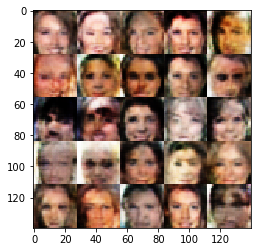

Epoch 1/1 2750... Discriminator Loss: 1.2545... Generator Loss: 1.0252


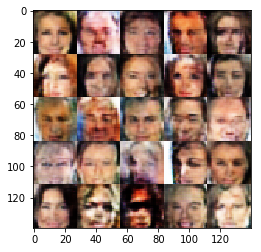

Epoch 1/1 2760... Discriminator Loss: 1.4500... Generator Loss: 0.4898


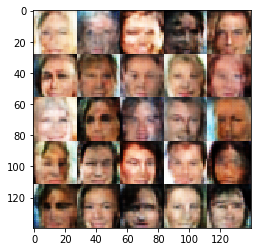

Epoch 1/1 2770... Discriminator Loss: 1.2860... Generator Loss: 1.5218


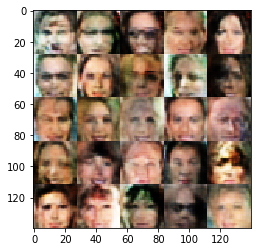

Epoch 1/1 2780... Discriminator Loss: 1.2819... Generator Loss: 0.5708


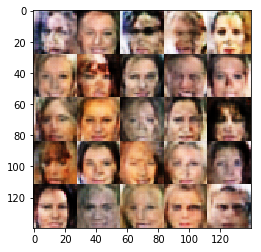

Epoch 1/1 2790... Discriminator Loss: 0.8926... Generator Loss: 1.3451


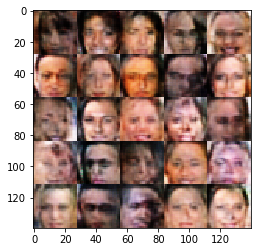

Epoch 1/1 2800... Discriminator Loss: 1.0887... Generator Loss: 1.0790


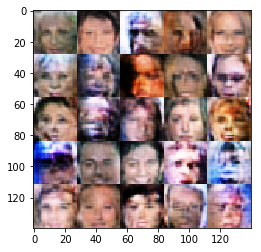

Epoch 1/1 2810... Discriminator Loss: 0.9553... Generator Loss: 1.0632


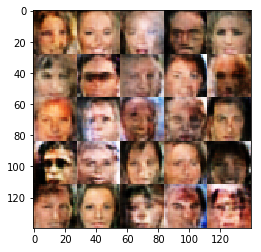

Epoch 1/1 2820... Discriminator Loss: 0.8072... Generator Loss: 1.0688


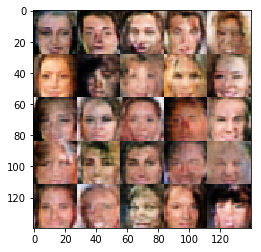

Epoch 1/1 2830... Discriminator Loss: 1.2968... Generator Loss: 0.6639


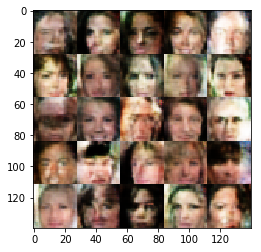

Epoch 1/1 2840... Discriminator Loss: 0.9719... Generator Loss: 1.2996


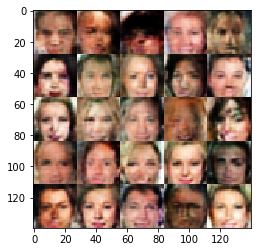

Epoch 1/1 2850... Discriminator Loss: 0.8141... Generator Loss: 1.6354


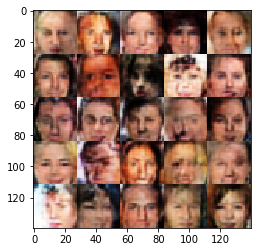

Epoch 1/1 2860... Discriminator Loss: 1.2206... Generator Loss: 0.7992


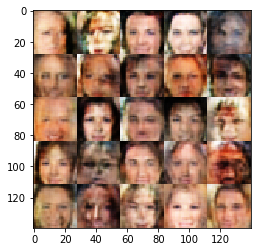

Epoch 1/1 2870... Discriminator Loss: 1.3040... Generator Loss: 0.5385


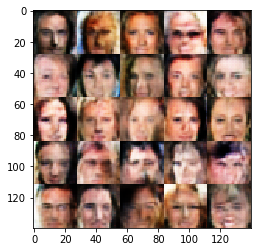

Epoch 1/1 2880... Discriminator Loss: 1.1169... Generator Loss: 0.8614


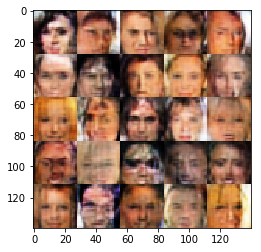

Epoch 1/1 2890... Discriminator Loss: 1.0798... Generator Loss: 0.8220


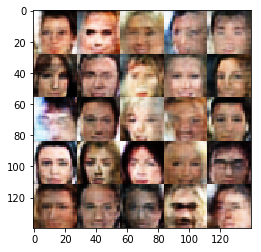

Epoch 1/1 2900... Discriminator Loss: 1.1270... Generator Loss: 0.7710


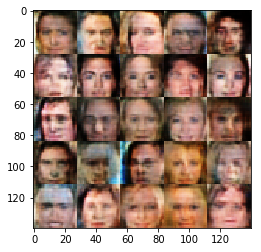

Epoch 1/1 2910... Discriminator Loss: 1.2057... Generator Loss: 0.6158


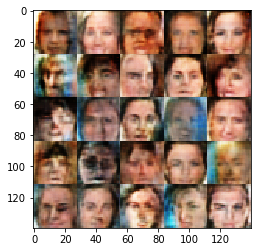

Epoch 1/1 2920... Discriminator Loss: 1.1224... Generator Loss: 0.9018


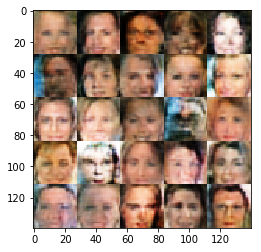

Epoch 1/1 2930... Discriminator Loss: 0.9614... Generator Loss: 1.1404


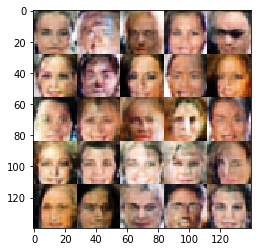

Epoch 1/1 2940... Discriminator Loss: 1.0775... Generator Loss: 1.0552


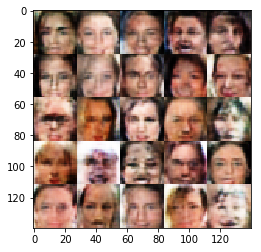

Epoch 1/1 2950... Discriminator Loss: 0.9864... Generator Loss: 1.0781


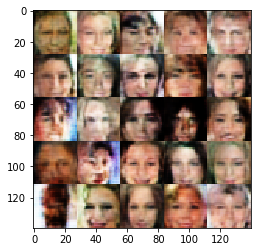

Epoch 1/1 2960... Discriminator Loss: 1.1563... Generator Loss: 0.7243


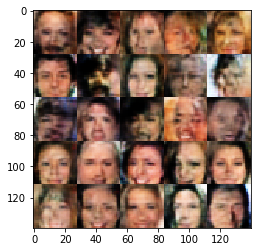

Epoch 1/1 2970... Discriminator Loss: 0.9365... Generator Loss: 1.1046


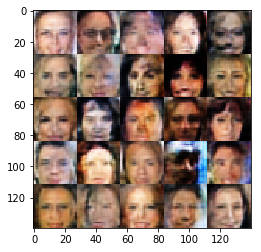

Epoch 1/1 2980... Discriminator Loss: 1.3122... Generator Loss: 0.5645


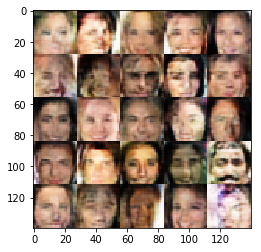

Epoch 1/1 2990... Discriminator Loss: 1.2749... Generator Loss: 0.6316


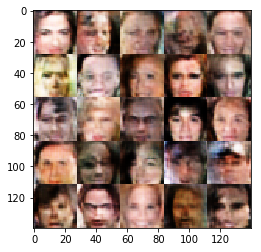

Epoch 1/1 3000... Discriminator Loss: 1.1850... Generator Loss: 0.9261


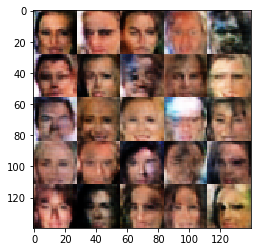

Epoch 1/1 3010... Discriminator Loss: 1.0210... Generator Loss: 1.2168


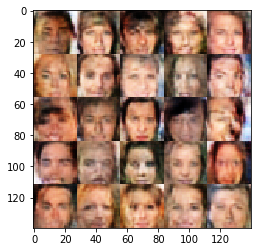

Epoch 1/1 3020... Discriminator Loss: 1.2403... Generator Loss: 0.6373


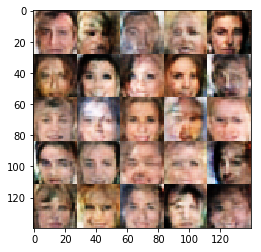

Epoch 1/1 3030... Discriminator Loss: 1.2645... Generator Loss: 1.3456


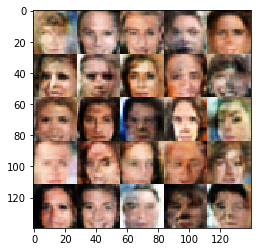

Epoch 1/1 3040... Discriminator Loss: 0.7777... Generator Loss: 1.3915


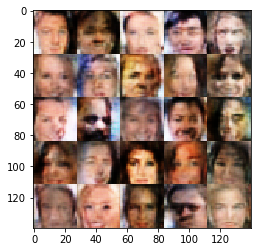

Epoch 1/1 3050... Discriminator Loss: 1.0881... Generator Loss: 1.0644


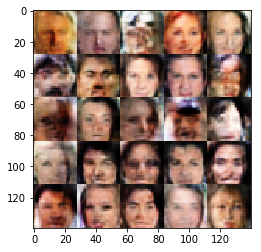

Epoch 1/1 3060... Discriminator Loss: 1.0334... Generator Loss: 1.0459


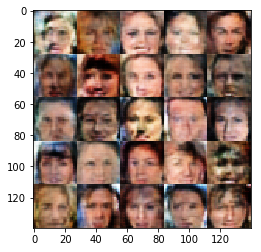

Epoch 1/1 3070... Discriminator Loss: 0.9181... Generator Loss: 0.9580


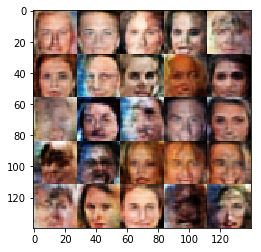

Epoch 1/1 3080... Discriminator Loss: 1.0662... Generator Loss: 0.8269


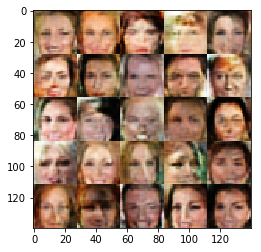

Epoch 1/1 3090... Discriminator Loss: 0.9662... Generator Loss: 1.5117


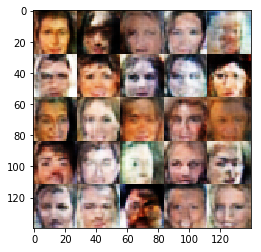

Epoch 1/1 3100... Discriminator Loss: 0.9553... Generator Loss: 1.3497


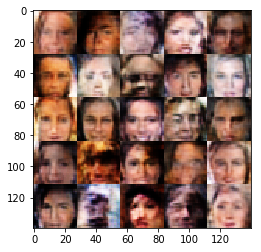

Epoch 1/1 3110... Discriminator Loss: 1.2169... Generator Loss: 0.8358


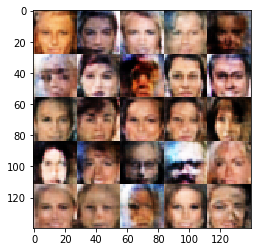

Epoch 1/1 3120... Discriminator Loss: 1.0734... Generator Loss: 1.1890


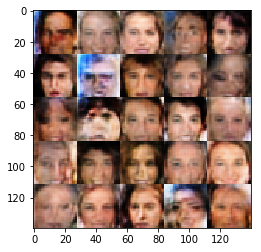

Epoch 1/1 3130... Discriminator Loss: 0.8214... Generator Loss: 1.7209


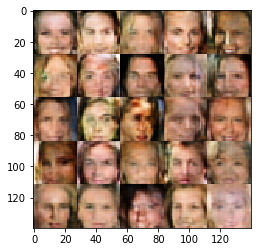

Epoch 1/1 3140... Discriminator Loss: 1.2014... Generator Loss: 0.7802


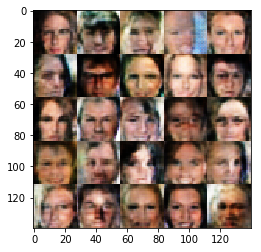

Epoch 1/1 3150... Discriminator Loss: 1.2245... Generator Loss: 0.6785


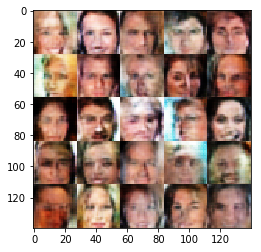

Epoch 1/1 3160... Discriminator Loss: 0.8449... Generator Loss: 1.1579


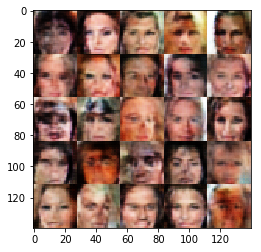

Epoch 1/1 3170... Discriminator Loss: 1.3415... Generator Loss: 1.0600


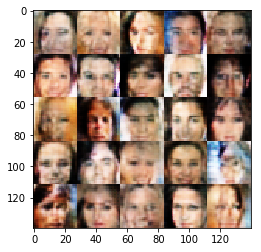

Epoch 1/1 3180... Discriminator Loss: 1.1457... Generator Loss: 0.8062


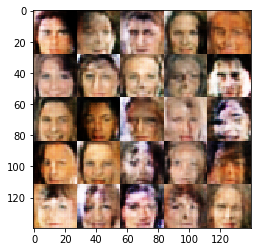

Epoch 1/1 3190... Discriminator Loss: 1.1478... Generator Loss: 0.7430


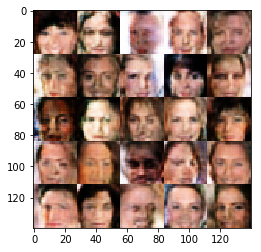

Epoch 1/1 3200... Discriminator Loss: 0.9431... Generator Loss: 0.8978


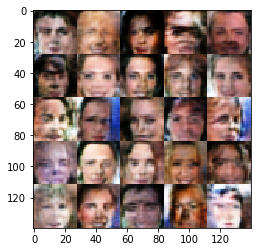

Epoch 1/1 3210... Discriminator Loss: 0.8585... Generator Loss: 1.3023


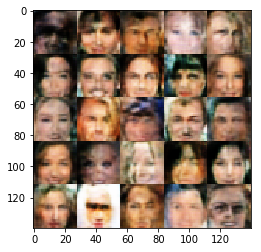

Epoch 1/1 3220... Discriminator Loss: 0.8220... Generator Loss: 1.3994


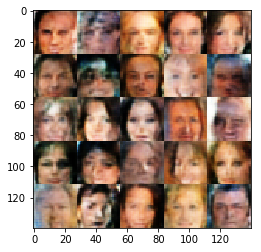

Epoch 1/1 3230... Discriminator Loss: 1.1895... Generator Loss: 1.3197


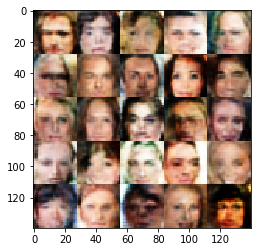

Epoch 1/1 3240... Discriminator Loss: 0.9630... Generator Loss: 1.0560


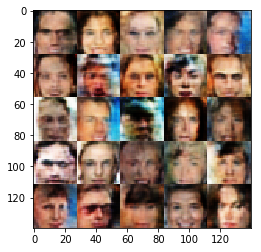

Epoch 1/1 3250... Discriminator Loss: 1.1002... Generator Loss: 1.3742


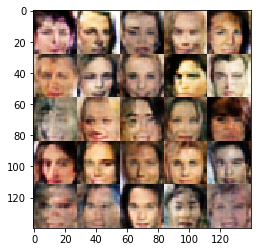

Epoch 1/1 3260... Discriminator Loss: 1.0743... Generator Loss: 1.1904


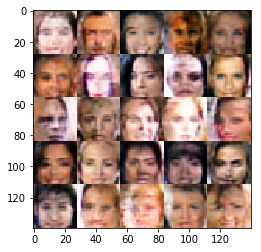

Epoch 1/1 3270... Discriminator Loss: 1.0052... Generator Loss: 1.2374


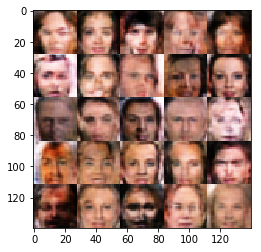

Epoch 1/1 3280... Discriminator Loss: 0.8637... Generator Loss: 1.3258


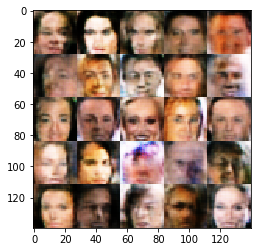

Epoch 1/1 3290... Discriminator Loss: 0.6474... Generator Loss: 1.6269


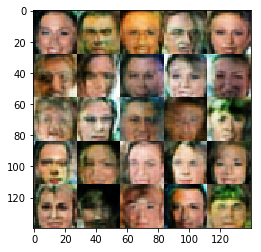

Epoch 1/1 3300... Discriminator Loss: 1.1422... Generator Loss: 0.6741


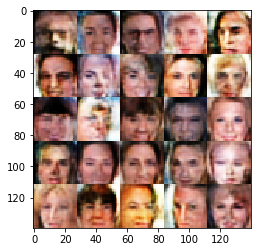

Epoch 1/1 3310... Discriminator Loss: 1.1549... Generator Loss: 0.8771


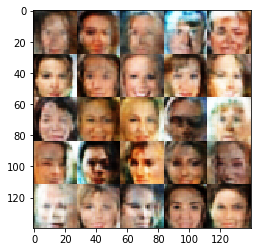

Epoch 1/1 3320... Discriminator Loss: 1.1486... Generator Loss: 1.2285


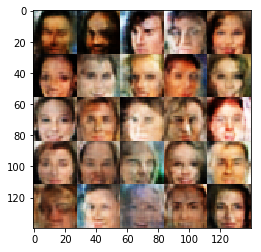

Epoch 1/1 3330... Discriminator Loss: 0.7329... Generator Loss: 1.3605


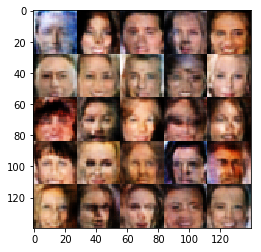

Epoch 1/1 3340... Discriminator Loss: 1.1454... Generator Loss: 0.7406


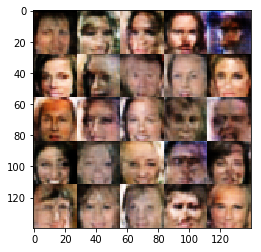

Epoch 1/1 3350... Discriminator Loss: 0.9968... Generator Loss: 0.8729


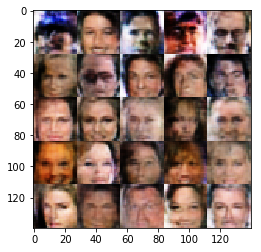

Epoch 1/1 3360... Discriminator Loss: 0.8411... Generator Loss: 1.1006


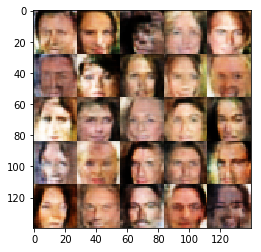

Epoch 1/1 3370... Discriminator Loss: 0.9790... Generator Loss: 0.8998


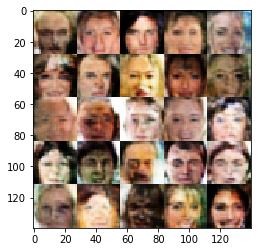

Epoch 1/1 3380... Discriminator Loss: 1.0040... Generator Loss: 0.8355


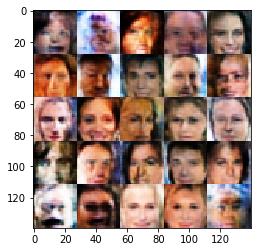

Epoch 1/1 3390... Discriminator Loss: 1.2434... Generator Loss: 0.8491


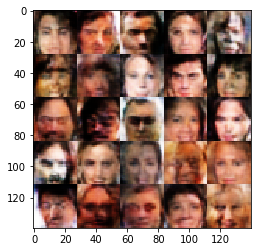

Epoch 1/1 3400... Discriminator Loss: 1.1372... Generator Loss: 0.8048


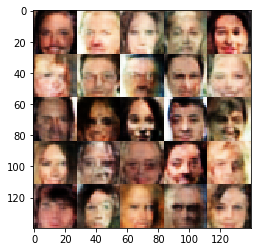

Epoch 1/1 3410... Discriminator Loss: 0.9779... Generator Loss: 1.0192


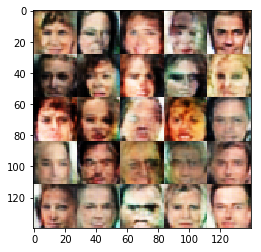

Epoch 1/1 3420... Discriminator Loss: 0.9991... Generator Loss: 1.1779


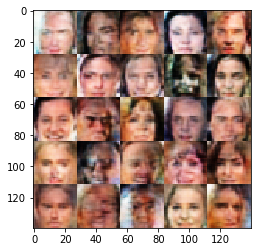

Epoch 1/1 3430... Discriminator Loss: 1.0964... Generator Loss: 0.8751


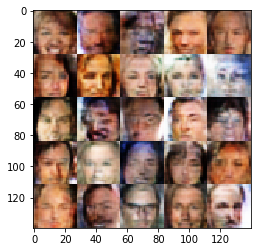

Epoch 1/1 3440... Discriminator Loss: 0.9081... Generator Loss: 1.2451


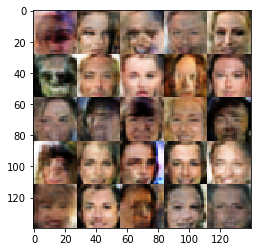

Epoch 1/1 3450... Discriminator Loss: 1.0890... Generator Loss: 0.8630


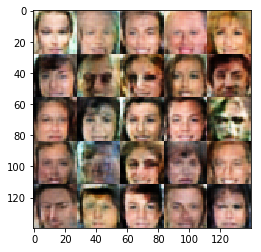

Epoch 1/1 3460... Discriminator Loss: 1.1083... Generator Loss: 2.1205


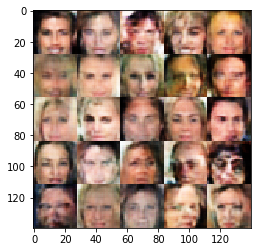

Epoch 1/1 3470... Discriminator Loss: 1.0159... Generator Loss: 0.8986


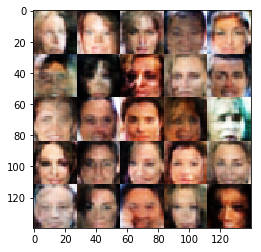

Epoch 1/1 3480... Discriminator Loss: 0.9712... Generator Loss: 1.3646


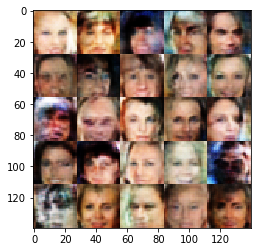

Epoch 1/1 3490... Discriminator Loss: 1.0775... Generator Loss: 0.9883


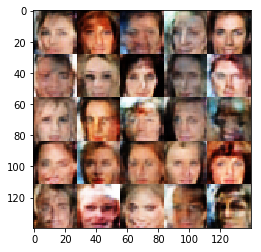

Epoch 1/1 3500... Discriminator Loss: 1.1156... Generator Loss: 1.0005


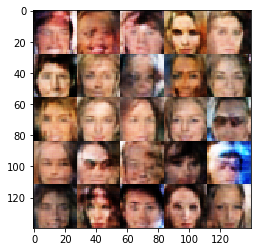

Epoch 1/1 3510... Discriminator Loss: 1.2644... Generator Loss: 1.3754


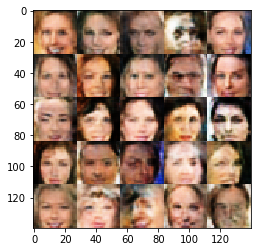

Epoch 1/1 3520... Discriminator Loss: 1.2289... Generator Loss: 0.6145


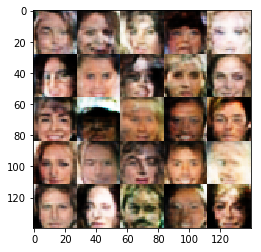

Epoch 1/1 3530... Discriminator Loss: 1.1061... Generator Loss: 0.8574


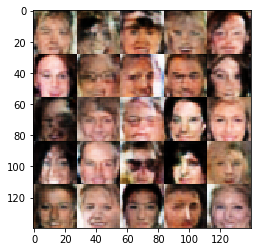

Epoch 1/1 3540... Discriminator Loss: 0.9191... Generator Loss: 1.0629


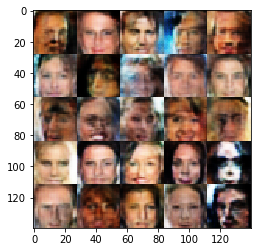

Epoch 1/1 3550... Discriminator Loss: 0.8697... Generator Loss: 1.3558


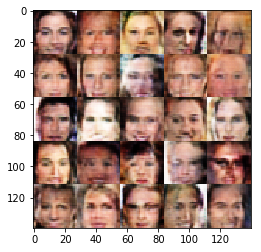

Epoch 1/1 3560... Discriminator Loss: 1.2650... Generator Loss: 0.6693


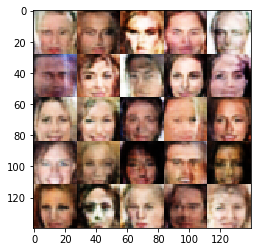

Epoch 1/1 3570... Discriminator Loss: 1.0240... Generator Loss: 0.9793


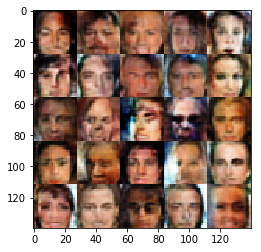

Epoch 1/1 3580... Discriminator Loss: 1.0608... Generator Loss: 0.8594


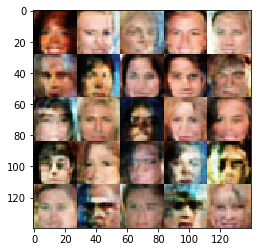

Epoch 1/1 3590... Discriminator Loss: 1.0076... Generator Loss: 1.8062


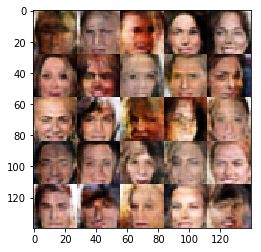

Epoch 1/1 3600... Discriminator Loss: 1.1812... Generator Loss: 0.6653


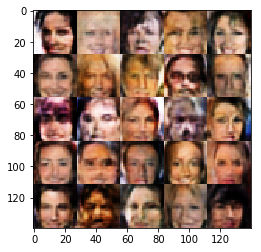

Epoch 1/1 3610... Discriminator Loss: 1.3271... Generator Loss: 0.5618


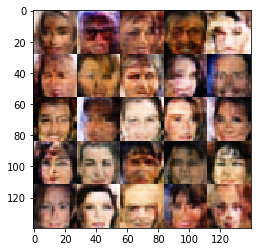

Epoch 1/1 3620... Discriminator Loss: 0.9989... Generator Loss: 1.1504


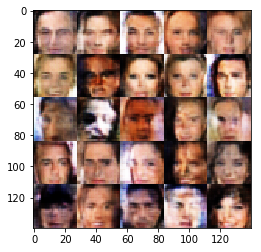

Epoch 1/1 3630... Discriminator Loss: 0.9524... Generator Loss: 1.1693


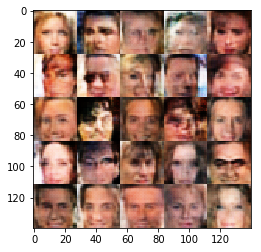

Epoch 1/1 3640... Discriminator Loss: 1.1655... Generator Loss: 0.9051


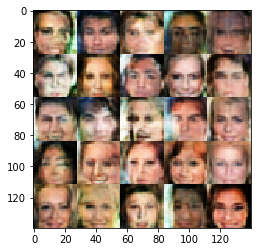

Epoch 1/1 3650... Discriminator Loss: 1.0762... Generator Loss: 0.8686


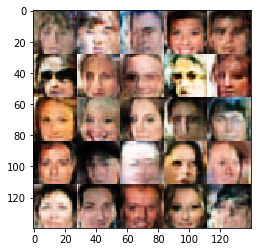

Epoch 1/1 3660... Discriminator Loss: 1.1694... Generator Loss: 0.8902


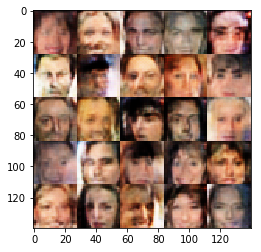

Epoch 1/1 3670... Discriminator Loss: 1.0304... Generator Loss: 0.9922


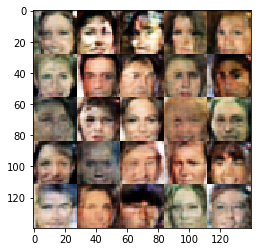

Epoch 1/1 3680... Discriminator Loss: 0.9235... Generator Loss: 1.1500


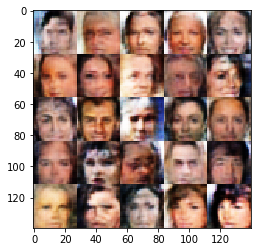

Epoch 1/1 3690... Discriminator Loss: 1.1569... Generator Loss: 1.0038


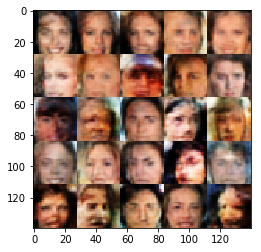

Epoch 1/1 3700... Discriminator Loss: 0.9328... Generator Loss: 0.9595


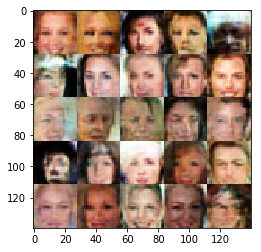

Epoch 1/1 3710... Discriminator Loss: 1.2828... Generator Loss: 0.7063


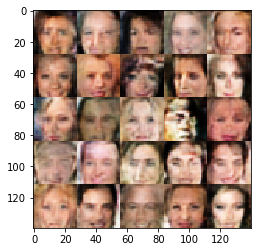

Epoch 1/1 3720... Discriminator Loss: 0.8719... Generator Loss: 1.2880


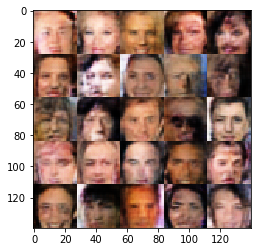

Epoch 1/1 3730... Discriminator Loss: 0.9994... Generator Loss: 1.0282


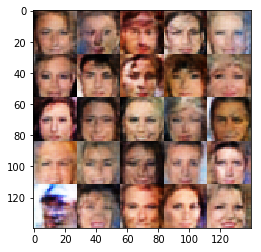

Epoch 1/1 3740... Discriminator Loss: 1.2108... Generator Loss: 0.8316


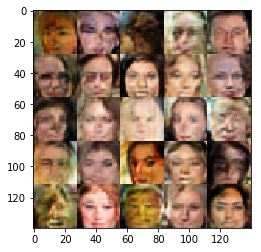

Epoch 1/1 3750... Discriminator Loss: 0.9562... Generator Loss: 1.2562


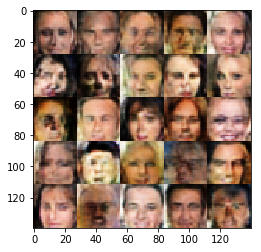

Epoch 1/1 3760... Discriminator Loss: 0.8489... Generator Loss: 1.3267


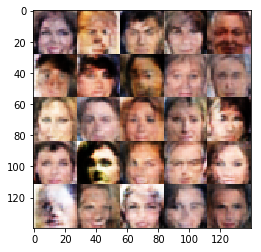

Epoch 1/1 3770... Discriminator Loss: 1.2697... Generator Loss: 0.8451


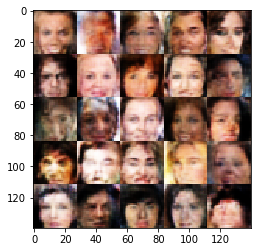

Epoch 1/1 3780... Discriminator Loss: 1.0683... Generator Loss: 0.9080


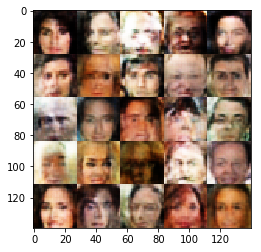

Epoch 1/1 3790... Discriminator Loss: 0.9339... Generator Loss: 0.9477


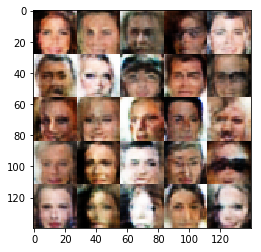

Epoch 1/1 3800... Discriminator Loss: 1.3236... Generator Loss: 0.8115


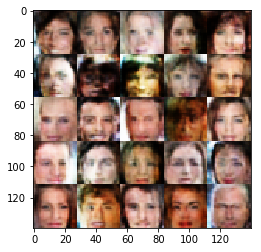

Epoch 1/1 3810... Discriminator Loss: 1.0161... Generator Loss: 1.2256


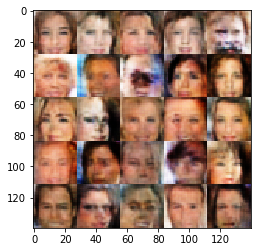

Epoch 1/1 3820... Discriminator Loss: 0.9797... Generator Loss: 1.3303


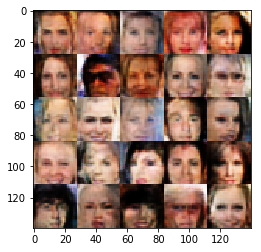

Epoch 1/1 3830... Discriminator Loss: 1.1531... Generator Loss: 0.6257


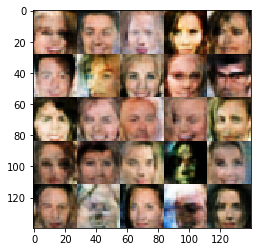

Epoch 1/1 3840... Discriminator Loss: 0.7453... Generator Loss: 1.5367


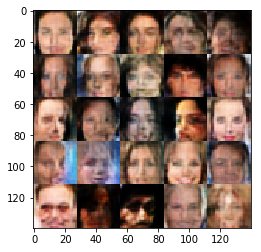

Epoch 1/1 3850... Discriminator Loss: 0.8656... Generator Loss: 1.9927


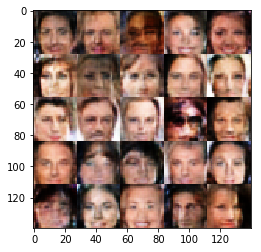

Epoch 1/1 3860... Discriminator Loss: 1.3037... Generator Loss: 1.0789


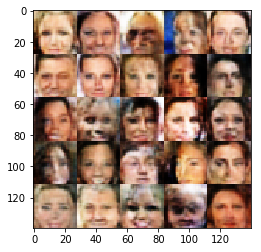

Epoch 1/1 3870... Discriminator Loss: 0.9577... Generator Loss: 1.0617


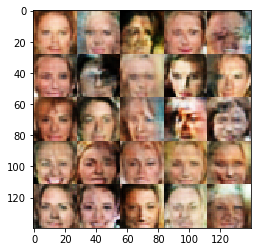

Epoch 1/1 3880... Discriminator Loss: 1.1694... Generator Loss: 0.9233


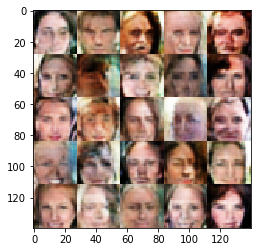

Epoch 1/1 3890... Discriminator Loss: 1.0987... Generator Loss: 1.1616


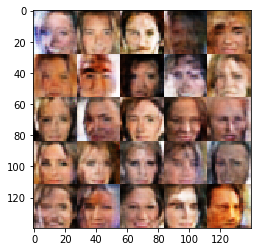

Epoch 1/1 3900... Discriminator Loss: 1.4000... Generator Loss: 0.6534


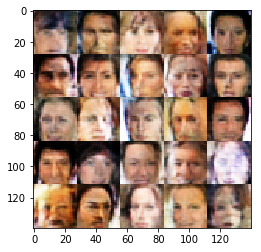

Epoch 1/1 3910... Discriminator Loss: 0.9737... Generator Loss: 1.3132


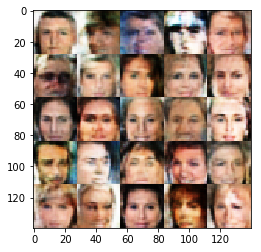

Epoch 1/1 3920... Discriminator Loss: 1.3069... Generator Loss: 0.9281


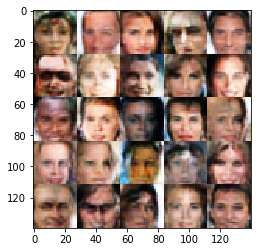

Epoch 1/1 3930... Discriminator Loss: 0.8951... Generator Loss: 0.9276


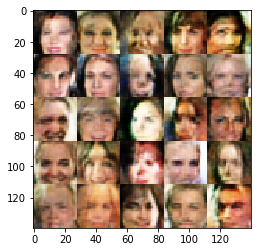

Epoch 1/1 3940... Discriminator Loss: 1.0650... Generator Loss: 1.0587


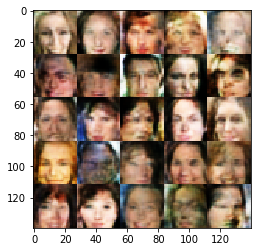

Epoch 1/1 3950... Discriminator Loss: 0.9577... Generator Loss: 0.8260


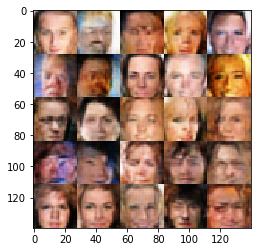

Epoch 1/1 3960... Discriminator Loss: 1.0620... Generator Loss: 1.7250


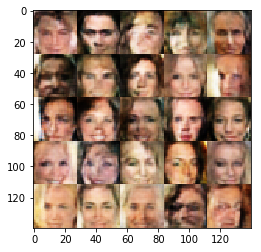

Epoch 1/1 3970... Discriminator Loss: 1.0400... Generator Loss: 0.8921


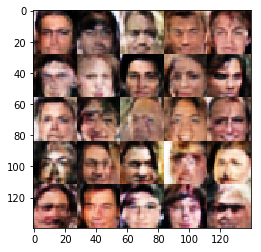

Epoch 1/1 3980... Discriminator Loss: 0.9897... Generator Loss: 0.9206


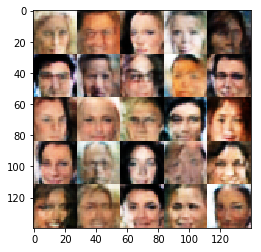

Epoch 1/1 3990... Discriminator Loss: 0.8672... Generator Loss: 1.2974


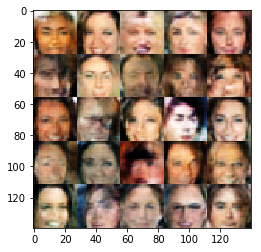

Epoch 1/1 4000... Discriminator Loss: 1.2762... Generator Loss: 0.6675


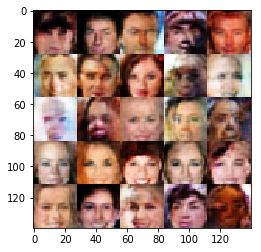

Epoch 1/1 4010... Discriminator Loss: 0.7091... Generator Loss: 1.2485


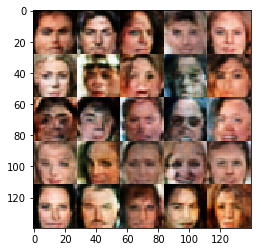

Epoch 1/1 4020... Discriminator Loss: 1.9266... Generator Loss: 3.1936


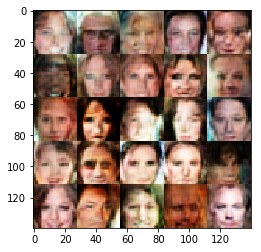

Epoch 1/1 4030... Discriminator Loss: 0.9591... Generator Loss: 1.2643


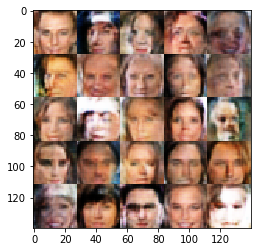

Epoch 1/1 4040... Discriminator Loss: 0.9862... Generator Loss: 1.3045


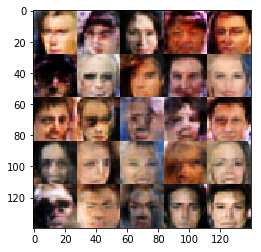

Epoch 1/1 4050... Discriminator Loss: 1.6579... Generator Loss: 0.3820


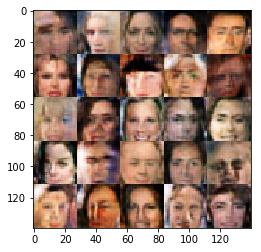

Epoch 1/1 4060... Discriminator Loss: 0.9041... Generator Loss: 1.3259


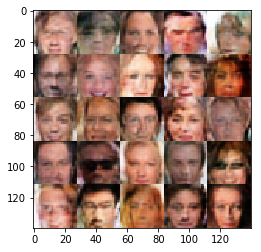

Epoch 1/1 4070... Discriminator Loss: 0.9097... Generator Loss: 1.2898


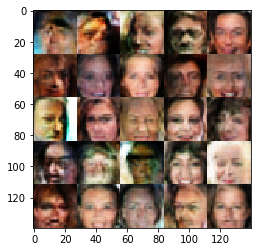

Epoch 1/1 4080... Discriminator Loss: 1.1185... Generator Loss: 0.8009


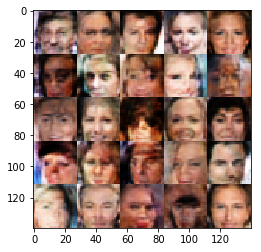

Epoch 1/1 4090... Discriminator Loss: 1.3118... Generator Loss: 1.0533


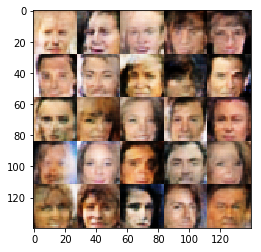

Epoch 1/1 4100... Discriminator Loss: 1.7692... Generator Loss: 0.5032


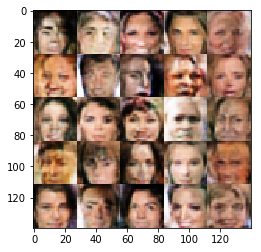

Epoch 1/1 4110... Discriminator Loss: 1.4969... Generator Loss: 0.5775


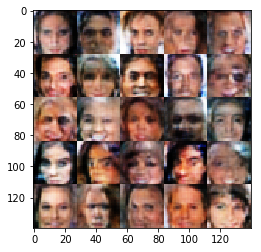

Epoch 1/1 4120... Discriminator Loss: 0.7864... Generator Loss: 1.9270


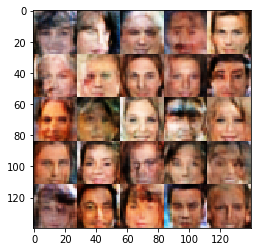

Epoch 1/1 4130... Discriminator Loss: 0.7613... Generator Loss: 1.7827


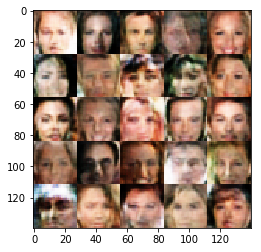

Epoch 1/1... Discriminator Loss: 0.9720... Generator Loss: 1.0641


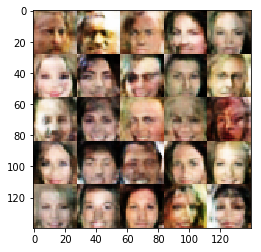

In [78]:
batch_size = 49
z_dim = 100
learning_rate = 0.002
beta1 = 0.5


epochs = 1

celeba_dataset = helper.Dataset('celeba', glob(os.path.join(data_dir, 'img_align_celeba/*.jpg')))
# with tf.Graph().as_default():
train(
    epochs, 
    batch_size, 
    z_dim, 
    learning_rate, 
    beta1, 
    celeba_dataset.get_batches,
    celeba_dataset.shape, 
    celeba_dataset.image_mode
)